# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

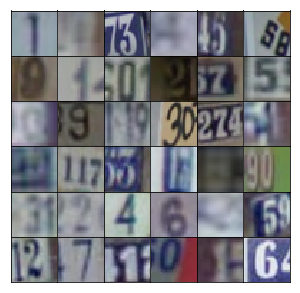

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        
        #reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha *x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256
        
        # flatten
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat,1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.2925... Generator Loss: 0.8091
Epoch 1/25... Discriminator Loss: 0.4756... Generator Loss: 1.4309
Epoch 1/25... Discriminator Loss: 0.1426... Generator Loss: 2.5522
Epoch 1/25... Discriminator Loss: 0.1258... Generator Loss: 2.8602
Epoch 1/25... Discriminator Loss: 0.1245... Generator Loss: 2.9936
Epoch 1/25... Discriminator Loss: 0.1295... Generator Loss: 2.5857
Epoch 1/25... Discriminator Loss: 0.1161... Generator Loss: 2.7786
Epoch 1/25... Discriminator Loss: 0.2338... Generator Loss: 5.5183
Epoch 1/25... Discriminator Loss: 0.4837... Generator Loss: 1.6080
Epoch 1/25... Discriminator Loss: 0.6798... Generator Loss: 2.1998


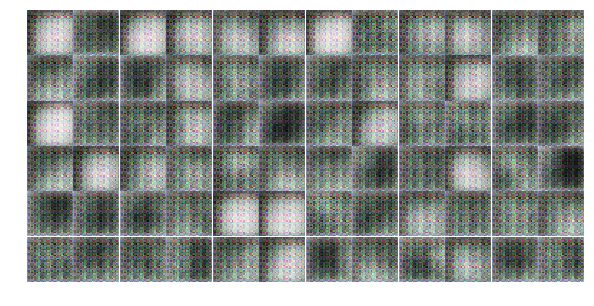

Epoch 1/25... Discriminator Loss: 0.5211... Generator Loss: 1.4096
Epoch 1/25... Discriminator Loss: 0.3267... Generator Loss: 1.8814
Epoch 1/25... Discriminator Loss: 0.4328... Generator Loss: 1.3673
Epoch 1/25... Discriminator Loss: 0.2584... Generator Loss: 3.3689
Epoch 1/25... Discriminator Loss: 0.8094... Generator Loss: 4.5408
Epoch 1/25... Discriminator Loss: 0.8260... Generator Loss: 0.9281
Epoch 1/25... Discriminator Loss: 0.1274... Generator Loss: 3.8786
Epoch 1/25... Discriminator Loss: 0.3347... Generator Loss: 1.6310
Epoch 1/25... Discriminator Loss: 1.9584... Generator Loss: 0.8635
Epoch 1/25... Discriminator Loss: 0.1235... Generator Loss: 3.4874


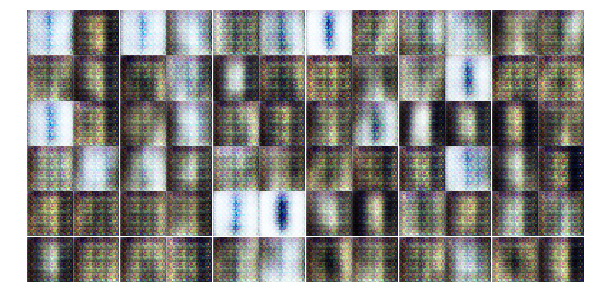

Epoch 1/25... Discriminator Loss: 0.2253... Generator Loss: 2.5960
Epoch 1/25... Discriminator Loss: 0.6862... Generator Loss: 4.1789
Epoch 1/25... Discriminator Loss: 0.2563... Generator Loss: 3.5812
Epoch 1/25... Discriminator Loss: 1.2925... Generator Loss: 0.6923
Epoch 1/25... Discriminator Loss: 0.6791... Generator Loss: 1.4641
Epoch 1/25... Discriminator Loss: 0.5231... Generator Loss: 2.8752
Epoch 1/25... Discriminator Loss: 0.9334... Generator Loss: 1.2032
Epoch 1/25... Discriminator Loss: 0.9658... Generator Loss: 1.0029
Epoch 1/25... Discriminator Loss: 0.5047... Generator Loss: 2.6449
Epoch 1/25... Discriminator Loss: 0.6841... Generator Loss: 1.5237


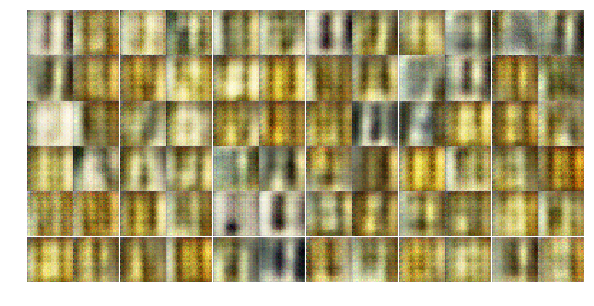

Epoch 1/25... Discriminator Loss: 0.3358... Generator Loss: 2.1464
Epoch 1/25... Discriminator Loss: 0.3730... Generator Loss: 1.7036
Epoch 1/25... Discriminator Loss: 0.2930... Generator Loss: 1.8815
Epoch 1/25... Discriminator Loss: 0.3561... Generator Loss: 2.8244
Epoch 1/25... Discriminator Loss: 0.3059... Generator Loss: 2.7593
Epoch 1/25... Discriminator Loss: 0.1750... Generator Loss: 2.6573
Epoch 1/25... Discriminator Loss: 0.4281... Generator Loss: 1.6951
Epoch 1/25... Discriminator Loss: 0.3782... Generator Loss: 4.3650
Epoch 1/25... Discriminator Loss: 0.2589... Generator Loss: 2.0647
Epoch 1/25... Discriminator Loss: 0.6437... Generator Loss: 2.9397


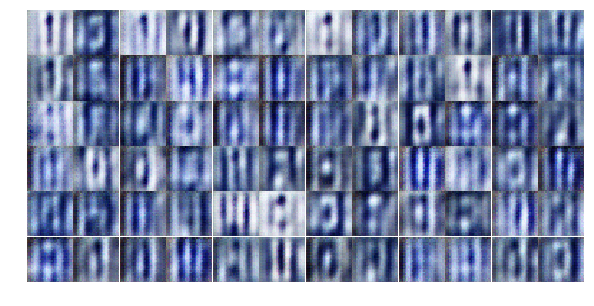

Epoch 1/25... Discriminator Loss: 0.5365... Generator Loss: 2.1842
Epoch 1/25... Discriminator Loss: 0.7062... Generator Loss: 1.2372
Epoch 1/25... Discriminator Loss: 0.4800... Generator Loss: 1.4226
Epoch 1/25... Discriminator Loss: 0.2903... Generator Loss: 2.5634
Epoch 1/25... Discriminator Loss: 0.7760... Generator Loss: 0.9659
Epoch 1/25... Discriminator Loss: 0.7775... Generator Loss: 1.5299
Epoch 1/25... Discriminator Loss: 0.7195... Generator Loss: 1.1960
Epoch 1/25... Discriminator Loss: 0.9335... Generator Loss: 1.0806
Epoch 1/25... Discriminator Loss: 0.7423... Generator Loss: 1.0605
Epoch 1/25... Discriminator Loss: 1.1074... Generator Loss: 1.1251


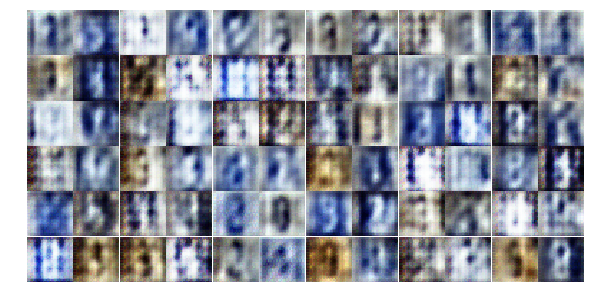

Epoch 1/25... Discriminator Loss: 0.7518... Generator Loss: 1.0710
Epoch 1/25... Discriminator Loss: 0.6562... Generator Loss: 1.3630
Epoch 1/25... Discriminator Loss: 0.5757... Generator Loss: 1.6137
Epoch 1/25... Discriminator Loss: 0.6180... Generator Loss: 1.2401
Epoch 1/25... Discriminator Loss: 0.6522... Generator Loss: 1.6458
Epoch 1/25... Discriminator Loss: 0.7508... Generator Loss: 1.2060
Epoch 1/25... Discriminator Loss: 0.5559... Generator Loss: 1.6013
Epoch 2/25... Discriminator Loss: 0.5971... Generator Loss: 1.7995
Epoch 2/25... Discriminator Loss: 0.6830... Generator Loss: 1.5133
Epoch 2/25... Discriminator Loss: 0.7746... Generator Loss: 1.0915


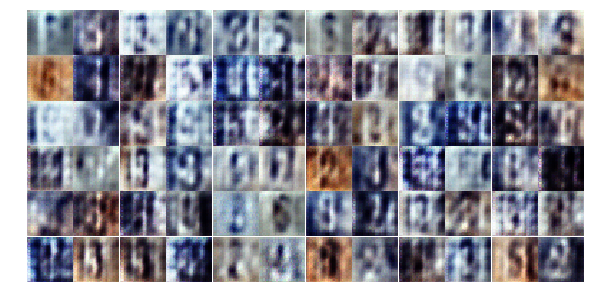

Epoch 2/25... Discriminator Loss: 0.9167... Generator Loss: 0.9972
Epoch 2/25... Discriminator Loss: 1.1845... Generator Loss: 0.5762
Epoch 2/25... Discriminator Loss: 0.9860... Generator Loss: 1.3397
Epoch 2/25... Discriminator Loss: 0.7707... Generator Loss: 1.5678
Epoch 2/25... Discriminator Loss: 0.9208... Generator Loss: 1.0636
Epoch 2/25... Discriminator Loss: 0.7922... Generator Loss: 1.8804
Epoch 2/25... Discriminator Loss: 1.1931... Generator Loss: 0.7715
Epoch 2/25... Discriminator Loss: 0.9628... Generator Loss: 1.4030
Epoch 2/25... Discriminator Loss: 1.5231... Generator Loss: 0.5484
Epoch 2/25... Discriminator Loss: 1.1128... Generator Loss: 1.1162


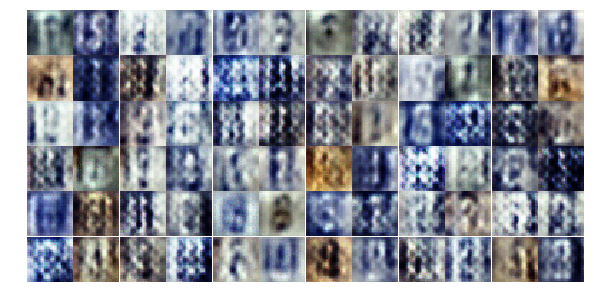

Epoch 2/25... Discriminator Loss: 0.7603... Generator Loss: 1.2188
Epoch 2/25... Discriminator Loss: 1.0484... Generator Loss: 1.7614
Epoch 2/25... Discriminator Loss: 0.9253... Generator Loss: 1.2381
Epoch 2/25... Discriminator Loss: 0.9402... Generator Loss: 1.2764
Epoch 2/25... Discriminator Loss: 0.9872... Generator Loss: 1.1982
Epoch 2/25... Discriminator Loss: 1.0905... Generator Loss: 0.8865
Epoch 2/25... Discriminator Loss: 1.4062... Generator Loss: 0.9881
Epoch 2/25... Discriminator Loss: 1.0894... Generator Loss: 0.9445
Epoch 2/25... Discriminator Loss: 1.2180... Generator Loss: 0.6807
Epoch 2/25... Discriminator Loss: 1.0493... Generator Loss: 0.9458


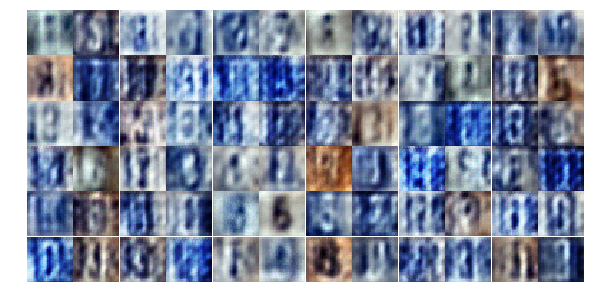

Epoch 2/25... Discriminator Loss: 1.0293... Generator Loss: 1.0335
Epoch 2/25... Discriminator Loss: 1.1032... Generator Loss: 1.1070
Epoch 2/25... Discriminator Loss: 0.9608... Generator Loss: 1.1156
Epoch 2/25... Discriminator Loss: 0.9786... Generator Loss: 1.0312
Epoch 2/25... Discriminator Loss: 0.8437... Generator Loss: 1.2608
Epoch 2/25... Discriminator Loss: 0.7740... Generator Loss: 1.2988
Epoch 2/25... Discriminator Loss: 0.9683... Generator Loss: 1.1254
Epoch 2/25... Discriminator Loss: 1.1082... Generator Loss: 0.6987
Epoch 2/25... Discriminator Loss: 0.9384... Generator Loss: 0.9731
Epoch 2/25... Discriminator Loss: 0.8883... Generator Loss: 1.2937


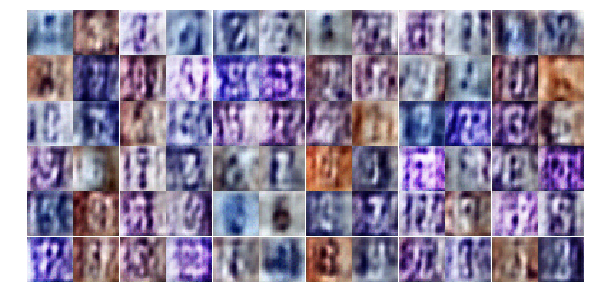

Epoch 2/25... Discriminator Loss: 1.1840... Generator Loss: 0.9366
Epoch 2/25... Discriminator Loss: 1.1085... Generator Loss: 0.9513
Epoch 2/25... Discriminator Loss: 1.1082... Generator Loss: 0.7712
Epoch 2/25... Discriminator Loss: 1.1357... Generator Loss: 0.6901
Epoch 2/25... Discriminator Loss: 0.8682... Generator Loss: 1.2581
Epoch 2/25... Discriminator Loss: 0.9462... Generator Loss: 0.9611
Epoch 2/25... Discriminator Loss: 0.8652... Generator Loss: 1.2718
Epoch 2/25... Discriminator Loss: 0.9582... Generator Loss: 1.6038
Epoch 2/25... Discriminator Loss: 1.0325... Generator Loss: 0.9370
Epoch 2/25... Discriminator Loss: 0.9995... Generator Loss: 1.0897


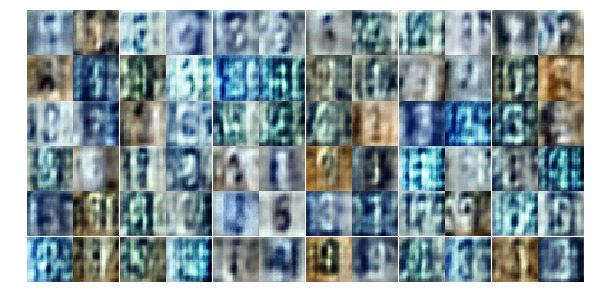

Epoch 2/25... Discriminator Loss: 1.0530... Generator Loss: 0.9387
Epoch 2/25... Discriminator Loss: 1.0120... Generator Loss: 0.8704
Epoch 2/25... Discriminator Loss: 0.8777... Generator Loss: 0.8044
Epoch 2/25... Discriminator Loss: 0.9913... Generator Loss: 1.0264
Epoch 2/25... Discriminator Loss: 0.9660... Generator Loss: 1.0986
Epoch 2/25... Discriminator Loss: 1.2000... Generator Loss: 0.7917
Epoch 2/25... Discriminator Loss: 0.9908... Generator Loss: 1.5263
Epoch 2/25... Discriminator Loss: 0.9494... Generator Loss: 1.0860
Epoch 2/25... Discriminator Loss: 0.7252... Generator Loss: 1.7681
Epoch 2/25... Discriminator Loss: 0.9614... Generator Loss: 1.1227


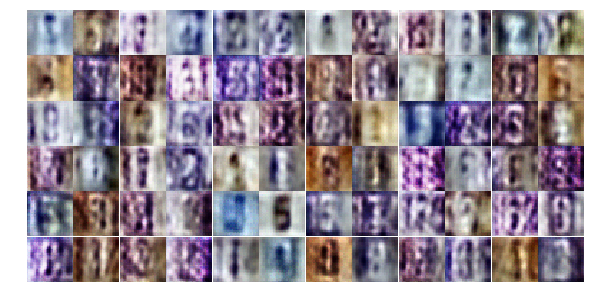

Epoch 2/25... Discriminator Loss: 0.7590... Generator Loss: 1.1328
Epoch 2/25... Discriminator Loss: 0.7079... Generator Loss: 1.3125
Epoch 2/25... Discriminator Loss: 1.0354... Generator Loss: 1.2082
Epoch 2/25... Discriminator Loss: 0.8590... Generator Loss: 1.1921
Epoch 3/25... Discriminator Loss: 1.0805... Generator Loss: 1.9576
Epoch 3/25... Discriminator Loss: 1.0232... Generator Loss: 1.6218
Epoch 3/25... Discriminator Loss: 0.9533... Generator Loss: 1.2432
Epoch 3/25... Discriminator Loss: 0.6992... Generator Loss: 1.6417
Epoch 3/25... Discriminator Loss: 1.1067... Generator Loss: 0.7454
Epoch 3/25... Discriminator Loss: 1.5117... Generator Loss: 0.4195


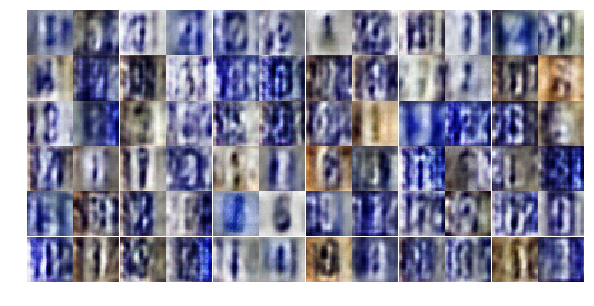

Epoch 3/25... Discriminator Loss: 0.6474... Generator Loss: 1.2280
Epoch 3/25... Discriminator Loss: 0.7239... Generator Loss: 1.9562
Epoch 3/25... Discriminator Loss: 0.8347... Generator Loss: 1.7097
Epoch 3/25... Discriminator Loss: 0.7560... Generator Loss: 1.2361
Epoch 3/25... Discriminator Loss: 0.7145... Generator Loss: 1.6400
Epoch 3/25... Discriminator Loss: 0.6326... Generator Loss: 1.4011
Epoch 3/25... Discriminator Loss: 0.7568... Generator Loss: 1.5851
Epoch 3/25... Discriminator Loss: 0.8122... Generator Loss: 1.0995
Epoch 3/25... Discriminator Loss: 0.7582... Generator Loss: 0.9172
Epoch 3/25... Discriminator Loss: 0.5667... Generator Loss: 1.3819


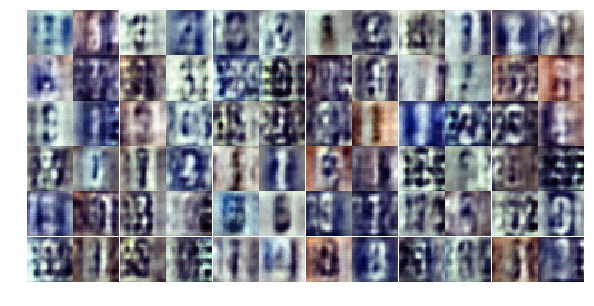

Epoch 3/25... Discriminator Loss: 0.4754... Generator Loss: 2.0255
Epoch 3/25... Discriminator Loss: 0.6108... Generator Loss: 1.3790
Epoch 3/25... Discriminator Loss: 0.8565... Generator Loss: 1.3894
Epoch 3/25... Discriminator Loss: 0.6296... Generator Loss: 1.2509
Epoch 3/25... Discriminator Loss: 0.3998... Generator Loss: 2.0466
Epoch 3/25... Discriminator Loss: 0.7114... Generator Loss: 2.4671
Epoch 3/25... Discriminator Loss: 0.7311... Generator Loss: 0.9503
Epoch 3/25... Discriminator Loss: 0.3793... Generator Loss: 1.7239
Epoch 3/25... Discriminator Loss: 0.4878... Generator Loss: 1.4326
Epoch 3/25... Discriminator Loss: 1.0892... Generator Loss: 2.2415


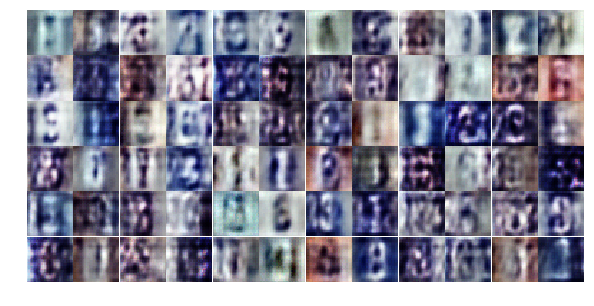

Epoch 3/25... Discriminator Loss: 0.5432... Generator Loss: 1.4284
Epoch 3/25... Discriminator Loss: 0.3941... Generator Loss: 2.2019
Epoch 3/25... Discriminator Loss: 0.4894... Generator Loss: 1.5198
Epoch 3/25... Discriminator Loss: 0.6459... Generator Loss: 1.6042
Epoch 3/25... Discriminator Loss: 1.9719... Generator Loss: 3.2848
Epoch 3/25... Discriminator Loss: 0.9613... Generator Loss: 1.5078
Epoch 3/25... Discriminator Loss: 0.6905... Generator Loss: 1.2842
Epoch 3/25... Discriminator Loss: 0.7925... Generator Loss: 1.1789
Epoch 3/25... Discriminator Loss: 1.0252... Generator Loss: 2.7895
Epoch 3/25... Discriminator Loss: 0.3751... Generator Loss: 1.8734


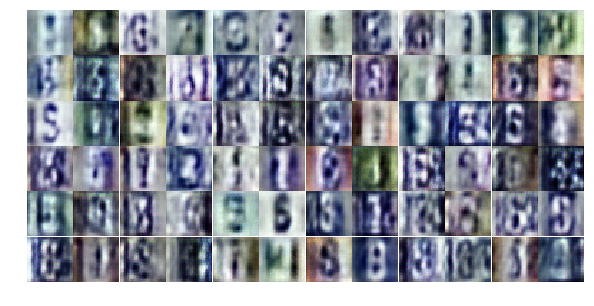

Epoch 3/25... Discriminator Loss: 0.6164... Generator Loss: 2.1068
Epoch 3/25... Discriminator Loss: 0.3783... Generator Loss: 2.3772
Epoch 3/25... Discriminator Loss: 0.6378... Generator Loss: 1.4401
Epoch 3/25... Discriminator Loss: 0.3807... Generator Loss: 2.1095
Epoch 3/25... Discriminator Loss: 0.3733... Generator Loss: 1.7881
Epoch 3/25... Discriminator Loss: 1.0395... Generator Loss: 3.2387
Epoch 3/25... Discriminator Loss: 0.7632... Generator Loss: 1.1463
Epoch 3/25... Discriminator Loss: 0.4577... Generator Loss: 1.9698
Epoch 3/25... Discriminator Loss: 0.3958... Generator Loss: 1.8320
Epoch 3/25... Discriminator Loss: 0.6182... Generator Loss: 1.9458


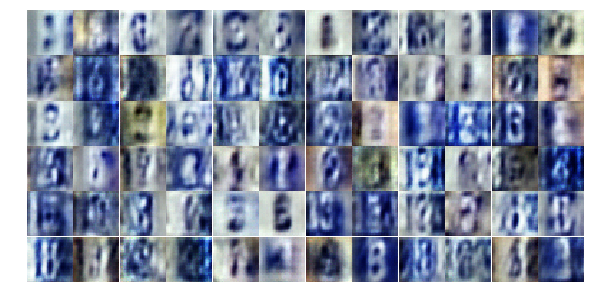

Epoch 3/25... Discriminator Loss: 0.6942... Generator Loss: 1.1604
Epoch 3/25... Discriminator Loss: 0.4875... Generator Loss: 1.5555
Epoch 3/25... Discriminator Loss: 0.4322... Generator Loss: 1.7778
Epoch 3/25... Discriminator Loss: 0.4419... Generator Loss: 1.9030
Epoch 3/25... Discriminator Loss: 0.4557... Generator Loss: 2.9354
Epoch 3/25... Discriminator Loss: 0.4712... Generator Loss: 1.8201
Epoch 3/25... Discriminator Loss: 0.4059... Generator Loss: 2.8103
Epoch 3/25... Discriminator Loss: 0.3883... Generator Loss: 2.1556
Epoch 3/25... Discriminator Loss: 0.5170... Generator Loss: 1.5414
Epoch 3/25... Discriminator Loss: 0.3652... Generator Loss: 2.0944


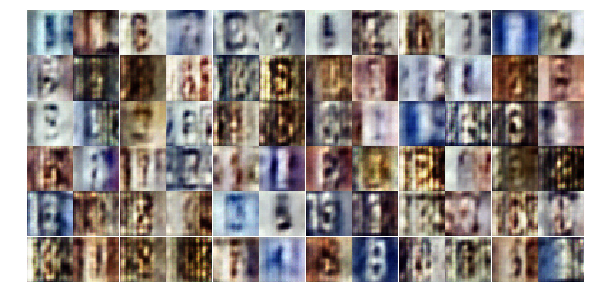

Epoch 3/25... Discriminator Loss: 0.9237... Generator Loss: 0.7846
Epoch 4/25... Discriminator Loss: 0.5191... Generator Loss: 1.2528
Epoch 4/25... Discriminator Loss: 0.7579... Generator Loss: 1.0488
Epoch 4/25... Discriminator Loss: 0.8150... Generator Loss: 0.8575
Epoch 4/25... Discriminator Loss: 0.3730... Generator Loss: 1.8957
Epoch 4/25... Discriminator Loss: 0.3538... Generator Loss: 1.8379
Epoch 4/25... Discriminator Loss: 0.2789... Generator Loss: 2.9617
Epoch 4/25... Discriminator Loss: 0.5023... Generator Loss: 1.6755
Epoch 4/25... Discriminator Loss: 0.5858... Generator Loss: 1.0961
Epoch 4/25... Discriminator Loss: 1.1305... Generator Loss: 0.6772


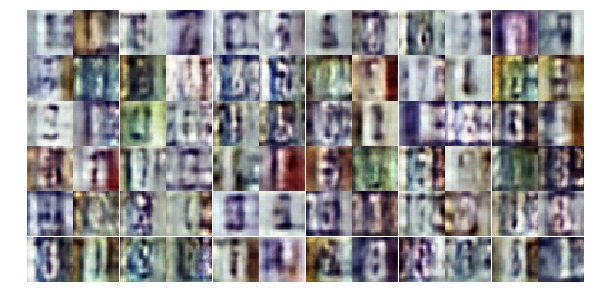

Epoch 4/25... Discriminator Loss: 0.4305... Generator Loss: 2.7410
Epoch 4/25... Discriminator Loss: 0.3809... Generator Loss: 2.4560
Epoch 4/25... Discriminator Loss: 0.9757... Generator Loss: 2.2200
Epoch 4/25... Discriminator Loss: 0.7060... Generator Loss: 1.1711
Epoch 4/25... Discriminator Loss: 0.7377... Generator Loss: 1.7216
Epoch 4/25... Discriminator Loss: 1.0902... Generator Loss: 0.7815
Epoch 4/25... Discriminator Loss: 1.0175... Generator Loss: 0.8185
Epoch 4/25... Discriminator Loss: 0.3943... Generator Loss: 1.7896
Epoch 4/25... Discriminator Loss: 0.7180... Generator Loss: 1.5598
Epoch 4/25... Discriminator Loss: 0.5621... Generator Loss: 1.6055


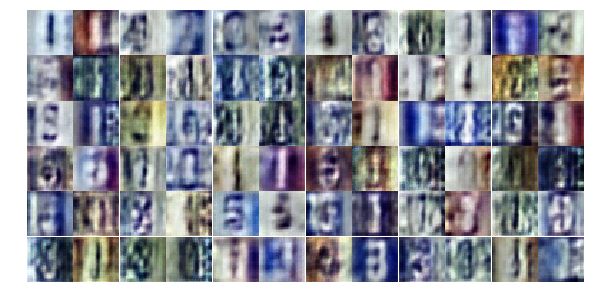

Epoch 4/25... Discriminator Loss: 0.4755... Generator Loss: 1.8654
Epoch 4/25... Discriminator Loss: 0.6735... Generator Loss: 1.0841
Epoch 4/25... Discriminator Loss: 0.5662... Generator Loss: 1.1919
Epoch 4/25... Discriminator Loss: 0.4758... Generator Loss: 2.1774
Epoch 4/25... Discriminator Loss: 0.5247... Generator Loss: 1.5547
Epoch 4/25... Discriminator Loss: 0.4609... Generator Loss: 2.5474
Epoch 4/25... Discriminator Loss: 1.0355... Generator Loss: 0.6748
Epoch 4/25... Discriminator Loss: 0.5664... Generator Loss: 1.7683
Epoch 4/25... Discriminator Loss: 0.5480... Generator Loss: 1.6490
Epoch 4/25... Discriminator Loss: 0.5836... Generator Loss: 1.2763


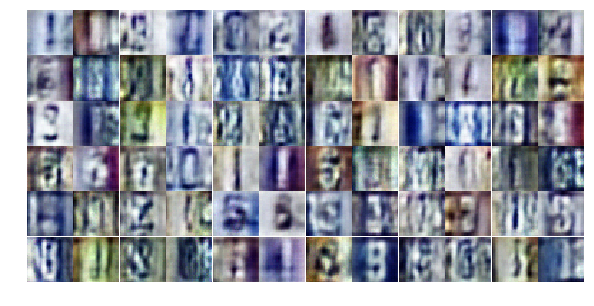

Epoch 4/25... Discriminator Loss: 0.4796... Generator Loss: 1.5330
Epoch 4/25... Discriminator Loss: 0.6057... Generator Loss: 1.2917
Epoch 4/25... Discriminator Loss: 0.5259... Generator Loss: 1.3907
Epoch 4/25... Discriminator Loss: 0.4572... Generator Loss: 1.5731
Epoch 4/25... Discriminator Loss: 0.2771... Generator Loss: 2.3758
Epoch 4/25... Discriminator Loss: 0.9062... Generator Loss: 3.4425
Epoch 4/25... Discriminator Loss: 1.2781... Generator Loss: 2.5942
Epoch 4/25... Discriminator Loss: 0.5622... Generator Loss: 1.4487
Epoch 4/25... Discriminator Loss: 0.7367... Generator Loss: 1.1532
Epoch 4/25... Discriminator Loss: 0.5784... Generator Loss: 1.4654


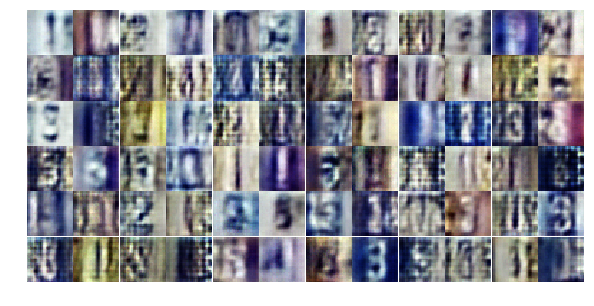

Epoch 4/25... Discriminator Loss: 0.7977... Generator Loss: 1.1558
Epoch 4/25... Discriminator Loss: 0.6174... Generator Loss: 1.1699
Epoch 4/25... Discriminator Loss: 0.9234... Generator Loss: 0.7797
Epoch 4/25... Discriminator Loss: 0.5205... Generator Loss: 1.6691
Epoch 4/25... Discriminator Loss: 0.3837... Generator Loss: 2.0168
Epoch 4/25... Discriminator Loss: 0.8515... Generator Loss: 1.9931
Epoch 4/25... Discriminator Loss: 0.7274... Generator Loss: 1.0451
Epoch 4/25... Discriminator Loss: 0.6374... Generator Loss: 1.3193
Epoch 4/25... Discriminator Loss: 0.8349... Generator Loss: 0.7559
Epoch 4/25... Discriminator Loss: 0.6341... Generator Loss: 1.4678


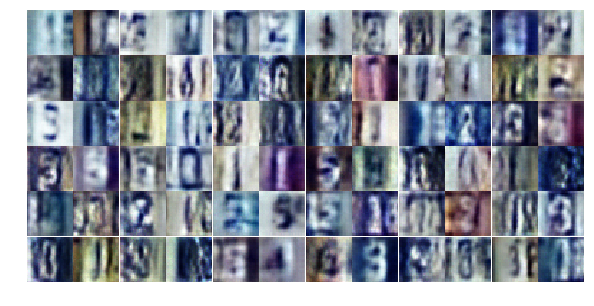

Epoch 4/25... Discriminator Loss: 0.5730... Generator Loss: 1.1970
Epoch 4/25... Discriminator Loss: 0.4400... Generator Loss: 1.6920
Epoch 4/25... Discriminator Loss: 0.5500... Generator Loss: 1.2828
Epoch 4/25... Discriminator Loss: 0.5320... Generator Loss: 2.2141
Epoch 4/25... Discriminator Loss: 0.7553... Generator Loss: 0.9570
Epoch 4/25... Discriminator Loss: 0.6796... Generator Loss: 1.0798
Epoch 4/25... Discriminator Loss: 0.4783... Generator Loss: 1.3538
Epoch 4/25... Discriminator Loss: 0.5598... Generator Loss: 1.5839
Epoch 4/25... Discriminator Loss: 0.5503... Generator Loss: 1.5937
Epoch 5/25... Discriminator Loss: 0.5097... Generator Loss: 1.2986


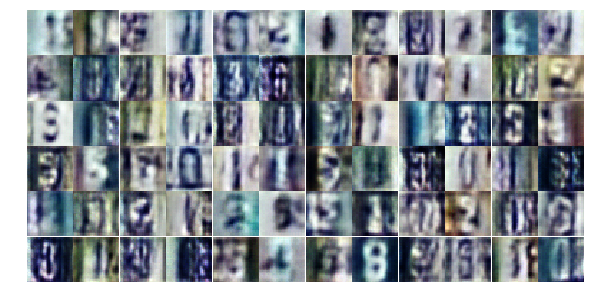

Epoch 5/25... Discriminator Loss: 0.3395... Generator Loss: 2.1355
Epoch 5/25... Discriminator Loss: 0.4269... Generator Loss: 2.0919
Epoch 5/25... Discriminator Loss: 0.5924... Generator Loss: 1.7870
Epoch 5/25... Discriminator Loss: 0.6452... Generator Loss: 1.0205
Epoch 5/25... Discriminator Loss: 0.3490... Generator Loss: 1.7967
Epoch 5/25... Discriminator Loss: 0.8720... Generator Loss: 0.7341
Epoch 5/25... Discriminator Loss: 4.0113... Generator Loss: 0.0339
Epoch 5/25... Discriminator Loss: 1.0248... Generator Loss: 1.5257
Epoch 5/25... Discriminator Loss: 0.6305... Generator Loss: 1.1192
Epoch 5/25... Discriminator Loss: 0.6899... Generator Loss: 1.0286


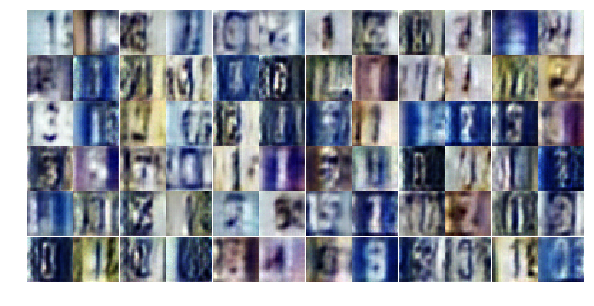

Epoch 5/25... Discriminator Loss: 0.5073... Generator Loss: 1.4288
Epoch 5/25... Discriminator Loss: 0.4884... Generator Loss: 1.4946
Epoch 5/25... Discriminator Loss: 0.4567... Generator Loss: 1.6923
Epoch 5/25... Discriminator Loss: 0.9024... Generator Loss: 0.7000
Epoch 5/25... Discriminator Loss: 0.5465... Generator Loss: 2.1396
Epoch 5/25... Discriminator Loss: 1.1893... Generator Loss: 3.3602
Epoch 5/25... Discriminator Loss: 0.4389... Generator Loss: 1.9036
Epoch 5/25... Discriminator Loss: 0.5302... Generator Loss: 1.3954
Epoch 5/25... Discriminator Loss: 0.4766... Generator Loss: 1.7937
Epoch 5/25... Discriminator Loss: 0.4859... Generator Loss: 1.4950


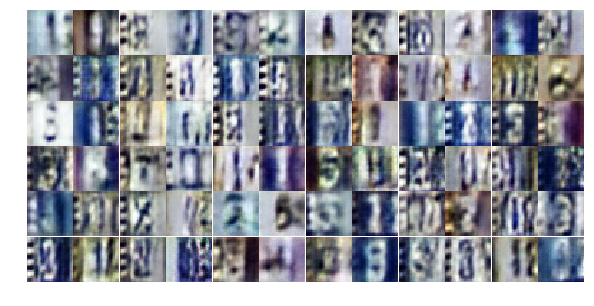

Epoch 5/25... Discriminator Loss: 0.4595... Generator Loss: 1.4292
Epoch 5/25... Discriminator Loss: 0.4768... Generator Loss: 1.6691
Epoch 5/25... Discriminator Loss: 0.5907... Generator Loss: 1.0912
Epoch 5/25... Discriminator Loss: 0.5908... Generator Loss: 1.1193
Epoch 5/25... Discriminator Loss: 0.7913... Generator Loss: 0.7931
Epoch 5/25... Discriminator Loss: 0.2913... Generator Loss: 1.8916
Epoch 5/25... Discriminator Loss: 0.4801... Generator Loss: 1.5465
Epoch 5/25... Discriminator Loss: 2.4441... Generator Loss: 0.1469
Epoch 5/25... Discriminator Loss: 0.8611... Generator Loss: 0.8179
Epoch 5/25... Discriminator Loss: 0.3657... Generator Loss: 2.0496


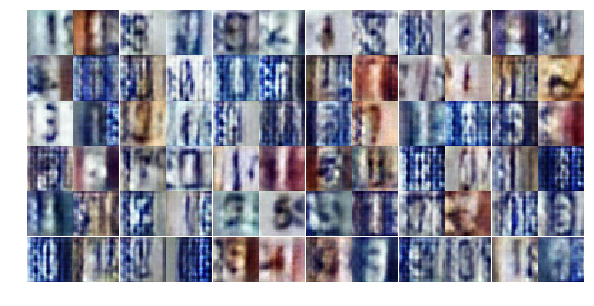

Epoch 5/25... Discriminator Loss: 0.5055... Generator Loss: 1.4298
Epoch 5/25... Discriminator Loss: 0.6856... Generator Loss: 0.9848
Epoch 5/25... Discriminator Loss: 0.4538... Generator Loss: 1.4881
Epoch 5/25... Discriminator Loss: 0.4500... Generator Loss: 1.5250
Epoch 5/25... Discriminator Loss: 0.4229... Generator Loss: 2.1265
Epoch 5/25... Discriminator Loss: 0.7208... Generator Loss: 1.9289
Epoch 5/25... Discriminator Loss: 0.8476... Generator Loss: 0.8023
Epoch 5/25... Discriminator Loss: 0.9960... Generator Loss: 0.6486
Epoch 5/25... Discriminator Loss: 0.9743... Generator Loss: 0.6577
Epoch 5/25... Discriminator Loss: 0.4807... Generator Loss: 1.6825


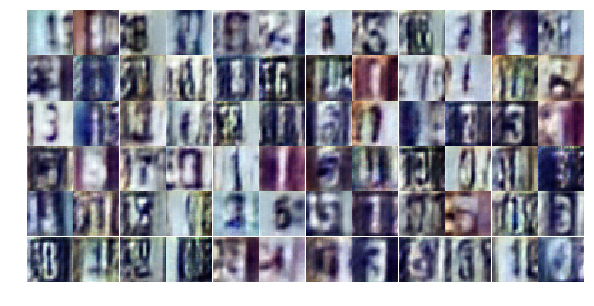

Epoch 5/25... Discriminator Loss: 0.3304... Generator Loss: 2.1476
Epoch 5/25... Discriminator Loss: 0.7268... Generator Loss: 0.8891
Epoch 5/25... Discriminator Loss: 1.3404... Generator Loss: 0.4491
Epoch 5/25... Discriminator Loss: 0.4500... Generator Loss: 2.2865
Epoch 5/25... Discriminator Loss: 2.9056... Generator Loss: 4.9099
Epoch 5/25... Discriminator Loss: 0.9882... Generator Loss: 0.6746
Epoch 5/25... Discriminator Loss: 0.6456... Generator Loss: 1.2150
Epoch 5/25... Discriminator Loss: 0.7023... Generator Loss: 1.1822
Epoch 5/25... Discriminator Loss: 0.7378... Generator Loss: 0.9852
Epoch 5/25... Discriminator Loss: 0.6500... Generator Loss: 0.9898


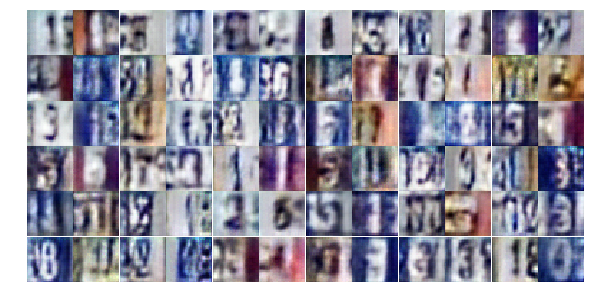

Epoch 5/25... Discriminator Loss: 0.9691... Generator Loss: 0.6194
Epoch 5/25... Discriminator Loss: 0.5364... Generator Loss: 1.2788
Epoch 5/25... Discriminator Loss: 0.6290... Generator Loss: 1.2350
Epoch 5/25... Discriminator Loss: 0.5506... Generator Loss: 1.3015
Epoch 5/25... Discriminator Loss: 0.6240... Generator Loss: 1.1237
Epoch 5/25... Discriminator Loss: 0.7157... Generator Loss: 1.1549
Epoch 6/25... Discriminator Loss: 0.6318... Generator Loss: 1.0305
Epoch 6/25... Discriminator Loss: 0.4455... Generator Loss: 1.4933
Epoch 6/25... Discriminator Loss: 0.5877... Generator Loss: 1.9913
Epoch 6/25... Discriminator Loss: 0.5608... Generator Loss: 1.2754


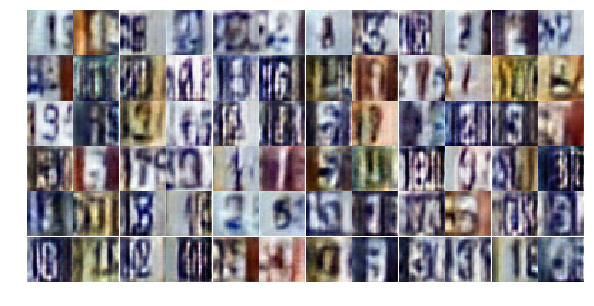

Epoch 6/25... Discriminator Loss: 0.7009... Generator Loss: 0.9627
Epoch 6/25... Discriminator Loss: 0.6599... Generator Loss: 1.0549
Epoch 6/25... Discriminator Loss: 0.7342... Generator Loss: 1.7650
Epoch 6/25... Discriminator Loss: 0.5472... Generator Loss: 1.6290
Epoch 6/25... Discriminator Loss: 1.3592... Generator Loss: 0.3966
Epoch 6/25... Discriminator Loss: 0.7101... Generator Loss: 1.7136
Epoch 6/25... Discriminator Loss: 0.5382... Generator Loss: 1.3091
Epoch 6/25... Discriminator Loss: 0.8843... Generator Loss: 0.7602
Epoch 6/25... Discriminator Loss: 0.4890... Generator Loss: 1.5685
Epoch 6/25... Discriminator Loss: 0.6006... Generator Loss: 1.7738


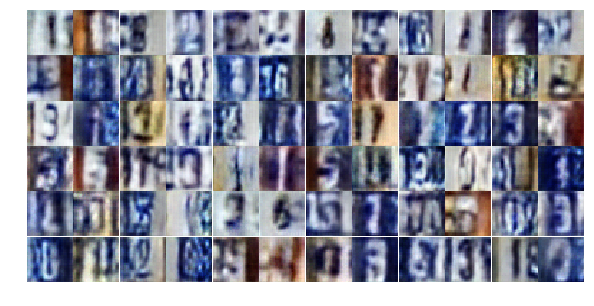

Epoch 6/25... Discriminator Loss: 1.8339... Generator Loss: 0.2885
Epoch 6/25... Discriminator Loss: 1.1528... Generator Loss: 1.7773
Epoch 6/25... Discriminator Loss: 1.2552... Generator Loss: 0.5402
Epoch 6/25... Discriminator Loss: 0.6707... Generator Loss: 0.9508
Epoch 6/25... Discriminator Loss: 0.6456... Generator Loss: 1.8087
Epoch 6/25... Discriminator Loss: 0.4274... Generator Loss: 1.5625
Epoch 6/25... Discriminator Loss: 0.5111... Generator Loss: 1.3900
Epoch 6/25... Discriminator Loss: 0.5678... Generator Loss: 1.2109
Epoch 6/25... Discriminator Loss: 0.5096... Generator Loss: 1.5476
Epoch 6/25... Discriminator Loss: 0.7718... Generator Loss: 0.8835


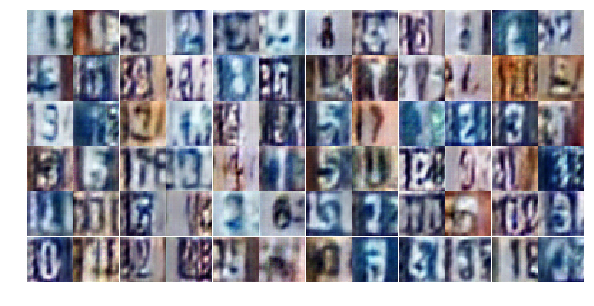

Epoch 6/25... Discriminator Loss: 0.8460... Generator Loss: 0.7483
Epoch 6/25... Discriminator Loss: 0.6307... Generator Loss: 1.0509
Epoch 6/25... Discriminator Loss: 0.6864... Generator Loss: 1.0142
Epoch 6/25... Discriminator Loss: 0.9738... Generator Loss: 0.6067
Epoch 6/25... Discriminator Loss: 0.8372... Generator Loss: 3.6374
Epoch 6/25... Discriminator Loss: 1.3718... Generator Loss: 0.4028
Epoch 6/25... Discriminator Loss: 0.5397... Generator Loss: 1.7350
Epoch 6/25... Discriminator Loss: 0.3922... Generator Loss: 1.4377
Epoch 6/25... Discriminator Loss: 0.5031... Generator Loss: 1.9622
Epoch 6/25... Discriminator Loss: 0.4126... Generator Loss: 1.6062


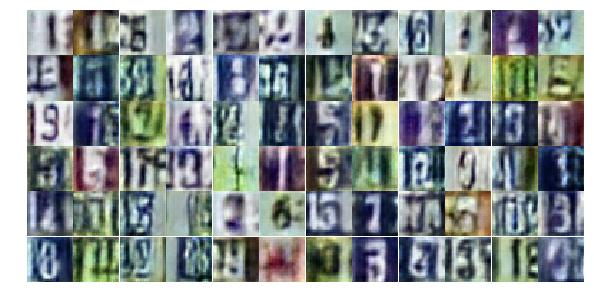

Epoch 6/25... Discriminator Loss: 0.5256... Generator Loss: 1.4408
Epoch 6/25... Discriminator Loss: 2.0995... Generator Loss: 4.2887
Epoch 6/25... Discriminator Loss: 0.7132... Generator Loss: 1.1828
Epoch 6/25... Discriminator Loss: 1.1021... Generator Loss: 0.5265
Epoch 6/25... Discriminator Loss: 1.1750... Generator Loss: 0.5279
Epoch 6/25... Discriminator Loss: 0.9111... Generator Loss: 0.8549
Epoch 6/25... Discriminator Loss: 0.6252... Generator Loss: 1.6026
Epoch 6/25... Discriminator Loss: 0.5174... Generator Loss: 1.9675
Epoch 6/25... Discriminator Loss: 0.5082... Generator Loss: 1.8487
Epoch 6/25... Discriminator Loss: 0.5914... Generator Loss: 1.2601


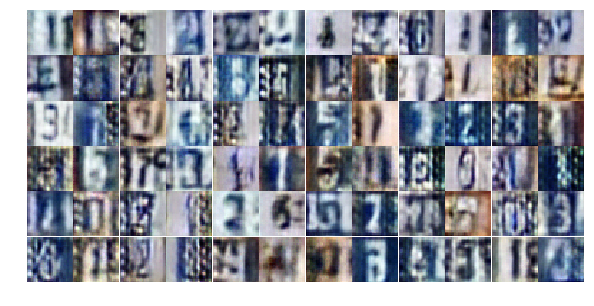

Epoch 6/25... Discriminator Loss: 0.6926... Generator Loss: 0.9972
Epoch 6/25... Discriminator Loss: 0.6608... Generator Loss: 1.2756
Epoch 6/25... Discriminator Loss: 0.6061... Generator Loss: 1.5806
Epoch 6/25... Discriminator Loss: 0.5911... Generator Loss: 2.4910
Epoch 6/25... Discriminator Loss: 0.5226... Generator Loss: 1.2993
Epoch 6/25... Discriminator Loss: 0.4448... Generator Loss: 1.3903
Epoch 6/25... Discriminator Loss: 0.9521... Generator Loss: 0.6976
Epoch 6/25... Discriminator Loss: 0.7030... Generator Loss: 1.0063
Epoch 6/25... Discriminator Loss: 0.5545... Generator Loss: 1.3845
Epoch 6/25... Discriminator Loss: 2.1056... Generator Loss: 0.2089


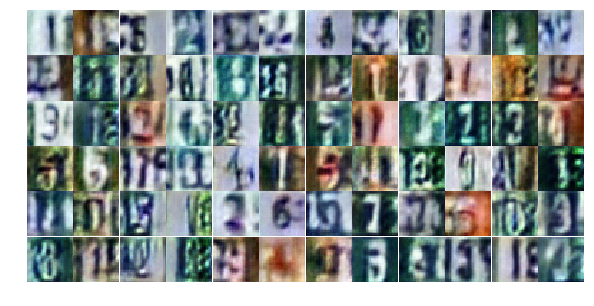

Epoch 6/25... Discriminator Loss: 0.4749... Generator Loss: 1.5464
Epoch 6/25... Discriminator Loss: 0.6385... Generator Loss: 1.1828
Epoch 6/25... Discriminator Loss: 0.5314... Generator Loss: 1.3707
Epoch 7/25... Discriminator Loss: 0.5571... Generator Loss: 1.7912
Epoch 7/25... Discriminator Loss: 0.6581... Generator Loss: 1.1218
Epoch 7/25... Discriminator Loss: 0.6868... Generator Loss: 1.0874
Epoch 7/25... Discriminator Loss: 0.5479... Generator Loss: 1.2793
Epoch 7/25... Discriminator Loss: 0.3863... Generator Loss: 1.7740
Epoch 7/25... Discriminator Loss: 0.3920... Generator Loss: 1.6723
Epoch 7/25... Discriminator Loss: 1.0420... Generator Loss: 1.1968


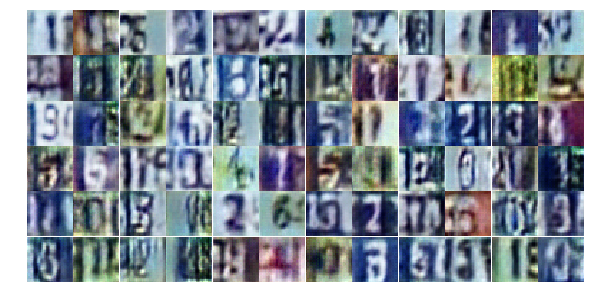

Epoch 7/25... Discriminator Loss: 0.7051... Generator Loss: 1.2903
Epoch 7/25... Discriminator Loss: 0.8224... Generator Loss: 0.8414
Epoch 7/25... Discriminator Loss: 0.8600... Generator Loss: 0.7819
Epoch 7/25... Discriminator Loss: 0.6280... Generator Loss: 1.6620
Epoch 7/25... Discriminator Loss: 0.6863... Generator Loss: 1.0537
Epoch 7/25... Discriminator Loss: 0.7222... Generator Loss: 0.9974
Epoch 7/25... Discriminator Loss: 0.8263... Generator Loss: 2.7666
Epoch 7/25... Discriminator Loss: 0.6220... Generator Loss: 2.0525
Epoch 7/25... Discriminator Loss: 1.5633... Generator Loss: 4.0314
Epoch 7/25... Discriminator Loss: 0.7363... Generator Loss: 1.1365


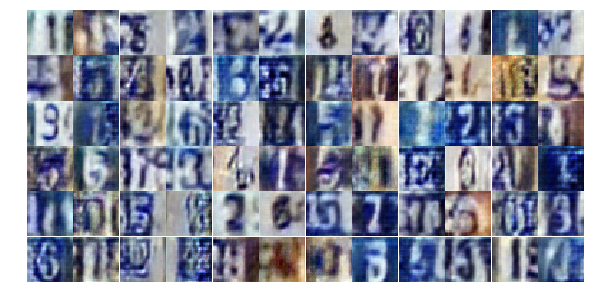

Epoch 7/25... Discriminator Loss: 0.4803... Generator Loss: 1.5836
Epoch 7/25... Discriminator Loss: 0.3332... Generator Loss: 1.6936
Epoch 7/25... Discriminator Loss: 0.7500... Generator Loss: 0.8447
Epoch 7/25... Discriminator Loss: 0.5347... Generator Loss: 1.6660
Epoch 7/25... Discriminator Loss: 0.3280... Generator Loss: 1.7361
Epoch 7/25... Discriminator Loss: 0.6893... Generator Loss: 1.9611
Epoch 7/25... Discriminator Loss: 0.5712... Generator Loss: 1.1227
Epoch 7/25... Discriminator Loss: 1.2206... Generator Loss: 0.5238
Epoch 7/25... Discriminator Loss: 0.5287... Generator Loss: 1.3661
Epoch 7/25... Discriminator Loss: 0.4058... Generator Loss: 1.8864


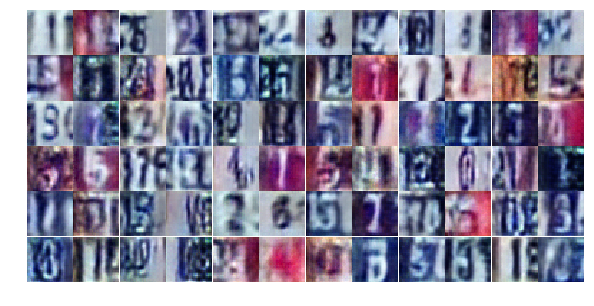

Epoch 7/25... Discriminator Loss: 0.7048... Generator Loss: 1.0850
Epoch 7/25... Discriminator Loss: 0.6359... Generator Loss: 1.1148
Epoch 7/25... Discriminator Loss: 0.7622... Generator Loss: 0.8476
Epoch 7/25... Discriminator Loss: 0.5773... Generator Loss: 1.1777
Epoch 7/25... Discriminator Loss: 0.5841... Generator Loss: 1.1806
Epoch 7/25... Discriminator Loss: 1.1113... Generator Loss: 0.5092
Epoch 7/25... Discriminator Loss: 0.3248... Generator Loss: 2.0672
Epoch 7/25... Discriminator Loss: 1.3081... Generator Loss: 1.0399
Epoch 7/25... Discriminator Loss: 0.9194... Generator Loss: 1.2641
Epoch 7/25... Discriminator Loss: 0.5868... Generator Loss: 1.3382


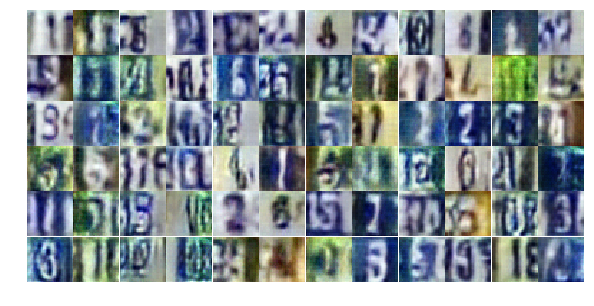

Epoch 7/25... Discriminator Loss: 0.8526... Generator Loss: 1.0057
Epoch 7/25... Discriminator Loss: 0.9860... Generator Loss: 1.0672
Epoch 7/25... Discriminator Loss: 0.3835... Generator Loss: 1.8895
Epoch 7/25... Discriminator Loss: 0.5613... Generator Loss: 1.6775
Epoch 7/25... Discriminator Loss: 1.2457... Generator Loss: 0.4591
Epoch 7/25... Discriminator Loss: 0.3205... Generator Loss: 1.9460
Epoch 7/25... Discriminator Loss: 0.3588... Generator Loss: 1.6473
Epoch 7/25... Discriminator Loss: 0.8256... Generator Loss: 0.8154
Epoch 7/25... Discriminator Loss: 0.3851... Generator Loss: 1.9244
Epoch 7/25... Discriminator Loss: 0.3459... Generator Loss: 1.8137


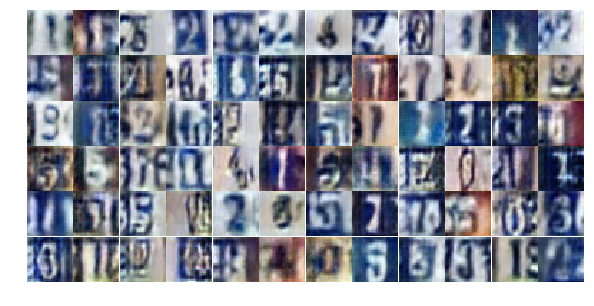

Epoch 7/25... Discriminator Loss: 0.3614... Generator Loss: 2.0490
Epoch 7/25... Discriminator Loss: 1.1152... Generator Loss: 2.3245
Epoch 7/25... Discriminator Loss: 0.6575... Generator Loss: 1.3646
Epoch 7/25... Discriminator Loss: 0.6413... Generator Loss: 1.2043
Epoch 7/25... Discriminator Loss: 0.8404... Generator Loss: 0.7599
Epoch 7/25... Discriminator Loss: 0.5107... Generator Loss: 1.4378
Epoch 7/25... Discriminator Loss: 1.6310... Generator Loss: 0.2690
Epoch 7/25... Discriminator Loss: 1.2684... Generator Loss: 0.4453
Epoch 7/25... Discriminator Loss: 0.6128... Generator Loss: 1.5578
Epoch 7/25... Discriminator Loss: 0.4089... Generator Loss: 1.6013


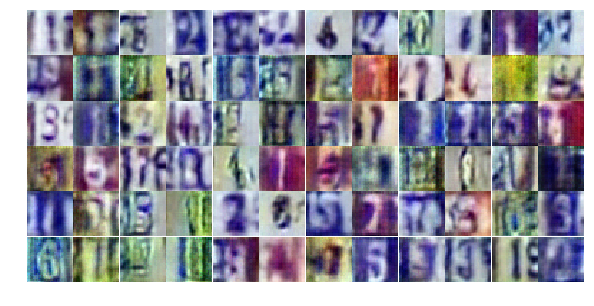

Epoch 7/25... Discriminator Loss: 0.8669... Generator Loss: 2.8031
Epoch 8/25... Discriminator Loss: 0.7276... Generator Loss: 0.9391
Epoch 8/25... Discriminator Loss: 0.6995... Generator Loss: 0.9557
Epoch 8/25... Discriminator Loss: 0.5782... Generator Loss: 1.2276
Epoch 8/25... Discriminator Loss: 0.6097... Generator Loss: 1.1913
Epoch 8/25... Discriminator Loss: 0.6622... Generator Loss: 1.3112
Epoch 8/25... Discriminator Loss: 0.7928... Generator Loss: 0.8629
Epoch 8/25... Discriminator Loss: 0.3679... Generator Loss: 1.8472
Epoch 8/25... Discriminator Loss: 0.6000... Generator Loss: 1.5858
Epoch 8/25... Discriminator Loss: 0.5258... Generator Loss: 1.2905


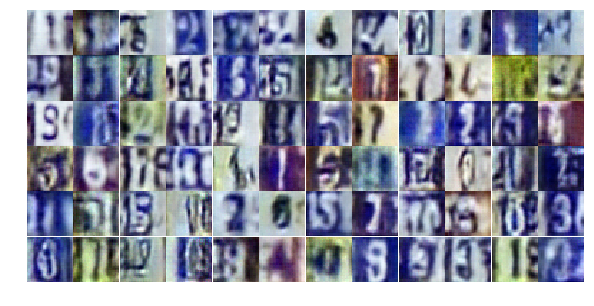

Epoch 8/25... Discriminator Loss: 0.5867... Generator Loss: 2.3370
Epoch 8/25... Discriminator Loss: 0.5032... Generator Loss: 1.4007
Epoch 8/25... Discriminator Loss: 0.8504... Generator Loss: 0.9065
Epoch 8/25... Discriminator Loss: 0.3121... Generator Loss: 2.1999
Epoch 8/25... Discriminator Loss: 0.7492... Generator Loss: 0.9348
Epoch 8/25... Discriminator Loss: 0.7880... Generator Loss: 2.2317
Epoch 8/25... Discriminator Loss: 0.4568... Generator Loss: 1.6095
Epoch 8/25... Discriminator Loss: 0.5297... Generator Loss: 1.7388
Epoch 8/25... Discriminator Loss: 0.6650... Generator Loss: 1.0508
Epoch 8/25... Discriminator Loss: 1.0809... Generator Loss: 0.6094


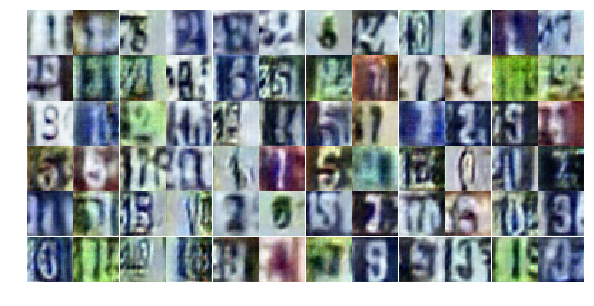

Epoch 8/25... Discriminator Loss: 0.5016... Generator Loss: 2.0495
Epoch 8/25... Discriminator Loss: 0.4572... Generator Loss: 1.4310
Epoch 8/25... Discriminator Loss: 0.5793... Generator Loss: 1.6973
Epoch 8/25... Discriminator Loss: 0.6141... Generator Loss: 2.0732
Epoch 8/25... Discriminator Loss: 0.4702... Generator Loss: 1.6225
Epoch 8/25... Discriminator Loss: 0.6043... Generator Loss: 1.3005
Epoch 8/25... Discriminator Loss: 0.5816... Generator Loss: 1.6056
Epoch 8/25... Discriminator Loss: 0.4241... Generator Loss: 1.6561
Epoch 8/25... Discriminator Loss: 0.8061... Generator Loss: 2.3613
Epoch 8/25... Discriminator Loss: 0.5738... Generator Loss: 1.2317


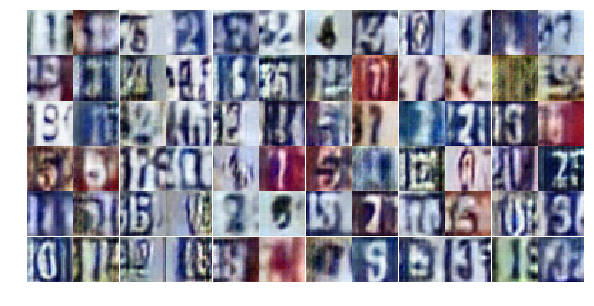

Epoch 8/25... Discriminator Loss: 0.6227... Generator Loss: 1.4013
Epoch 8/25... Discriminator Loss: 0.8137... Generator Loss: 0.8875
Epoch 8/25... Discriminator Loss: 0.4043... Generator Loss: 1.8765
Epoch 8/25... Discriminator Loss: 0.7222... Generator Loss: 0.9433
Epoch 8/25... Discriminator Loss: 0.4636... Generator Loss: 1.5021
Epoch 8/25... Discriminator Loss: 0.7115... Generator Loss: 0.9067
Epoch 8/25... Discriminator Loss: 0.9423... Generator Loss: 0.7471
Epoch 8/25... Discriminator Loss: 0.6041... Generator Loss: 1.1344
Epoch 8/25... Discriminator Loss: 0.8152... Generator Loss: 2.0517
Epoch 8/25... Discriminator Loss: 0.5474... Generator Loss: 1.0839


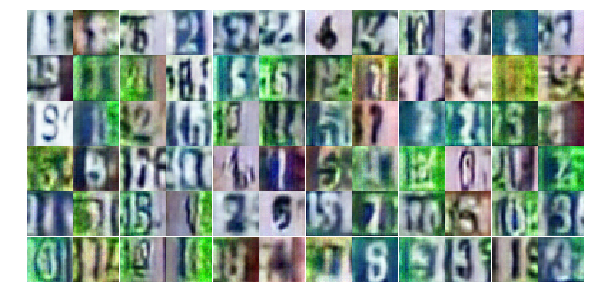

Epoch 8/25... Discriminator Loss: 0.5975... Generator Loss: 2.7106
Epoch 8/25... Discriminator Loss: 0.8906... Generator Loss: 0.7765
Epoch 8/25... Discriminator Loss: 0.3434... Generator Loss: 1.6297
Epoch 8/25... Discriminator Loss: 0.4559... Generator Loss: 1.7940
Epoch 8/25... Discriminator Loss: 0.8246... Generator Loss: 2.1573
Epoch 8/25... Discriminator Loss: 1.0899... Generator Loss: 0.5796
Epoch 8/25... Discriminator Loss: 1.0329... Generator Loss: 0.6382
Epoch 8/25... Discriminator Loss: 0.5271... Generator Loss: 1.4649
Epoch 8/25... Discriminator Loss: 0.4445... Generator Loss: 1.3991
Epoch 8/25... Discriminator Loss: 0.7082... Generator Loss: 1.0689


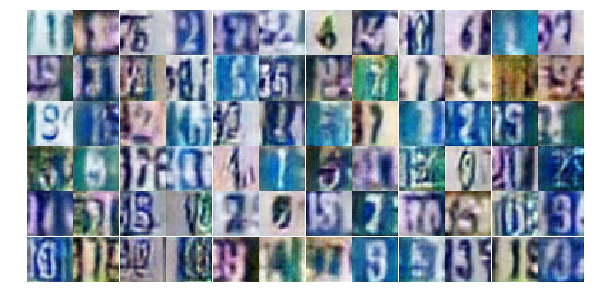

Epoch 8/25... Discriminator Loss: 0.6517... Generator Loss: 3.1332
Epoch 8/25... Discriminator Loss: 0.7838... Generator Loss: 0.8607
Epoch 8/25... Discriminator Loss: 0.3228... Generator Loss: 2.4665
Epoch 8/25... Discriminator Loss: 1.1726... Generator Loss: 0.5402
Epoch 8/25... Discriminator Loss: 0.3103... Generator Loss: 2.4111
Epoch 8/25... Discriminator Loss: 0.9748... Generator Loss: 0.6813
Epoch 8/25... Discriminator Loss: 0.5250... Generator Loss: 1.6552
Epoch 8/25... Discriminator Loss: 0.5472... Generator Loss: 1.4425
Epoch 9/25... Discriminator Loss: 0.9172... Generator Loss: 0.6771
Epoch 9/25... Discriminator Loss: 0.7896... Generator Loss: 0.9075


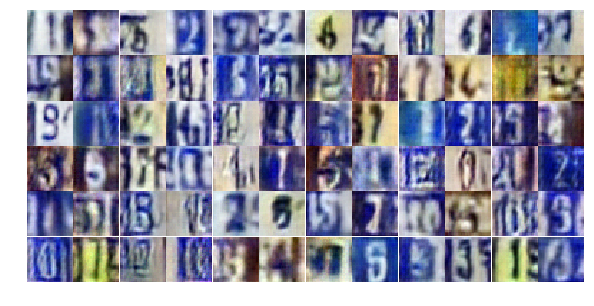

Epoch 9/25... Discriminator Loss: 0.6933... Generator Loss: 1.0912
Epoch 9/25... Discriminator Loss: 0.5449... Generator Loss: 1.3202
Epoch 9/25... Discriminator Loss: 0.6309... Generator Loss: 1.0772
Epoch 9/25... Discriminator Loss: 0.5550... Generator Loss: 1.2640
Epoch 9/25... Discriminator Loss: 1.0094... Generator Loss: 0.6728
Epoch 9/25... Discriminator Loss: 0.4535... Generator Loss: 2.4495
Epoch 9/25... Discriminator Loss: 0.6608... Generator Loss: 1.4965
Epoch 9/25... Discriminator Loss: 0.5651... Generator Loss: 1.1469
Epoch 9/25... Discriminator Loss: 0.8098... Generator Loss: 0.8237
Epoch 9/25... Discriminator Loss: 0.5301... Generator Loss: 1.3372


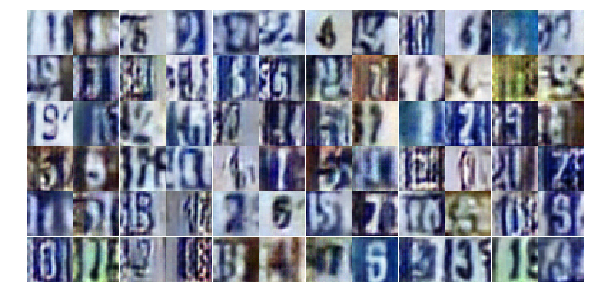

Epoch 9/25... Discriminator Loss: 0.7632... Generator Loss: 0.9246
Epoch 9/25... Discriminator Loss: 1.2312... Generator Loss: 0.5092
Epoch 9/25... Discriminator Loss: 1.1932... Generator Loss: 0.5174
Epoch 9/25... Discriminator Loss: 0.8773... Generator Loss: 0.8176
Epoch 9/25... Discriminator Loss: 0.5669... Generator Loss: 1.1453
Epoch 9/25... Discriminator Loss: 0.8298... Generator Loss: 2.0672
Epoch 9/25... Discriminator Loss: 1.1955... Generator Loss: 0.5191
Epoch 9/25... Discriminator Loss: 0.6629... Generator Loss: 0.9832
Epoch 9/25... Discriminator Loss: 0.8451... Generator Loss: 0.8076
Epoch 9/25... Discriminator Loss: 0.6801... Generator Loss: 1.3325


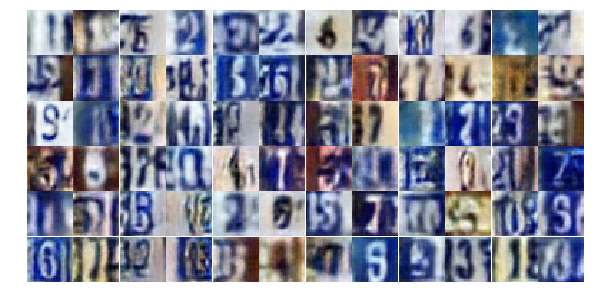

Epoch 9/25... Discriminator Loss: 0.8225... Generator Loss: 0.8160
Epoch 9/25... Discriminator Loss: 0.4668... Generator Loss: 1.6254
Epoch 9/25... Discriminator Loss: 0.5083... Generator Loss: 1.3876
Epoch 9/25... Discriminator Loss: 0.6883... Generator Loss: 1.0187
Epoch 9/25... Discriminator Loss: 0.7203... Generator Loss: 2.1733
Epoch 9/25... Discriminator Loss: 0.4892... Generator Loss: 1.4932
Epoch 9/25... Discriminator Loss: 1.1878... Generator Loss: 0.5237
Epoch 9/25... Discriminator Loss: 0.4338... Generator Loss: 1.6186
Epoch 9/25... Discriminator Loss: 0.5498... Generator Loss: 1.1556
Epoch 9/25... Discriminator Loss: 0.7021... Generator Loss: 0.9187


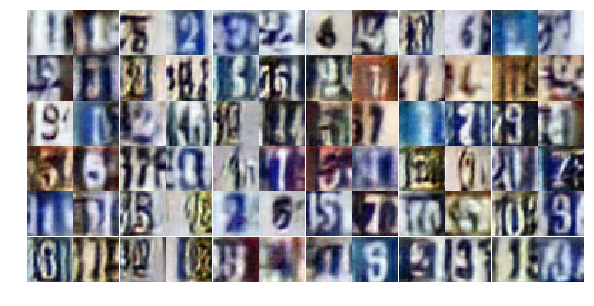

Epoch 9/25... Discriminator Loss: 0.6262... Generator Loss: 1.0873
Epoch 9/25... Discriminator Loss: 0.6164... Generator Loss: 1.1556
Epoch 9/25... Discriminator Loss: 0.6881... Generator Loss: 1.1612
Epoch 9/25... Discriminator Loss: 0.5716... Generator Loss: 1.9491
Epoch 9/25... Discriminator Loss: 0.6663... Generator Loss: 1.1674
Epoch 9/25... Discriminator Loss: 0.5906... Generator Loss: 1.1941
Epoch 9/25... Discriminator Loss: 0.3929... Generator Loss: 1.7696
Epoch 9/25... Discriminator Loss: 0.3944... Generator Loss: 1.6016
Epoch 9/25... Discriminator Loss: 0.8978... Generator Loss: 0.7471
Epoch 9/25... Discriminator Loss: 0.8480... Generator Loss: 0.8129


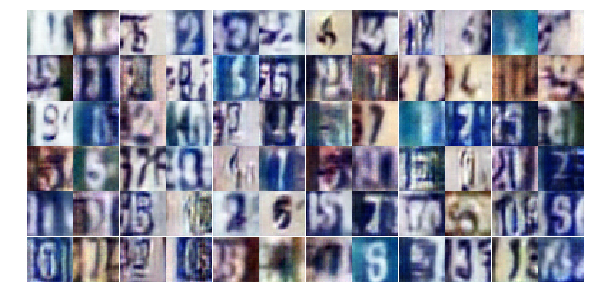

Epoch 9/25... Discriminator Loss: 0.5640... Generator Loss: 1.1475
Epoch 9/25... Discriminator Loss: 0.7675... Generator Loss: 0.9365
Epoch 9/25... Discriminator Loss: 0.4140... Generator Loss: 1.8620
Epoch 9/25... Discriminator Loss: 0.6508... Generator Loss: 1.6357
Epoch 9/25... Discriminator Loss: 0.3985... Generator Loss: 1.7175
Epoch 9/25... Discriminator Loss: 0.6462... Generator Loss: 1.1323
Epoch 9/25... Discriminator Loss: 0.5967... Generator Loss: 1.2570
Epoch 9/25... Discriminator Loss: 1.0001... Generator Loss: 0.5847
Epoch 9/25... Discriminator Loss: 0.4969... Generator Loss: 1.4811
Epoch 9/25... Discriminator Loss: 0.3885... Generator Loss: 1.9436


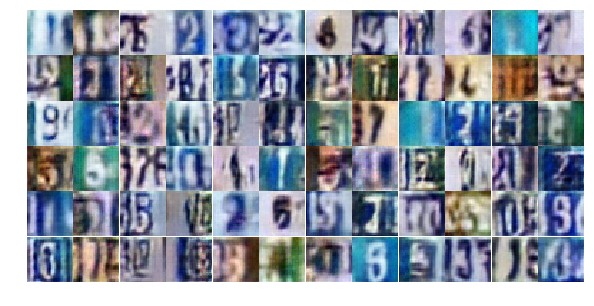

Epoch 9/25... Discriminator Loss: 0.7042... Generator Loss: 0.9864
Epoch 9/25... Discriminator Loss: 0.5345... Generator Loss: 2.2108
Epoch 9/25... Discriminator Loss: 0.7724... Generator Loss: 0.8841
Epoch 9/25... Discriminator Loss: 0.9551... Generator Loss: 0.6569
Epoch 9/25... Discriminator Loss: 0.5397... Generator Loss: 1.2042
Epoch 10/25... Discriminator Loss: 0.8156... Generator Loss: 0.8216
Epoch 10/25... Discriminator Loss: 0.4541... Generator Loss: 1.4966
Epoch 10/25... Discriminator Loss: 0.6349... Generator Loss: 1.1084
Epoch 10/25... Discriminator Loss: 0.9122... Generator Loss: 0.7185
Epoch 10/25... Discriminator Loss: 1.7600... Generator Loss: 0.2542


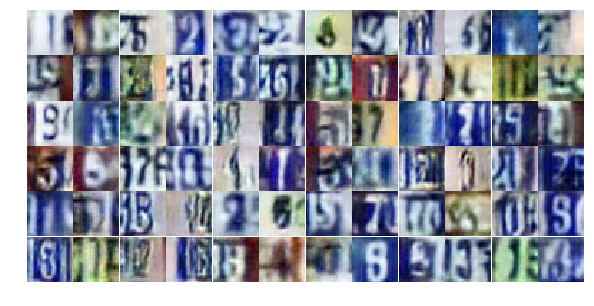

Epoch 10/25... Discriminator Loss: 1.7438... Generator Loss: 0.3508
Epoch 10/25... Discriminator Loss: 0.4532... Generator Loss: 1.5866
Epoch 10/25... Discriminator Loss: 0.5729... Generator Loss: 1.2732
Epoch 10/25... Discriminator Loss: 0.7850... Generator Loss: 0.9484
Epoch 10/25... Discriminator Loss: 0.4590... Generator Loss: 2.3623
Epoch 10/25... Discriminator Loss: 0.5215... Generator Loss: 1.2213
Epoch 10/25... Discriminator Loss: 0.5120... Generator Loss: 1.2648
Epoch 10/25... Discriminator Loss: 0.8750... Generator Loss: 0.7519
Epoch 10/25... Discriminator Loss: 1.5094... Generator Loss: 0.4486
Epoch 10/25... Discriminator Loss: 0.5704... Generator Loss: 1.8111


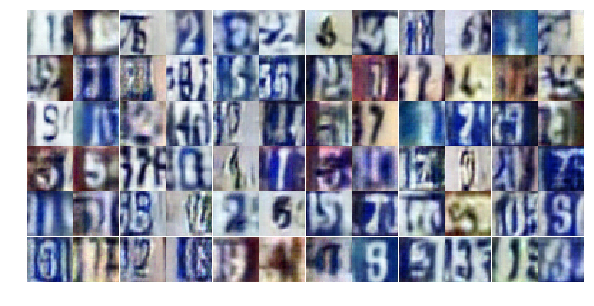

Epoch 10/25... Discriminator Loss: 0.6146... Generator Loss: 1.2308
Epoch 10/25... Discriminator Loss: 1.0812... Generator Loss: 0.5981
Epoch 10/25... Discriminator Loss: 0.5982... Generator Loss: 1.2115
Epoch 10/25... Discriminator Loss: 1.3376... Generator Loss: 0.4217
Epoch 10/25... Discriminator Loss: 0.7446... Generator Loss: 1.9808
Epoch 10/25... Discriminator Loss: 0.5271... Generator Loss: 1.2933
Epoch 10/25... Discriminator Loss: 0.9682... Generator Loss: 0.6838
Epoch 10/25... Discriminator Loss: 0.5562... Generator Loss: 1.7228
Epoch 10/25... Discriminator Loss: 0.6140... Generator Loss: 1.1394
Epoch 10/25... Discriminator Loss: 0.4260... Generator Loss: 3.1138


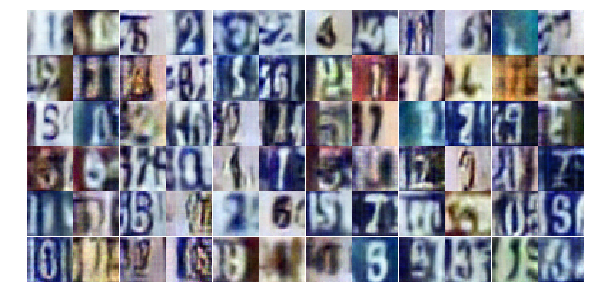

Epoch 10/25... Discriminator Loss: 0.7114... Generator Loss: 0.9091
Epoch 10/25... Discriminator Loss: 0.7772... Generator Loss: 0.9093
Epoch 10/25... Discriminator Loss: 0.3911... Generator Loss: 1.4474
Epoch 10/25... Discriminator Loss: 0.7487... Generator Loss: 3.8864
Epoch 10/25... Discriminator Loss: 1.0646... Generator Loss: 0.5436
Epoch 10/25... Discriminator Loss: 0.7596... Generator Loss: 0.9236
Epoch 10/25... Discriminator Loss: 0.4267... Generator Loss: 1.4645
Epoch 10/25... Discriminator Loss: 0.9556... Generator Loss: 0.6837
Epoch 10/25... Discriminator Loss: 0.5316... Generator Loss: 1.2002
Epoch 10/25... Discriminator Loss: 0.9018... Generator Loss: 0.8008


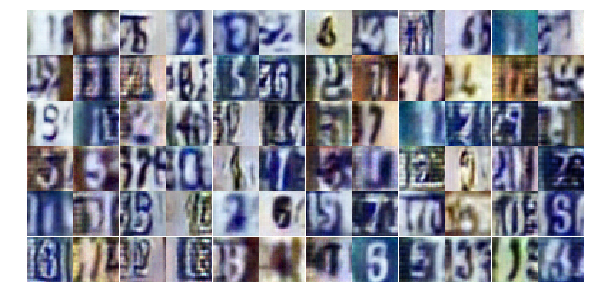

Epoch 10/25... Discriminator Loss: 0.5534... Generator Loss: 2.4228
Epoch 10/25... Discriminator Loss: 0.7519... Generator Loss: 0.9031
Epoch 10/25... Discriminator Loss: 0.4687... Generator Loss: 1.4497
Epoch 10/25... Discriminator Loss: 0.7958... Generator Loss: 0.9356
Epoch 10/25... Discriminator Loss: 0.7422... Generator Loss: 1.0195
Epoch 10/25... Discriminator Loss: 0.6914... Generator Loss: 1.0929
Epoch 10/25... Discriminator Loss: 0.7941... Generator Loss: 0.8109
Epoch 10/25... Discriminator Loss: 0.9316... Generator Loss: 0.7207
Epoch 10/25... Discriminator Loss: 0.7201... Generator Loss: 1.0668
Epoch 10/25... Discriminator Loss: 1.2123... Generator Loss: 0.5531


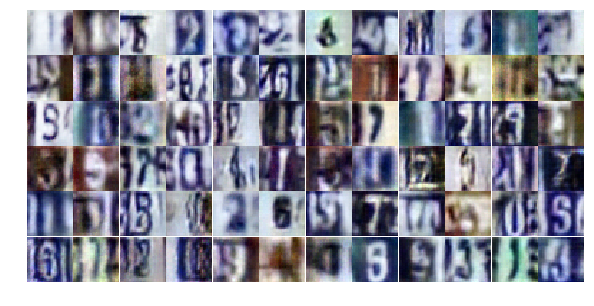

Epoch 10/25... Discriminator Loss: 0.6736... Generator Loss: 1.0081
Epoch 10/25... Discriminator Loss: 0.9064... Generator Loss: 0.7243
Epoch 10/25... Discriminator Loss: 1.1164... Generator Loss: 0.6336
Epoch 10/25... Discriminator Loss: 0.6597... Generator Loss: 1.3339
Epoch 10/25... Discriminator Loss: 0.5271... Generator Loss: 1.5051
Epoch 10/25... Discriminator Loss: 0.5927... Generator Loss: 1.3684
Epoch 10/25... Discriminator Loss: 0.5878... Generator Loss: 1.1075
Epoch 10/25... Discriminator Loss: 0.5137... Generator Loss: 1.4693
Epoch 10/25... Discriminator Loss: 0.5055... Generator Loss: 1.4358
Epoch 10/25... Discriminator Loss: 0.5014... Generator Loss: 1.5123


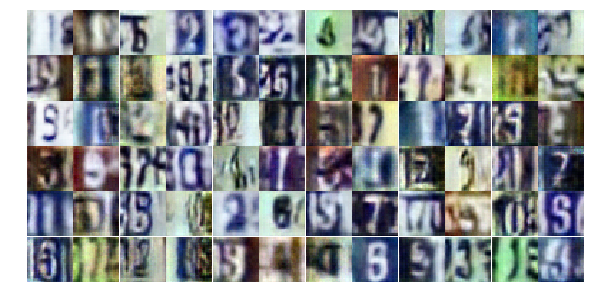

Epoch 10/25... Discriminator Loss: 1.1063... Generator Loss: 0.5959
Epoch 10/25... Discriminator Loss: 0.6551... Generator Loss: 0.9842
Epoch 10/25... Discriminator Loss: 0.5650... Generator Loss: 1.1531
Epoch 11/25... Discriminator Loss: 0.8521... Generator Loss: 0.8520
Epoch 11/25... Discriminator Loss: 0.6692... Generator Loss: 1.1057
Epoch 11/25... Discriminator Loss: 0.9222... Generator Loss: 0.7214
Epoch 11/25... Discriminator Loss: 0.6574... Generator Loss: 1.0132
Epoch 11/25... Discriminator Loss: 0.5394... Generator Loss: 1.5273
Epoch 11/25... Discriminator Loss: 2.4215... Generator Loss: 2.8267
Epoch 11/25... Discriminator Loss: 0.4533... Generator Loss: 1.7347


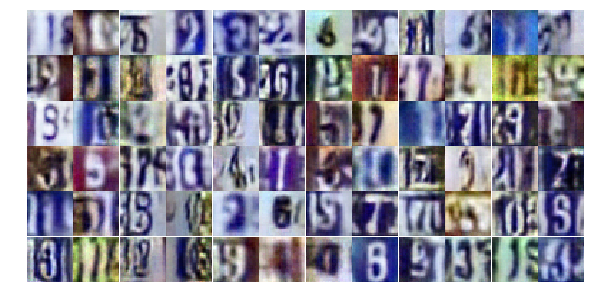

Epoch 11/25... Discriminator Loss: 0.4855... Generator Loss: 1.4643
Epoch 11/25... Discriminator Loss: 0.6680... Generator Loss: 1.2133
Epoch 11/25... Discriminator Loss: 0.5691... Generator Loss: 1.1879
Epoch 11/25... Discriminator Loss: 0.5100... Generator Loss: 1.3096
Epoch 11/25... Discriminator Loss: 0.6883... Generator Loss: 1.2264
Epoch 11/25... Discriminator Loss: 0.3469... Generator Loss: 1.9405
Epoch 11/25... Discriminator Loss: 0.8610... Generator Loss: 0.9309
Epoch 11/25... Discriminator Loss: 0.4243... Generator Loss: 1.9373
Epoch 11/25... Discriminator Loss: 0.8369... Generator Loss: 0.7845
Epoch 11/25... Discriminator Loss: 1.1602... Generator Loss: 0.5981


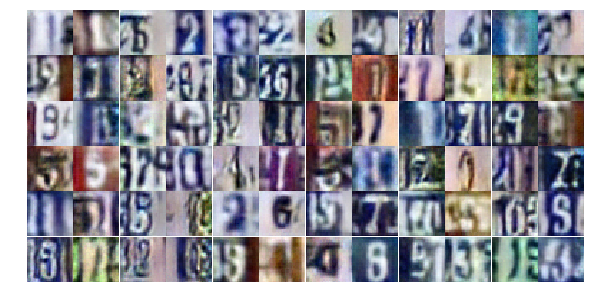

Epoch 11/25... Discriminator Loss: 0.9975... Generator Loss: 0.7074
Epoch 11/25... Discriminator Loss: 0.3349... Generator Loss: 1.9233
Epoch 11/25... Discriminator Loss: 0.9393... Generator Loss: 0.7591
Epoch 11/25... Discriminator Loss: 0.5251... Generator Loss: 1.2089
Epoch 11/25... Discriminator Loss: 0.4539... Generator Loss: 1.9322
Epoch 11/25... Discriminator Loss: 0.5349... Generator Loss: 1.3323
Epoch 11/25... Discriminator Loss: 0.4801... Generator Loss: 1.5365
Epoch 11/25... Discriminator Loss: 0.8713... Generator Loss: 0.7428
Epoch 11/25... Discriminator Loss: 0.2959... Generator Loss: 1.9369
Epoch 11/25... Discriminator Loss: 0.6723... Generator Loss: 1.2495


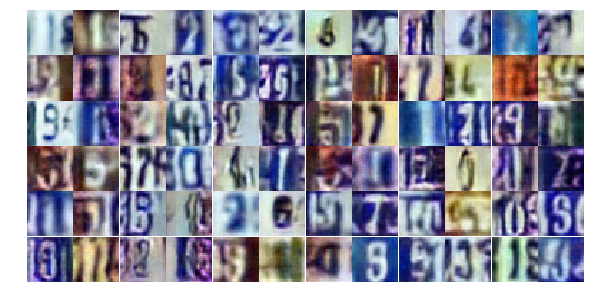

Epoch 11/25... Discriminator Loss: 0.8980... Generator Loss: 0.7766
Epoch 11/25... Discriminator Loss: 0.7579... Generator Loss: 0.9715
Epoch 11/25... Discriminator Loss: 0.7301... Generator Loss: 0.9508
Epoch 11/25... Discriminator Loss: 0.5030... Generator Loss: 1.4389
Epoch 11/25... Discriminator Loss: 0.5284... Generator Loss: 1.2096
Epoch 11/25... Discriminator Loss: 0.7891... Generator Loss: 0.8429
Epoch 11/25... Discriminator Loss: 1.0705... Generator Loss: 0.6828
Epoch 11/25... Discriminator Loss: 0.8243... Generator Loss: 0.7995
Epoch 11/25... Discriminator Loss: 0.8447... Generator Loss: 0.8348
Epoch 11/25... Discriminator Loss: 0.8400... Generator Loss: 0.8033


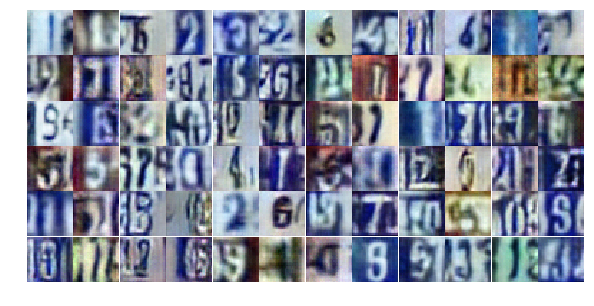

Epoch 11/25... Discriminator Loss: 0.5580... Generator Loss: 1.6891
Epoch 11/25... Discriminator Loss: 0.5163... Generator Loss: 1.3822
Epoch 11/25... Discriminator Loss: 0.8301... Generator Loss: 0.7944
Epoch 11/25... Discriminator Loss: 0.6831... Generator Loss: 1.2028
Epoch 11/25... Discriminator Loss: 1.0890... Generator Loss: 0.5848
Epoch 11/25... Discriminator Loss: 0.6528... Generator Loss: 1.1404
Epoch 11/25... Discriminator Loss: 0.4533... Generator Loss: 1.4885
Epoch 11/25... Discriminator Loss: 2.1096... Generator Loss: 0.2673
Epoch 11/25... Discriminator Loss: 1.1883... Generator Loss: 0.6000
Epoch 11/25... Discriminator Loss: 0.5262... Generator Loss: 1.2993


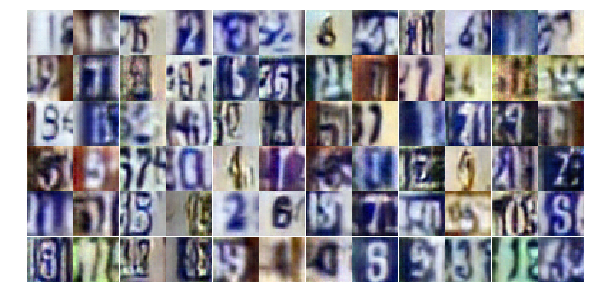

Epoch 11/25... Discriminator Loss: 0.9248... Generator Loss: 0.7112
Epoch 11/25... Discriminator Loss: 0.3694... Generator Loss: 2.0892
Epoch 11/25... Discriminator Loss: 0.8220... Generator Loss: 1.6709
Epoch 11/25... Discriminator Loss: 0.7554... Generator Loss: 0.9530
Epoch 11/25... Discriminator Loss: 0.9787... Generator Loss: 0.6991
Epoch 11/25... Discriminator Loss: 0.6981... Generator Loss: 0.9304
Epoch 11/25... Discriminator Loss: 0.8140... Generator Loss: 0.9037
Epoch 11/25... Discriminator Loss: 0.3712... Generator Loss: 1.9578
Epoch 11/25... Discriminator Loss: 0.9360... Generator Loss: 0.6681
Epoch 11/25... Discriminator Loss: 0.8014... Generator Loss: 0.9376


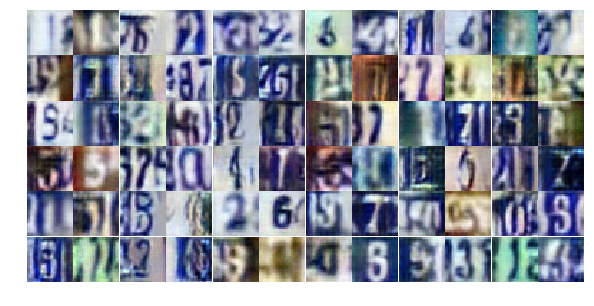

Epoch 12/25... Discriminator Loss: 0.8578... Generator Loss: 0.9357
Epoch 12/25... Discriminator Loss: 0.9732... Generator Loss: 2.6045
Epoch 12/25... Discriminator Loss: 1.4160... Generator Loss: 0.4008
Epoch 12/25... Discriminator Loss: 0.5599... Generator Loss: 1.4463
Epoch 12/25... Discriminator Loss: 0.5167... Generator Loss: 1.2864
Epoch 12/25... Discriminator Loss: 1.2202... Generator Loss: 0.4963
Epoch 12/25... Discriminator Loss: 0.5162... Generator Loss: 1.9810
Epoch 12/25... Discriminator Loss: 0.7778... Generator Loss: 0.9205
Epoch 12/25... Discriminator Loss: 0.6260... Generator Loss: 1.3818
Epoch 12/25... Discriminator Loss: 1.1473... Generator Loss: 0.5528


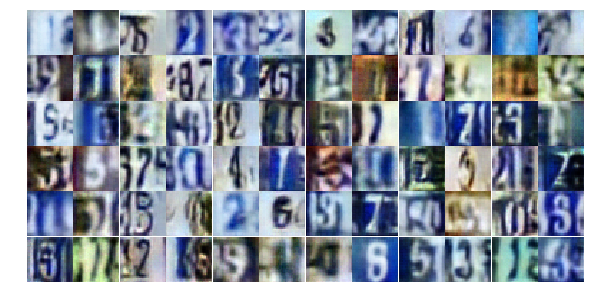

Epoch 12/25... Discriminator Loss: 0.5558... Generator Loss: 1.2560
Epoch 12/25... Discriminator Loss: 0.7587... Generator Loss: 0.9709
Epoch 12/25... Discriminator Loss: 0.4769... Generator Loss: 2.3754
Epoch 12/25... Discriminator Loss: 2.0419... Generator Loss: 0.2639
Epoch 12/25... Discriminator Loss: 0.6377... Generator Loss: 1.2409
Epoch 12/25... Discriminator Loss: 0.8923... Generator Loss: 0.8668
Epoch 12/25... Discriminator Loss: 1.2775... Generator Loss: 0.4662
Epoch 12/25... Discriminator Loss: 0.5522... Generator Loss: 2.0308
Epoch 12/25... Discriminator Loss: 0.5655... Generator Loss: 1.1474
Epoch 12/25... Discriminator Loss: 0.7384... Generator Loss: 0.8598


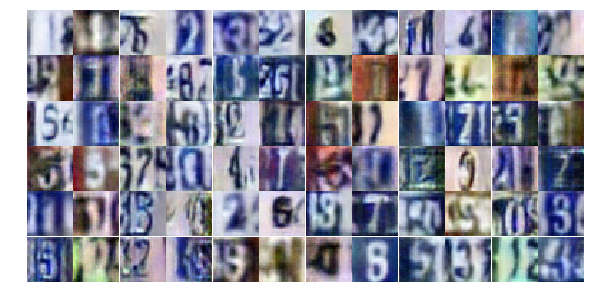

Epoch 12/25... Discriminator Loss: 0.3447... Generator Loss: 2.0632
Epoch 12/25... Discriminator Loss: 0.4210... Generator Loss: 1.4220
Epoch 12/25... Discriminator Loss: 0.7336... Generator Loss: 0.9137
Epoch 12/25... Discriminator Loss: 0.5589... Generator Loss: 1.3721
Epoch 12/25... Discriminator Loss: 0.5165... Generator Loss: 1.8580
Epoch 12/25... Discriminator Loss: 0.4714... Generator Loss: 1.2996
Epoch 12/25... Discriminator Loss: 0.8685... Generator Loss: 0.7257
Epoch 12/25... Discriminator Loss: 0.5001... Generator Loss: 1.4001
Epoch 12/25... Discriminator Loss: 0.6095... Generator Loss: 1.1393
Epoch 12/25... Discriminator Loss: 0.5412... Generator Loss: 1.6976


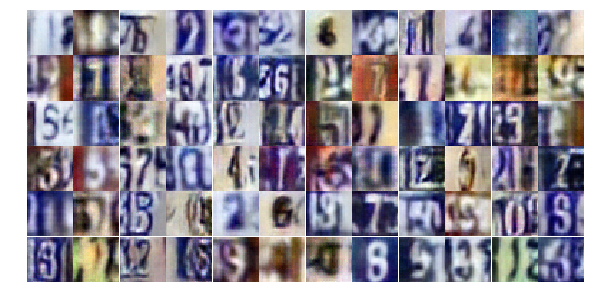

Epoch 12/25... Discriminator Loss: 0.7177... Generator Loss: 0.9115
Epoch 12/25... Discriminator Loss: 0.8358... Generator Loss: 1.0419
Epoch 12/25... Discriminator Loss: 0.8161... Generator Loss: 0.8149
Epoch 12/25... Discriminator Loss: 1.9626... Generator Loss: 0.1948
Epoch 12/25... Discriminator Loss: 0.7073... Generator Loss: 1.9182
Epoch 12/25... Discriminator Loss: 0.7576... Generator Loss: 0.9640
Epoch 12/25... Discriminator Loss: 0.9021... Generator Loss: 0.7179
Epoch 12/25... Discriminator Loss: 0.7776... Generator Loss: 1.0318
Epoch 12/25... Discriminator Loss: 0.4409... Generator Loss: 1.3807
Epoch 12/25... Discriminator Loss: 0.3411... Generator Loss: 1.6014


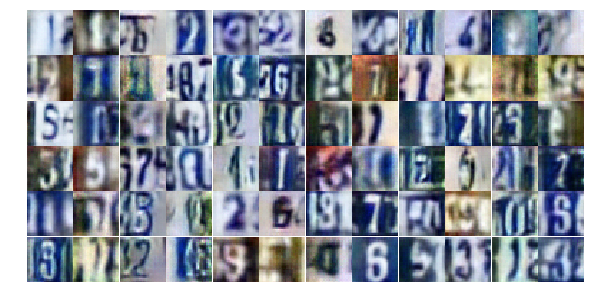

Epoch 12/25... Discriminator Loss: 0.4775... Generator Loss: 2.3618
Epoch 12/25... Discriminator Loss: 0.5113... Generator Loss: 1.2994
Epoch 12/25... Discriminator Loss: 0.2271... Generator Loss: 2.3233
Epoch 12/25... Discriminator Loss: 1.0314... Generator Loss: 0.6779
Epoch 12/25... Discriminator Loss: 0.6697... Generator Loss: 1.2383
Epoch 12/25... Discriminator Loss: 1.7305... Generator Loss: 0.2560
Epoch 12/25... Discriminator Loss: 0.7306... Generator Loss: 0.9241
Epoch 12/25... Discriminator Loss: 0.9191... Generator Loss: 0.7002
Epoch 12/25... Discriminator Loss: 0.5800... Generator Loss: 1.1416
Epoch 12/25... Discriminator Loss: 0.6069... Generator Loss: 1.0649


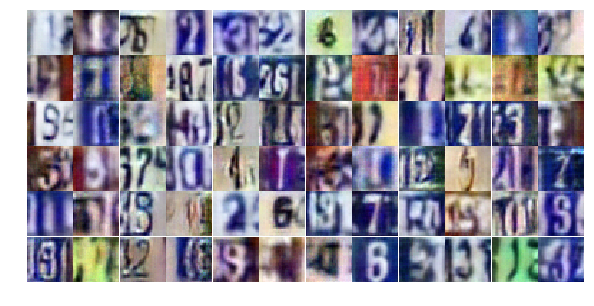

Epoch 12/25... Discriminator Loss: 1.0552... Generator Loss: 0.6575
Epoch 12/25... Discriminator Loss: 0.6938... Generator Loss: 1.3374
Epoch 12/25... Discriminator Loss: 0.8771... Generator Loss: 1.9366
Epoch 12/25... Discriminator Loss: 1.5825... Generator Loss: 0.3623
Epoch 12/25... Discriminator Loss: 0.7389... Generator Loss: 0.9264
Epoch 12/25... Discriminator Loss: 0.6700... Generator Loss: 1.6972
Epoch 12/25... Discriminator Loss: 0.7412... Generator Loss: 1.5491
Epoch 13/25... Discriminator Loss: 0.4535... Generator Loss: 1.3581
Epoch 13/25... Discriminator Loss: 0.5019... Generator Loss: 1.4630
Epoch 13/25... Discriminator Loss: 0.8511... Generator Loss: 0.7640


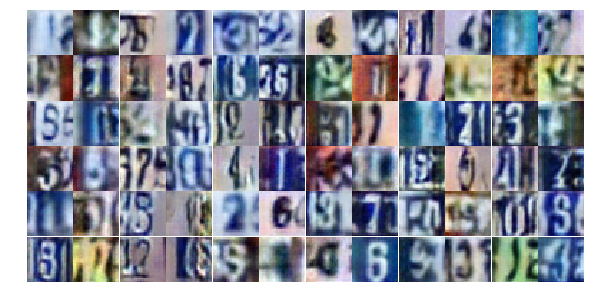

Epoch 13/25... Discriminator Loss: 0.6146... Generator Loss: 1.3956
Epoch 13/25... Discriminator Loss: 0.5665... Generator Loss: 1.4074
Epoch 13/25... Discriminator Loss: 1.4797... Generator Loss: 0.3725
Epoch 13/25... Discriminator Loss: 1.1430... Generator Loss: 0.6114
Epoch 13/25... Discriminator Loss: 0.6999... Generator Loss: 0.9879
Epoch 13/25... Discriminator Loss: 0.9512... Generator Loss: 0.7627
Epoch 13/25... Discriminator Loss: 0.4590... Generator Loss: 1.8445
Epoch 13/25... Discriminator Loss: 0.7862... Generator Loss: 0.8387
Epoch 13/25... Discriminator Loss: 0.4479... Generator Loss: 1.4573
Epoch 13/25... Discriminator Loss: 0.5362... Generator Loss: 1.3341


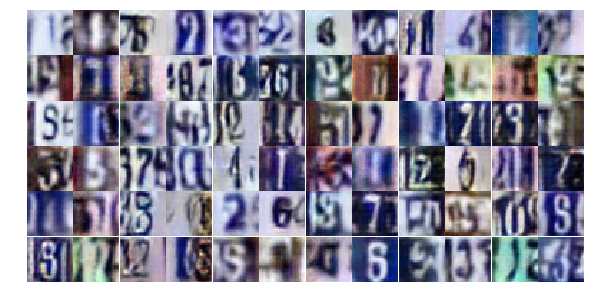

Epoch 13/25... Discriminator Loss: 0.8674... Generator Loss: 0.7351
Epoch 13/25... Discriminator Loss: 0.6356... Generator Loss: 1.2047
Epoch 13/25... Discriminator Loss: 1.0699... Generator Loss: 0.5859
Epoch 13/25... Discriminator Loss: 0.6580... Generator Loss: 1.0780
Epoch 13/25... Discriminator Loss: 0.6243... Generator Loss: 1.2450
Epoch 13/25... Discriminator Loss: 0.7700... Generator Loss: 0.9601
Epoch 13/25... Discriminator Loss: 0.5771... Generator Loss: 1.2008
Epoch 13/25... Discriminator Loss: 1.1809... Generator Loss: 0.5021
Epoch 13/25... Discriminator Loss: 0.5664... Generator Loss: 1.2495
Epoch 13/25... Discriminator Loss: 1.1133... Generator Loss: 0.5621


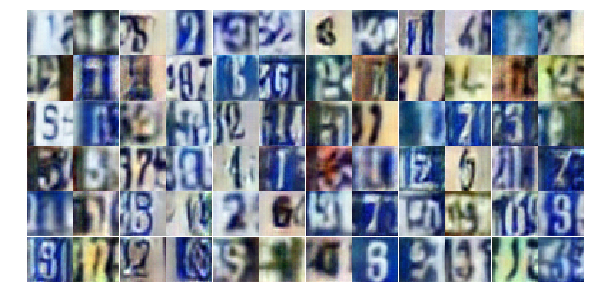

Epoch 13/25... Discriminator Loss: 0.7187... Generator Loss: 0.9103
Epoch 13/25... Discriminator Loss: 0.3693... Generator Loss: 1.9405
Epoch 13/25... Discriminator Loss: 0.4599... Generator Loss: 2.7417
Epoch 13/25... Discriminator Loss: 0.6209... Generator Loss: 1.0442
Epoch 13/25... Discriminator Loss: 0.7709... Generator Loss: 1.0118
Epoch 13/25... Discriminator Loss: 0.8935... Generator Loss: 0.7830
Epoch 13/25... Discriminator Loss: 0.7486... Generator Loss: 1.2577
Epoch 13/25... Discriminator Loss: 0.5514... Generator Loss: 1.2926
Epoch 13/25... Discriminator Loss: 0.6572... Generator Loss: 1.0228
Epoch 13/25... Discriminator Loss: 0.5735... Generator Loss: 1.2730


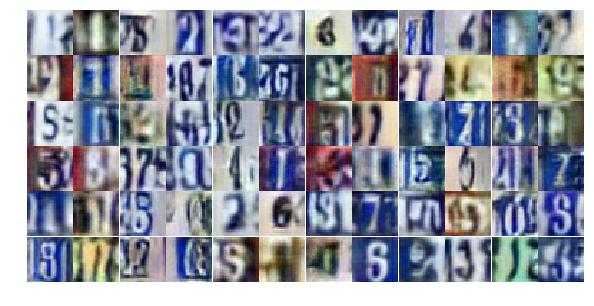

Epoch 13/25... Discriminator Loss: 1.0866... Generator Loss: 0.6054
Epoch 13/25... Discriminator Loss: 0.6833... Generator Loss: 1.3621
Epoch 13/25... Discriminator Loss: 0.8192... Generator Loss: 0.8803
Epoch 13/25... Discriminator Loss: 0.9980... Generator Loss: 0.7147
Epoch 13/25... Discriminator Loss: 0.6727... Generator Loss: 1.1071
Epoch 13/25... Discriminator Loss: 0.5988... Generator Loss: 1.1385
Epoch 13/25... Discriminator Loss: 0.4410... Generator Loss: 1.6341
Epoch 13/25... Discriminator Loss: 0.7814... Generator Loss: 1.0026
Epoch 13/25... Discriminator Loss: 0.6431... Generator Loss: 1.2189
Epoch 13/25... Discriminator Loss: 0.7314... Generator Loss: 0.9163


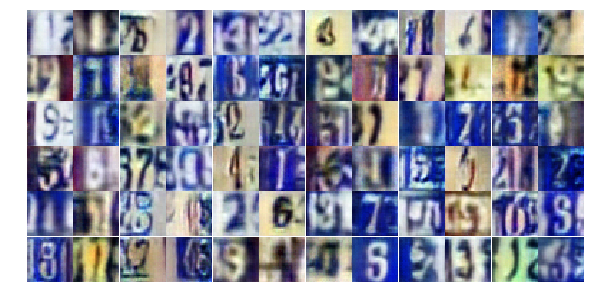

Epoch 13/25... Discriminator Loss: 0.5634... Generator Loss: 1.2142
Epoch 13/25... Discriminator Loss: 0.7211... Generator Loss: 0.9730
Epoch 13/25... Discriminator Loss: 0.9380... Generator Loss: 0.7762
Epoch 13/25... Discriminator Loss: 0.4878... Generator Loss: 1.5395
Epoch 13/25... Discriminator Loss: 1.0035... Generator Loss: 0.6633
Epoch 13/25... Discriminator Loss: 0.5000... Generator Loss: 1.2827
Epoch 13/25... Discriminator Loss: 0.8155... Generator Loss: 0.9210
Epoch 13/25... Discriminator Loss: 0.6665... Generator Loss: 1.0723
Epoch 13/25... Discriminator Loss: 1.0029... Generator Loss: 0.6692
Epoch 13/25... Discriminator Loss: 0.9379... Generator Loss: 0.6621


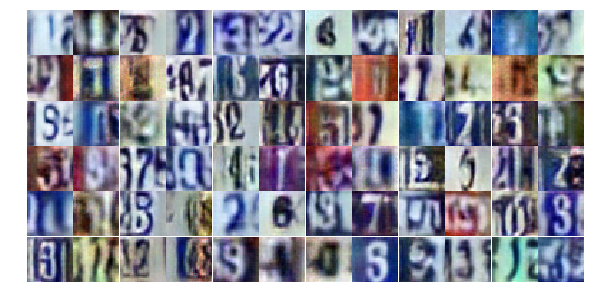

Epoch 13/25... Discriminator Loss: 0.4012... Generator Loss: 2.0187
Epoch 13/25... Discriminator Loss: 1.4697... Generator Loss: 0.3406
Epoch 13/25... Discriminator Loss: 0.5791... Generator Loss: 2.1725
Epoch 13/25... Discriminator Loss: 1.0612... Generator Loss: 0.5277
Epoch 14/25... Discriminator Loss: 0.8555... Generator Loss: 0.7674
Epoch 14/25... Discriminator Loss: 0.9403... Generator Loss: 0.6892
Epoch 14/25... Discriminator Loss: 1.4325... Generator Loss: 0.3685
Epoch 14/25... Discriminator Loss: 0.6549... Generator Loss: 2.5106
Epoch 14/25... Discriminator Loss: 0.5601... Generator Loss: 1.4046
Epoch 14/25... Discriminator Loss: 0.9435... Generator Loss: 0.6891


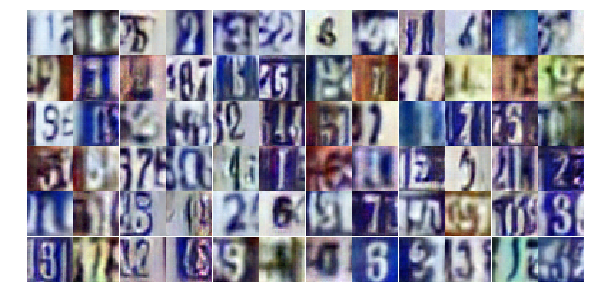

Epoch 14/25... Discriminator Loss: 1.0175... Generator Loss: 2.3539
Epoch 14/25... Discriminator Loss: 0.7541... Generator Loss: 0.8599
Epoch 14/25... Discriminator Loss: 0.7440... Generator Loss: 0.9689
Epoch 14/25... Discriminator Loss: 0.5009... Generator Loss: 1.6695
Epoch 14/25... Discriminator Loss: 1.1675... Generator Loss: 0.5856
Epoch 14/25... Discriminator Loss: 0.4393... Generator Loss: 1.3030
Epoch 14/25... Discriminator Loss: 0.2610... Generator Loss: 2.4401
Epoch 14/25... Discriminator Loss: 1.4586... Generator Loss: 0.3528
Epoch 14/25... Discriminator Loss: 2.4237... Generator Loss: 1.0999
Epoch 14/25... Discriminator Loss: 1.7855... Generator Loss: 0.3181


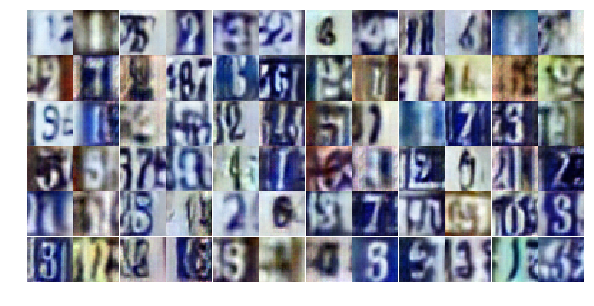

Epoch 14/25... Discriminator Loss: 1.1505... Generator Loss: 0.5531
Epoch 14/25... Discriminator Loss: 0.8541... Generator Loss: 2.3104
Epoch 14/25... Discriminator Loss: 1.0923... Generator Loss: 0.6157
Epoch 14/25... Discriminator Loss: 0.6744... Generator Loss: 1.0653
Epoch 14/25... Discriminator Loss: 0.7928... Generator Loss: 1.0190
Epoch 14/25... Discriminator Loss: 0.7811... Generator Loss: 1.0881
Epoch 14/25... Discriminator Loss: 0.6079... Generator Loss: 1.2071
Epoch 14/25... Discriminator Loss: 0.6950... Generator Loss: 1.0056
Epoch 14/25... Discriminator Loss: 0.6056... Generator Loss: 1.2374
Epoch 14/25... Discriminator Loss: 0.4485... Generator Loss: 1.6378


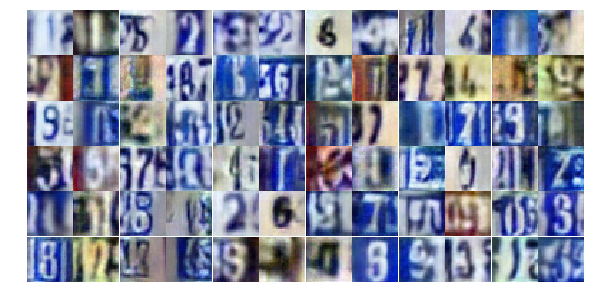

Epoch 14/25... Discriminator Loss: 1.3846... Generator Loss: 0.4117
Epoch 14/25... Discriminator Loss: 0.4344... Generator Loss: 1.7669
Epoch 14/25... Discriminator Loss: 0.4705... Generator Loss: 1.3911
Epoch 14/25... Discriminator Loss: 0.5150... Generator Loss: 1.3207
Epoch 14/25... Discriminator Loss: 0.6513... Generator Loss: 1.1045
Epoch 14/25... Discriminator Loss: 0.4725... Generator Loss: 1.3653
Epoch 14/25... Discriminator Loss: 0.6755... Generator Loss: 1.3221
Epoch 14/25... Discriminator Loss: 0.4466... Generator Loss: 2.0249
Epoch 14/25... Discriminator Loss: 0.3504... Generator Loss: 1.9194
Epoch 14/25... Discriminator Loss: 0.9276... Generator Loss: 1.2387


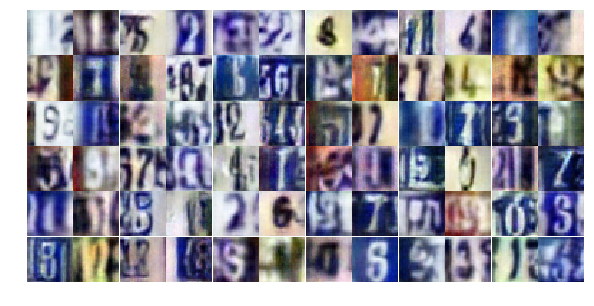

Epoch 14/25... Discriminator Loss: 1.1035... Generator Loss: 0.5694
Epoch 14/25... Discriminator Loss: 0.7515... Generator Loss: 0.9714
Epoch 14/25... Discriminator Loss: 1.0426... Generator Loss: 0.5918
Epoch 14/25... Discriminator Loss: 0.7574... Generator Loss: 0.9623
Epoch 14/25... Discriminator Loss: 0.9217... Generator Loss: 0.6922
Epoch 14/25... Discriminator Loss: 0.9252... Generator Loss: 0.7325
Epoch 14/25... Discriminator Loss: 0.6439... Generator Loss: 1.0677
Epoch 14/25... Discriminator Loss: 0.4822... Generator Loss: 1.3416
Epoch 14/25... Discriminator Loss: 0.8955... Generator Loss: 0.7666
Epoch 14/25... Discriminator Loss: 1.2996... Generator Loss: 0.4228


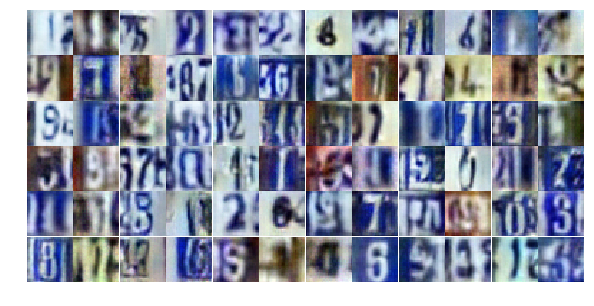

Epoch 14/25... Discriminator Loss: 1.0449... Generator Loss: 1.9330
Epoch 14/25... Discriminator Loss: 1.1259... Generator Loss: 0.5447
Epoch 14/25... Discriminator Loss: 0.6050... Generator Loss: 1.4486
Epoch 14/25... Discriminator Loss: 1.3500... Generator Loss: 0.4176
Epoch 14/25... Discriminator Loss: 0.4679... Generator Loss: 1.4771
Epoch 14/25... Discriminator Loss: 0.7104... Generator Loss: 0.9266
Epoch 14/25... Discriminator Loss: 0.6504... Generator Loss: 1.5670
Epoch 14/25... Discriminator Loss: 0.5341... Generator Loss: 1.6251
Epoch 14/25... Discriminator Loss: 1.2184... Generator Loss: 0.5026
Epoch 14/25... Discriminator Loss: 1.5072... Generator Loss: 0.3361


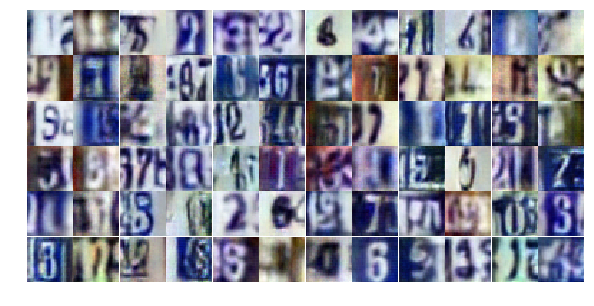

Epoch 14/25... Discriminator Loss: 0.7200... Generator Loss: 1.1665
Epoch 14/25... Discriminator Loss: 1.0599... Generator Loss: 0.6251
Epoch 15/25... Discriminator Loss: 0.5708... Generator Loss: 1.1705
Epoch 15/25... Discriminator Loss: 0.6505... Generator Loss: 1.3891
Epoch 15/25... Discriminator Loss: 0.5832... Generator Loss: 1.4923
Epoch 15/25... Discriminator Loss: 0.9581... Generator Loss: 0.7019
Epoch 15/25... Discriminator Loss: 0.6192... Generator Loss: 1.1022
Epoch 15/25... Discriminator Loss: 0.6013... Generator Loss: 1.2906
Epoch 15/25... Discriminator Loss: 1.5581... Generator Loss: 0.3485
Epoch 15/25... Discriminator Loss: 0.5736... Generator Loss: 1.2043


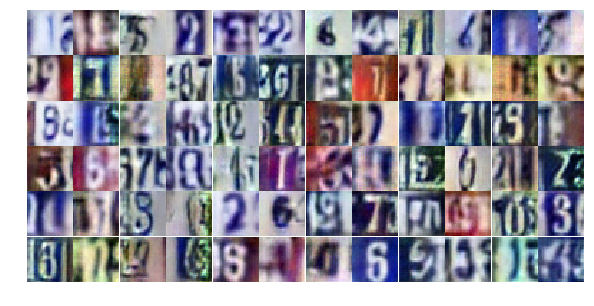

Epoch 15/25... Discriminator Loss: 0.6908... Generator Loss: 0.9617
Epoch 15/25... Discriminator Loss: 0.8292... Generator Loss: 0.9890
Epoch 15/25... Discriminator Loss: 0.8224... Generator Loss: 0.8127
Epoch 15/25... Discriminator Loss: 0.6130... Generator Loss: 1.2913
Epoch 15/25... Discriminator Loss: 1.2581... Generator Loss: 0.4796
Epoch 15/25... Discriminator Loss: 0.5261... Generator Loss: 1.4765
Epoch 15/25... Discriminator Loss: 0.9587... Generator Loss: 0.7163
Epoch 15/25... Discriminator Loss: 0.7354... Generator Loss: 1.9213
Epoch 15/25... Discriminator Loss: 0.8901... Generator Loss: 3.1382
Epoch 15/25... Discriminator Loss: 0.9244... Generator Loss: 0.9097


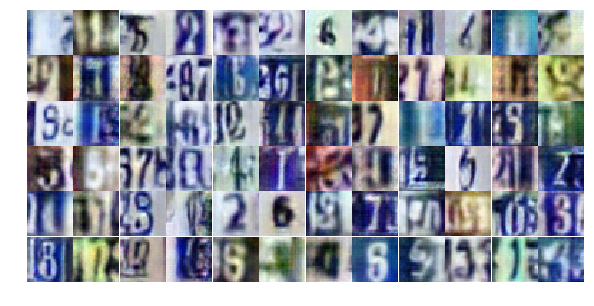

Epoch 15/25... Discriminator Loss: 1.0533... Generator Loss: 0.6581
Epoch 15/25... Discriminator Loss: 0.7430... Generator Loss: 1.1138
Epoch 15/25... Discriminator Loss: 0.4896... Generator Loss: 1.4598
Epoch 15/25... Discriminator Loss: 1.1465... Generator Loss: 0.5094
Epoch 15/25... Discriminator Loss: 0.9596... Generator Loss: 0.7285
Epoch 15/25... Discriminator Loss: 0.6437... Generator Loss: 1.0391
Epoch 15/25... Discriminator Loss: 0.5913... Generator Loss: 1.3205
Epoch 15/25... Discriminator Loss: 0.6344... Generator Loss: 1.0790
Epoch 15/25... Discriminator Loss: 0.5287... Generator Loss: 1.2293
Epoch 15/25... Discriminator Loss: 1.5979... Generator Loss: 0.3517


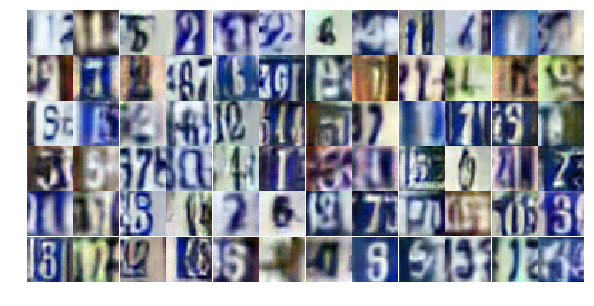

Epoch 15/25... Discriminator Loss: 0.6712... Generator Loss: 1.1230
Epoch 15/25... Discriminator Loss: 0.7984... Generator Loss: 0.8919
Epoch 15/25... Discriminator Loss: 0.4493... Generator Loss: 1.3711
Epoch 15/25... Discriminator Loss: 0.8342... Generator Loss: 0.8689
Epoch 15/25... Discriminator Loss: 0.5609... Generator Loss: 1.4114
Epoch 15/25... Discriminator Loss: 1.4847... Generator Loss: 3.9035
Epoch 15/25... Discriminator Loss: 0.5137... Generator Loss: 1.6584
Epoch 15/25... Discriminator Loss: 0.8055... Generator Loss: 0.8183
Epoch 15/25... Discriminator Loss: 0.6197... Generator Loss: 1.0632
Epoch 15/25... Discriminator Loss: 0.5534... Generator Loss: 1.4158


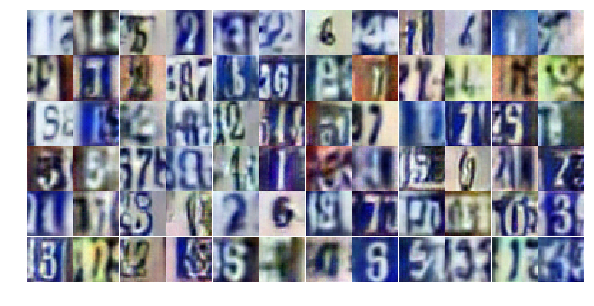

Epoch 15/25... Discriminator Loss: 0.7335... Generator Loss: 0.8942
Epoch 15/25... Discriminator Loss: 1.2512... Generator Loss: 0.4830
Epoch 15/25... Discriminator Loss: 0.6897... Generator Loss: 1.2371
Epoch 15/25... Discriminator Loss: 0.5201... Generator Loss: 1.5094
Epoch 15/25... Discriminator Loss: 0.4952... Generator Loss: 1.3421
Epoch 15/25... Discriminator Loss: 1.8252... Generator Loss: 0.3165
Epoch 15/25... Discriminator Loss: 0.5705... Generator Loss: 1.4131
Epoch 15/25... Discriminator Loss: 0.8994... Generator Loss: 1.9634
Epoch 15/25... Discriminator Loss: 0.7428... Generator Loss: 2.0201
Epoch 15/25... Discriminator Loss: 0.6653... Generator Loss: 1.3094


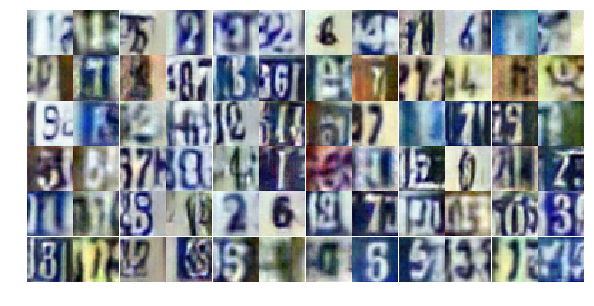

Epoch 15/25... Discriminator Loss: 0.7904... Generator Loss: 0.8360
Epoch 15/25... Discriminator Loss: 0.7820... Generator Loss: 1.0059
Epoch 15/25... Discriminator Loss: 0.4985... Generator Loss: 1.4080
Epoch 15/25... Discriminator Loss: 1.1218... Generator Loss: 0.6761
Epoch 15/25... Discriminator Loss: 0.7894... Generator Loss: 2.2881
Epoch 15/25... Discriminator Loss: 0.7598... Generator Loss: 1.0018
Epoch 15/25... Discriminator Loss: 0.9028... Generator Loss: 0.8060
Epoch 15/25... Discriminator Loss: 0.4648... Generator Loss: 2.1039
Epoch 15/25... Discriminator Loss: 1.4316... Generator Loss: 0.4331
Epoch 16/25... Discriminator Loss: 0.9706... Generator Loss: 0.6617


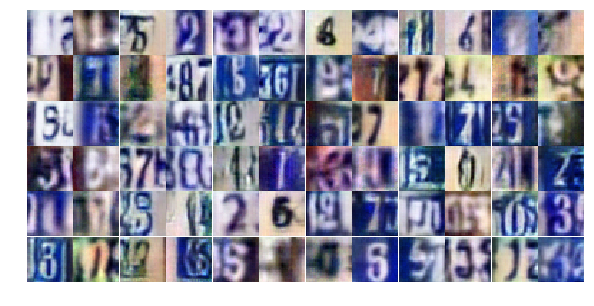

Epoch 16/25... Discriminator Loss: 0.6238... Generator Loss: 1.1030
Epoch 16/25... Discriminator Loss: 0.8639... Generator Loss: 0.7812
Epoch 16/25... Discriminator Loss: 0.7481... Generator Loss: 0.9636
Epoch 16/25... Discriminator Loss: 0.9386... Generator Loss: 0.7417
Epoch 16/25... Discriminator Loss: 0.5527... Generator Loss: 2.1333
Epoch 16/25... Discriminator Loss: 0.8121... Generator Loss: 1.3450
Epoch 16/25... Discriminator Loss: 1.1992... Generator Loss: 0.5718
Epoch 16/25... Discriminator Loss: 0.8713... Generator Loss: 0.7978
Epoch 16/25... Discriminator Loss: 0.4400... Generator Loss: 1.4050
Epoch 16/25... Discriminator Loss: 0.5114... Generator Loss: 1.2040


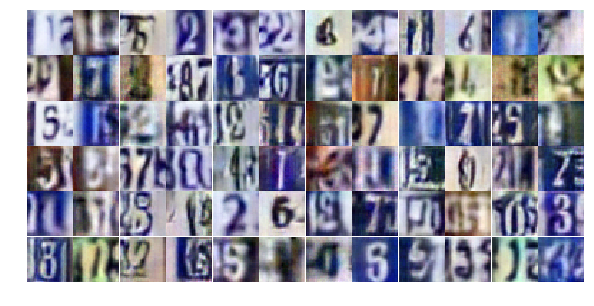

Epoch 16/25... Discriminator Loss: 1.3285... Generator Loss: 0.4588
Epoch 16/25... Discriminator Loss: 0.6610... Generator Loss: 1.2741
Epoch 16/25... Discriminator Loss: 0.5570... Generator Loss: 1.3052
Epoch 16/25... Discriminator Loss: 0.7916... Generator Loss: 0.8506
Epoch 16/25... Discriminator Loss: 0.4645... Generator Loss: 1.5448
Epoch 16/25... Discriminator Loss: 0.6204... Generator Loss: 1.1447
Epoch 16/25... Discriminator Loss: 1.8760... Generator Loss: 0.2854
Epoch 16/25... Discriminator Loss: 1.0169... Generator Loss: 1.1706
Epoch 16/25... Discriminator Loss: 0.5088... Generator Loss: 1.3841
Epoch 16/25... Discriminator Loss: 0.5769... Generator Loss: 1.2667


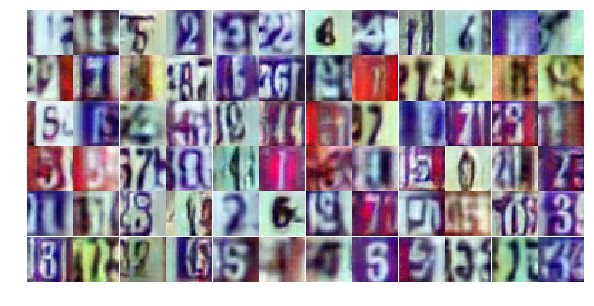

Epoch 16/25... Discriminator Loss: 0.7500... Generator Loss: 1.1667
Epoch 16/25... Discriminator Loss: 0.7812... Generator Loss: 1.1085
Epoch 16/25... Discriminator Loss: 0.8774... Generator Loss: 0.7649
Epoch 16/25... Discriminator Loss: 1.5470... Generator Loss: 0.3289
Epoch 16/25... Discriminator Loss: 0.7658... Generator Loss: 1.1198
Epoch 16/25... Discriminator Loss: 0.7880... Generator Loss: 0.8128
Epoch 16/25... Discriminator Loss: 0.7540... Generator Loss: 0.8921
Epoch 16/25... Discriminator Loss: 0.4995... Generator Loss: 1.3793
Epoch 16/25... Discriminator Loss: 0.9742... Generator Loss: 0.7866
Epoch 16/25... Discriminator Loss: 0.6277... Generator Loss: 1.1384


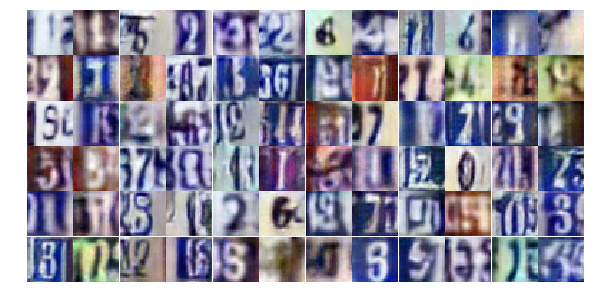

Epoch 16/25... Discriminator Loss: 0.5955... Generator Loss: 1.1382
Epoch 16/25... Discriminator Loss: 0.5571... Generator Loss: 1.1940
Epoch 16/25... Discriminator Loss: 0.7192... Generator Loss: 0.9648
Epoch 16/25... Discriminator Loss: 1.2265... Generator Loss: 0.6472
Epoch 16/25... Discriminator Loss: 0.8678... Generator Loss: 1.1007
Epoch 16/25... Discriminator Loss: 0.8397... Generator Loss: 1.9049
Epoch 16/25... Discriminator Loss: 0.8275... Generator Loss: 0.8621
Epoch 16/25... Discriminator Loss: 0.8819... Generator Loss: 0.7233
Epoch 16/25... Discriminator Loss: 0.9750... Generator Loss: 0.6591
Epoch 16/25... Discriminator Loss: 0.4088... Generator Loss: 2.0187


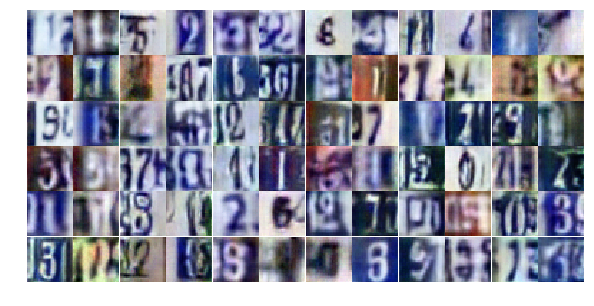

Epoch 16/25... Discriminator Loss: 0.6206... Generator Loss: 1.1259
Epoch 16/25... Discriminator Loss: 0.6913... Generator Loss: 2.0090
Epoch 16/25... Discriminator Loss: 1.2604... Generator Loss: 0.4375
Epoch 16/25... Discriminator Loss: 1.8500... Generator Loss: 0.6064
Epoch 16/25... Discriminator Loss: 0.9075... Generator Loss: 1.1716
Epoch 16/25... Discriminator Loss: 1.3588... Generator Loss: 0.4761
Epoch 16/25... Discriminator Loss: 0.6242... Generator Loss: 1.5321
Epoch 16/25... Discriminator Loss: 0.9604... Generator Loss: 0.7056
Epoch 16/25... Discriminator Loss: 0.5685... Generator Loss: 1.2393
Epoch 16/25... Discriminator Loss: 0.9123... Generator Loss: 0.7288


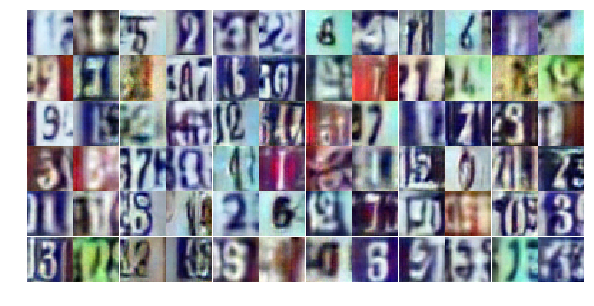

Epoch 16/25... Discriminator Loss: 1.0375... Generator Loss: 0.6325
Epoch 16/25... Discriminator Loss: 0.5976... Generator Loss: 1.4541
Epoch 16/25... Discriminator Loss: 1.2678... Generator Loss: 0.5227
Epoch 16/25... Discriminator Loss: 0.7551... Generator Loss: 0.8549
Epoch 16/25... Discriminator Loss: 0.5394... Generator Loss: 1.3918
Epoch 16/25... Discriminator Loss: 0.7431... Generator Loss: 0.8895
Epoch 17/25... Discriminator Loss: 0.5838... Generator Loss: 1.3305
Epoch 17/25... Discriminator Loss: 0.7939... Generator Loss: 1.0718
Epoch 17/25... Discriminator Loss: 0.6608... Generator Loss: 1.2058
Epoch 17/25... Discriminator Loss: 0.9015... Generator Loss: 0.7199


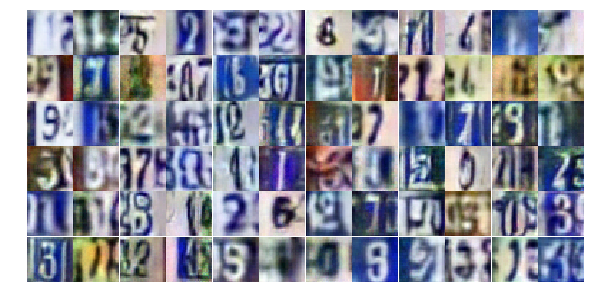

Epoch 17/25... Discriminator Loss: 0.4835... Generator Loss: 1.3756
Epoch 17/25... Discriminator Loss: 0.4685... Generator Loss: 1.4223
Epoch 17/25... Discriminator Loss: 1.2660... Generator Loss: 0.4952
Epoch 17/25... Discriminator Loss: 0.6967... Generator Loss: 1.0215
Epoch 17/25... Discriminator Loss: 0.9420... Generator Loss: 0.6718
Epoch 17/25... Discriminator Loss: 0.9235... Generator Loss: 0.9105
Epoch 17/25... Discriminator Loss: 1.0237... Generator Loss: 0.5805
Epoch 17/25... Discriminator Loss: 0.7016... Generator Loss: 0.9605
Epoch 17/25... Discriminator Loss: 0.4515... Generator Loss: 1.7144
Epoch 17/25... Discriminator Loss: 0.6943... Generator Loss: 1.4765


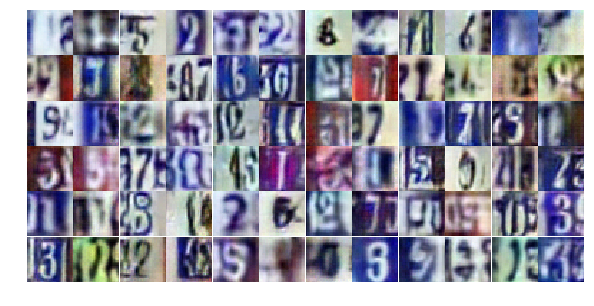

Epoch 17/25... Discriminator Loss: 0.8144... Generator Loss: 1.0528
Epoch 17/25... Discriminator Loss: 0.7151... Generator Loss: 1.6674
Epoch 17/25... Discriminator Loss: 0.7471... Generator Loss: 0.8845
Epoch 17/25... Discriminator Loss: 0.6313... Generator Loss: 1.4686
Epoch 17/25... Discriminator Loss: 0.5756... Generator Loss: 1.2460
Epoch 17/25... Discriminator Loss: 0.8241... Generator Loss: 0.8518
Epoch 17/25... Discriminator Loss: 0.5379... Generator Loss: 1.4895
Epoch 17/25... Discriminator Loss: 0.6613... Generator Loss: 1.0597
Epoch 17/25... Discriminator Loss: 0.7070... Generator Loss: 0.9227
Epoch 17/25... Discriminator Loss: 0.4566... Generator Loss: 1.4524


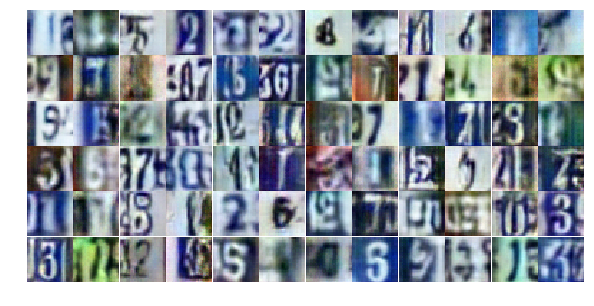

Epoch 17/25... Discriminator Loss: 1.8584... Generator Loss: 0.3019
Epoch 17/25... Discriminator Loss: 0.5038... Generator Loss: 1.4195
Epoch 17/25... Discriminator Loss: 0.5221... Generator Loss: 1.2936
Epoch 17/25... Discriminator Loss: 1.1210... Generator Loss: 0.5434
Epoch 17/25... Discriminator Loss: 1.4534... Generator Loss: 0.4196
Epoch 17/25... Discriminator Loss: 0.6449... Generator Loss: 1.0758
Epoch 17/25... Discriminator Loss: 0.6118... Generator Loss: 1.2404
Epoch 17/25... Discriminator Loss: 0.7886... Generator Loss: 0.8112
Epoch 17/25... Discriminator Loss: 0.8030... Generator Loss: 1.1641
Epoch 17/25... Discriminator Loss: 0.4624... Generator Loss: 1.5440


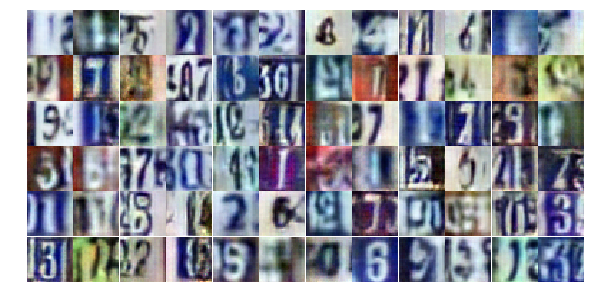

Epoch 17/25... Discriminator Loss: 0.5937... Generator Loss: 1.2274
Epoch 17/25... Discriminator Loss: 1.2008... Generator Loss: 0.5571
Epoch 17/25... Discriminator Loss: 0.6046... Generator Loss: 1.6754
Epoch 17/25... Discriminator Loss: 0.9255... Generator Loss: 0.6910
Epoch 17/25... Discriminator Loss: 1.1822... Generator Loss: 0.4944
Epoch 17/25... Discriminator Loss: 0.6889... Generator Loss: 1.0107
Epoch 17/25... Discriminator Loss: 0.6674... Generator Loss: 1.1613
Epoch 17/25... Discriminator Loss: 0.6989... Generator Loss: 0.9457
Epoch 17/25... Discriminator Loss: 0.3969... Generator Loss: 1.6594
Epoch 17/25... Discriminator Loss: 1.3663... Generator Loss: 0.4498


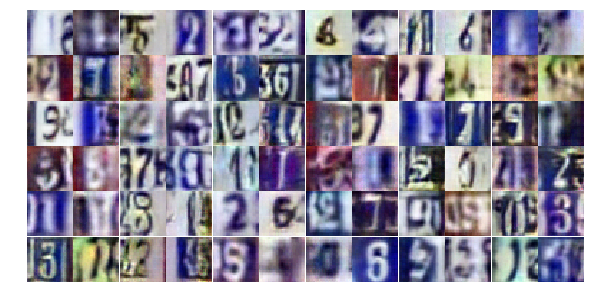

Epoch 17/25... Discriminator Loss: 1.8782... Generator Loss: 3.1106
Epoch 17/25... Discriminator Loss: 0.6957... Generator Loss: 1.3472
Epoch 17/25... Discriminator Loss: 3.0241... Generator Loss: 0.2287
Epoch 17/25... Discriminator Loss: 0.6504... Generator Loss: 1.9281
Epoch 17/25... Discriminator Loss: 0.9009... Generator Loss: 0.8541
Epoch 17/25... Discriminator Loss: 1.0510... Generator Loss: 0.6679
Epoch 17/25... Discriminator Loss: 1.1224... Generator Loss: 0.5682
Epoch 17/25... Discriminator Loss: 0.8334... Generator Loss: 0.9169
Epoch 17/25... Discriminator Loss: 0.6745... Generator Loss: 1.3253
Epoch 17/25... Discriminator Loss: 1.0038... Generator Loss: 0.6509


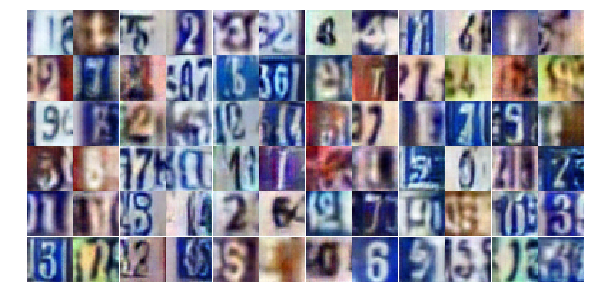

Epoch 17/25... Discriminator Loss: 0.9316... Generator Loss: 0.6969
Epoch 17/25... Discriminator Loss: 1.0740... Generator Loss: 0.6651
Epoch 17/25... Discriminator Loss: 0.6069... Generator Loss: 1.2222
Epoch 17/25... Discriminator Loss: 0.6380... Generator Loss: 1.1310
Epoch 18/25... Discriminator Loss: 1.1716... Generator Loss: 0.5383
Epoch 18/25... Discriminator Loss: 0.8445... Generator Loss: 0.8545
Epoch 18/25... Discriminator Loss: 0.7812... Generator Loss: 0.9487
Epoch 18/25... Discriminator Loss: 0.6789... Generator Loss: 1.1659
Epoch 18/25... Discriminator Loss: 1.0188... Generator Loss: 0.6437
Epoch 18/25... Discriminator Loss: 0.7245... Generator Loss: 1.0238


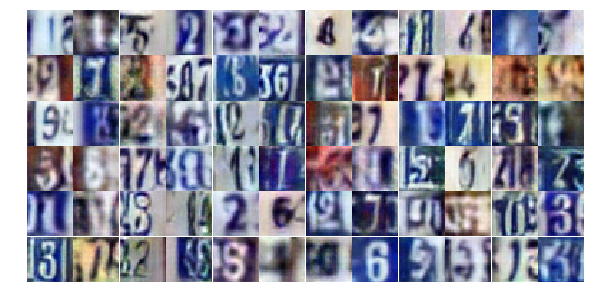

Epoch 18/25... Discriminator Loss: 0.4522... Generator Loss: 1.6968
Epoch 18/25... Discriminator Loss: 1.2328... Generator Loss: 0.5109
Epoch 18/25... Discriminator Loss: 0.8602... Generator Loss: 0.8162
Epoch 18/25... Discriminator Loss: 0.4082... Generator Loss: 1.8717
Epoch 18/25... Discriminator Loss: 0.7912... Generator Loss: 0.8896
Epoch 18/25... Discriminator Loss: 0.7635... Generator Loss: 0.9495
Epoch 18/25... Discriminator Loss: 0.6541... Generator Loss: 1.0529
Epoch 18/25... Discriminator Loss: 0.8126... Generator Loss: 0.8078
Epoch 18/25... Discriminator Loss: 0.5763... Generator Loss: 1.3308
Epoch 18/25... Discriminator Loss: 0.4378... Generator Loss: 1.4409


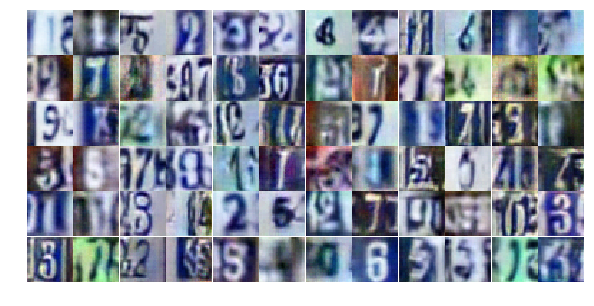

Epoch 18/25... Discriminator Loss: 0.7598... Generator Loss: 0.9033
Epoch 18/25... Discriminator Loss: 0.8774... Generator Loss: 1.0715
Epoch 18/25... Discriminator Loss: 0.9248... Generator Loss: 0.8658
Epoch 18/25... Discriminator Loss: 0.5442... Generator Loss: 1.2867
Epoch 18/25... Discriminator Loss: 0.7425... Generator Loss: 0.8814
Epoch 18/25... Discriminator Loss: 1.1857... Generator Loss: 0.5537
Epoch 18/25... Discriminator Loss: 0.6880... Generator Loss: 1.2672
Epoch 18/25... Discriminator Loss: 1.0156... Generator Loss: 0.6148
Epoch 18/25... Discriminator Loss: 0.7827... Generator Loss: 0.9162
Epoch 18/25... Discriminator Loss: 0.4719... Generator Loss: 1.4279


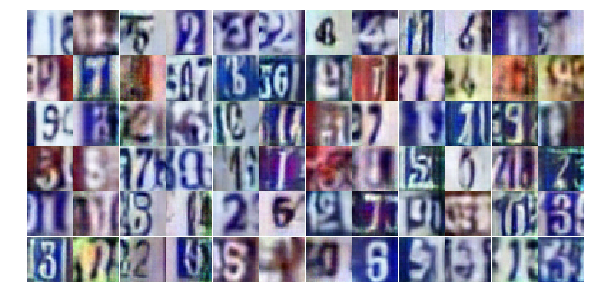

Epoch 18/25... Discriminator Loss: 0.5164... Generator Loss: 1.3135
Epoch 18/25... Discriminator Loss: 0.8088... Generator Loss: 0.8797
Epoch 18/25... Discriminator Loss: 0.6970... Generator Loss: 1.0208
Epoch 18/25... Discriminator Loss: 0.6801... Generator Loss: 1.1870
Epoch 18/25... Discriminator Loss: 1.2185... Generator Loss: 0.5621
Epoch 18/25... Discriminator Loss: 0.6607... Generator Loss: 1.0782
Epoch 18/25... Discriminator Loss: 0.8835... Generator Loss: 0.7722
Epoch 18/25... Discriminator Loss: 0.7066... Generator Loss: 1.0001
Epoch 18/25... Discriminator Loss: 0.9003... Generator Loss: 0.8280
Epoch 18/25... Discriminator Loss: 0.8187... Generator Loss: 0.8979


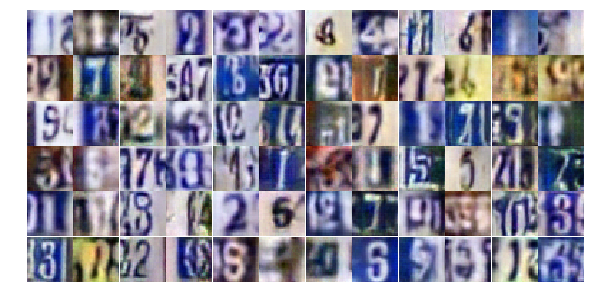

Epoch 18/25... Discriminator Loss: 0.5401... Generator Loss: 1.4160
Epoch 18/25... Discriminator Loss: 0.9250... Generator Loss: 1.1602
Epoch 18/25... Discriminator Loss: 0.8759... Generator Loss: 0.7663
Epoch 18/25... Discriminator Loss: 0.7558... Generator Loss: 0.8550
Epoch 18/25... Discriminator Loss: 0.8415... Generator Loss: 0.8232
Epoch 18/25... Discriminator Loss: 0.5506... Generator Loss: 1.1674
Epoch 18/25... Discriminator Loss: 1.3999... Generator Loss: 0.4761
Epoch 18/25... Discriminator Loss: 1.4280... Generator Loss: 2.6286
Epoch 18/25... Discriminator Loss: 1.1926... Generator Loss: 0.5998
Epoch 18/25... Discriminator Loss: 0.4029... Generator Loss: 1.6899


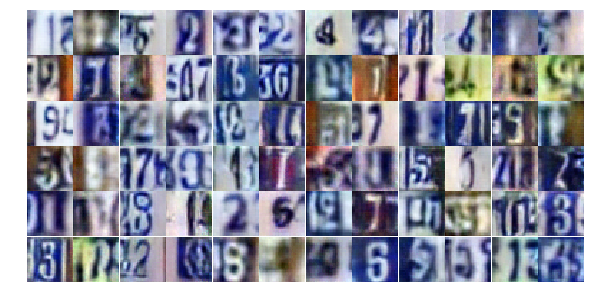

Epoch 18/25... Discriminator Loss: 0.6495... Generator Loss: 1.3072
Epoch 18/25... Discriminator Loss: 0.7307... Generator Loss: 1.0656
Epoch 18/25... Discriminator Loss: 0.6284... Generator Loss: 1.3350
Epoch 18/25... Discriminator Loss: 0.9588... Generator Loss: 0.8101
Epoch 18/25... Discriminator Loss: 0.7120... Generator Loss: 1.0893
Epoch 18/25... Discriminator Loss: 0.5586... Generator Loss: 1.3186
Epoch 18/25... Discriminator Loss: 0.5405... Generator Loss: 1.4105
Epoch 18/25... Discriminator Loss: 0.5518... Generator Loss: 1.3389
Epoch 18/25... Discriminator Loss: 0.8246... Generator Loss: 1.2333
Epoch 18/25... Discriminator Loss: 0.7171... Generator Loss: 0.9112


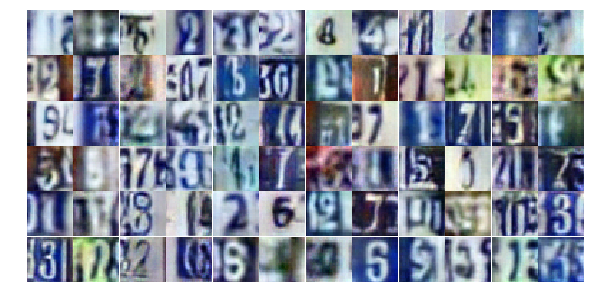

Epoch 18/25... Discriminator Loss: 0.6954... Generator Loss: 2.1868
Epoch 19/25... Discriminator Loss: 1.0365... Generator Loss: 0.7104
Epoch 19/25... Discriminator Loss: 1.4630... Generator Loss: 0.3897
Epoch 19/25... Discriminator Loss: 0.9234... Generator Loss: 0.7540
Epoch 19/25... Discriminator Loss: 0.6487... Generator Loss: 1.0483
Epoch 19/25... Discriminator Loss: 0.9861... Generator Loss: 0.6616
Epoch 19/25... Discriminator Loss: 0.7229... Generator Loss: 1.0177
Epoch 19/25... Discriminator Loss: 1.1155... Generator Loss: 0.6304
Epoch 19/25... Discriminator Loss: 0.7774... Generator Loss: 2.1324
Epoch 19/25... Discriminator Loss: 1.2179... Generator Loss: 0.4743


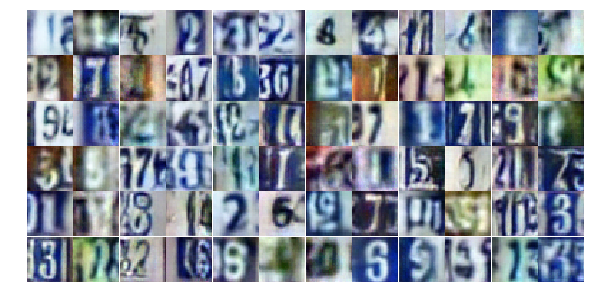

Epoch 19/25... Discriminator Loss: 0.7493... Generator Loss: 0.8924
Epoch 19/25... Discriminator Loss: 0.9737... Generator Loss: 0.6456
Epoch 19/25... Discriminator Loss: 0.6466... Generator Loss: 1.6754
Epoch 19/25... Discriminator Loss: 1.3133... Generator Loss: 0.4353
Epoch 19/25... Discriminator Loss: 1.2944... Generator Loss: 0.4375
Epoch 19/25... Discriminator Loss: 0.7550... Generator Loss: 1.7126
Epoch 19/25... Discriminator Loss: 1.2392... Generator Loss: 0.5088
Epoch 19/25... Discriminator Loss: 0.6872... Generator Loss: 1.0439
Epoch 19/25... Discriminator Loss: 1.0876... Generator Loss: 1.2662
Epoch 19/25... Discriminator Loss: 1.3450... Generator Loss: 0.4548


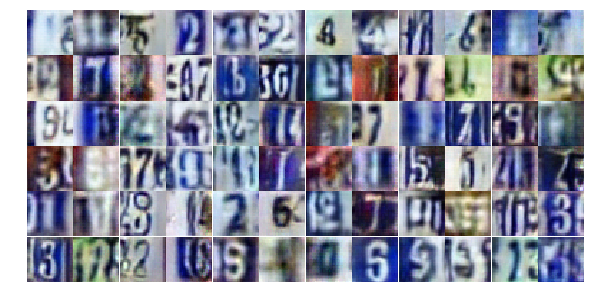

Epoch 19/25... Discriminator Loss: 0.6018... Generator Loss: 1.2438
Epoch 19/25... Discriminator Loss: 0.8262... Generator Loss: 1.0616
Epoch 19/25... Discriminator Loss: 1.5018... Generator Loss: 0.3838
Epoch 19/25... Discriminator Loss: 0.9286... Generator Loss: 0.7911
Epoch 19/25... Discriminator Loss: 0.9160... Generator Loss: 0.7624
Epoch 19/25... Discriminator Loss: 0.7297... Generator Loss: 1.2376
Epoch 19/25... Discriminator Loss: 0.9400... Generator Loss: 0.7702
Epoch 19/25... Discriminator Loss: 0.6378... Generator Loss: 1.0262
Epoch 19/25... Discriminator Loss: 0.8585... Generator Loss: 0.7446
Epoch 19/25... Discriminator Loss: 1.0777... Generator Loss: 0.6300


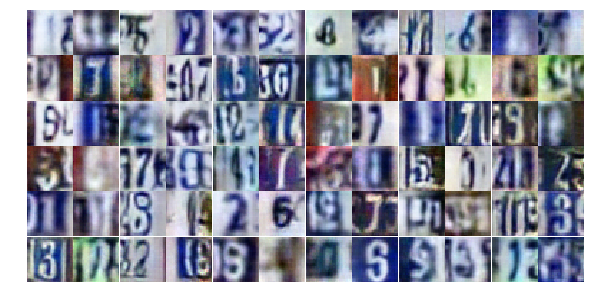

Epoch 19/25... Discriminator Loss: 0.7521... Generator Loss: 1.0327
Epoch 19/25... Discriminator Loss: 0.6810... Generator Loss: 0.9612
Epoch 19/25... Discriminator Loss: 0.7951... Generator Loss: 0.9163
Epoch 19/25... Discriminator Loss: 0.5921... Generator Loss: 1.1077
Epoch 19/25... Discriminator Loss: 0.6439... Generator Loss: 1.2141
Epoch 19/25... Discriminator Loss: 1.6949... Generator Loss: 0.3208
Epoch 19/25... Discriminator Loss: 0.7532... Generator Loss: 1.2500
Epoch 19/25... Discriminator Loss: 0.6245... Generator Loss: 1.2591
Epoch 19/25... Discriminator Loss: 0.8924... Generator Loss: 0.7593
Epoch 19/25... Discriminator Loss: 0.7496... Generator Loss: 0.8707


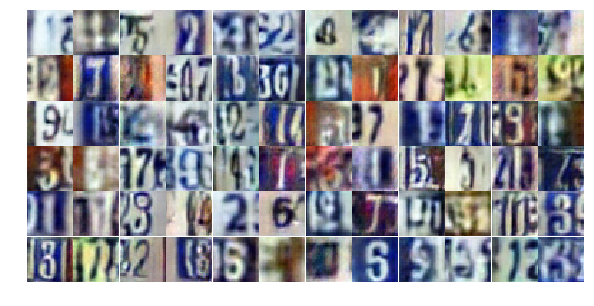

Epoch 19/25... Discriminator Loss: 0.5721... Generator Loss: 1.1511
Epoch 19/25... Discriminator Loss: 0.7247... Generator Loss: 1.0755
Epoch 19/25... Discriminator Loss: 1.2060... Generator Loss: 0.5115
Epoch 19/25... Discriminator Loss: 0.6583... Generator Loss: 1.0854
Epoch 19/25... Discriminator Loss: 0.7767... Generator Loss: 1.2656
Epoch 19/25... Discriminator Loss: 0.8216... Generator Loss: 2.1071
Epoch 19/25... Discriminator Loss: 0.8499... Generator Loss: 0.8573
Epoch 19/25... Discriminator Loss: 0.5801... Generator Loss: 1.3352
Epoch 19/25... Discriminator Loss: 0.9071... Generator Loss: 0.8495
Epoch 19/25... Discriminator Loss: 1.3685... Generator Loss: 0.4689


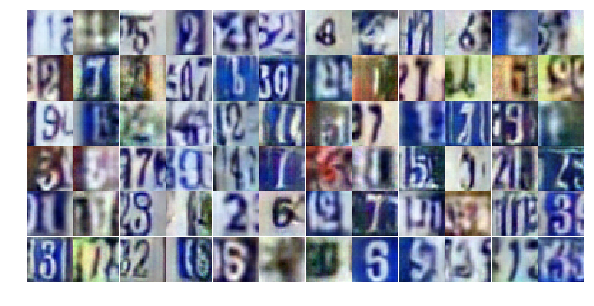

Epoch 19/25... Discriminator Loss: 0.9942... Generator Loss: 0.6551
Epoch 19/25... Discriminator Loss: 0.5283... Generator Loss: 2.0479
Epoch 19/25... Discriminator Loss: 0.7298... Generator Loss: 1.2337
Epoch 19/25... Discriminator Loss: 0.9658... Generator Loss: 0.6555
Epoch 19/25... Discriminator Loss: 1.1064... Generator Loss: 0.5958
Epoch 19/25... Discriminator Loss: 0.7335... Generator Loss: 1.0092
Epoch 19/25... Discriminator Loss: 2.5092... Generator Loss: 0.1215
Epoch 19/25... Discriminator Loss: 2.1723... Generator Loss: 1.9747
Epoch 20/25... Discriminator Loss: 0.8407... Generator Loss: 1.1424
Epoch 20/25... Discriminator Loss: 0.7780... Generator Loss: 1.0307


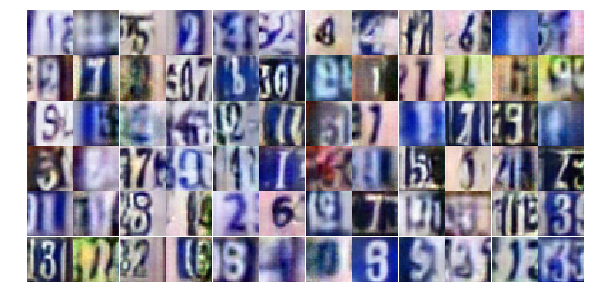

Epoch 20/25... Discriminator Loss: 0.8625... Generator Loss: 0.8295
Epoch 20/25... Discriminator Loss: 1.0284... Generator Loss: 0.7161
Epoch 20/25... Discriminator Loss: 1.1931... Generator Loss: 0.5291
Epoch 20/25... Discriminator Loss: 0.7860... Generator Loss: 0.8580
Epoch 20/25... Discriminator Loss: 0.5224... Generator Loss: 1.4321
Epoch 20/25... Discriminator Loss: 0.6417... Generator Loss: 1.1360
Epoch 20/25... Discriminator Loss: 0.6531... Generator Loss: 1.3159
Epoch 20/25... Discriminator Loss: 0.7620... Generator Loss: 1.0030
Epoch 20/25... Discriminator Loss: 1.1875... Generator Loss: 0.4979
Epoch 20/25... Discriminator Loss: 0.9337... Generator Loss: 0.7074


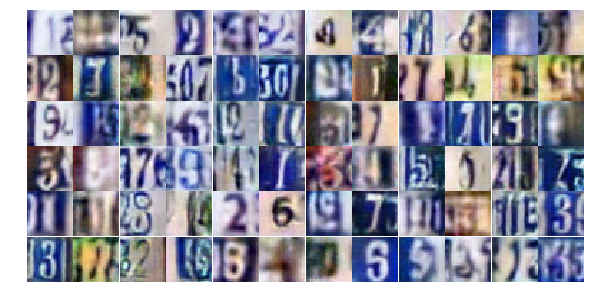

Epoch 20/25... Discriminator Loss: 1.2221... Generator Loss: 0.4804
Epoch 20/25... Discriminator Loss: 0.9725... Generator Loss: 0.7862
Epoch 20/25... Discriminator Loss: 0.6528... Generator Loss: 1.0605
Epoch 20/25... Discriminator Loss: 0.7253... Generator Loss: 1.0526
Epoch 20/25... Discriminator Loss: 0.6567... Generator Loss: 1.0341
Epoch 20/25... Discriminator Loss: 1.2549... Generator Loss: 0.4865
Epoch 20/25... Discriminator Loss: 0.8817... Generator Loss: 0.8131
Epoch 20/25... Discriminator Loss: 0.8505... Generator Loss: 0.7664
Epoch 20/25... Discriminator Loss: 0.8640... Generator Loss: 0.7667
Epoch 20/25... Discriminator Loss: 1.2721... Generator Loss: 0.4943


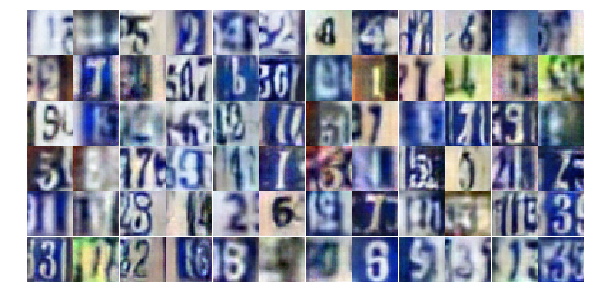

Epoch 20/25... Discriminator Loss: 0.4990... Generator Loss: 1.3271
Epoch 20/25... Discriminator Loss: 0.8126... Generator Loss: 0.8900
Epoch 20/25... Discriminator Loss: 0.3461... Generator Loss: 1.7467
Epoch 20/25... Discriminator Loss: 1.4268... Generator Loss: 0.3684
Epoch 20/25... Discriminator Loss: 0.7037... Generator Loss: 1.0162
Epoch 20/25... Discriminator Loss: 0.5536... Generator Loss: 1.8513
Epoch 20/25... Discriminator Loss: 0.7195... Generator Loss: 2.2171
Epoch 20/25... Discriminator Loss: 1.6135... Generator Loss: 0.3034
Epoch 20/25... Discriminator Loss: 0.9871... Generator Loss: 0.7112
Epoch 20/25... Discriminator Loss: 0.5669... Generator Loss: 1.1213


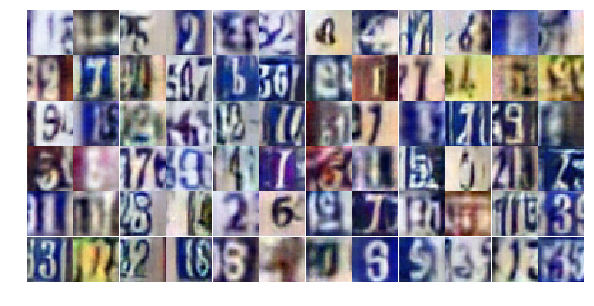

Epoch 20/25... Discriminator Loss: 0.6621... Generator Loss: 1.1541
Epoch 20/25... Discriminator Loss: 0.7559... Generator Loss: 0.9226
Epoch 20/25... Discriminator Loss: 1.2611... Generator Loss: 0.4769
Epoch 20/25... Discriminator Loss: 0.6666... Generator Loss: 1.2668
Epoch 20/25... Discriminator Loss: 0.6497... Generator Loss: 1.2609
Epoch 20/25... Discriminator Loss: 0.7059... Generator Loss: 1.0948
Epoch 20/25... Discriminator Loss: 0.7414... Generator Loss: 1.1638
Epoch 20/25... Discriminator Loss: 1.2914... Generator Loss: 0.4663
Epoch 20/25... Discriminator Loss: 0.6477... Generator Loss: 1.1675
Epoch 20/25... Discriminator Loss: 1.0454... Generator Loss: 0.5959


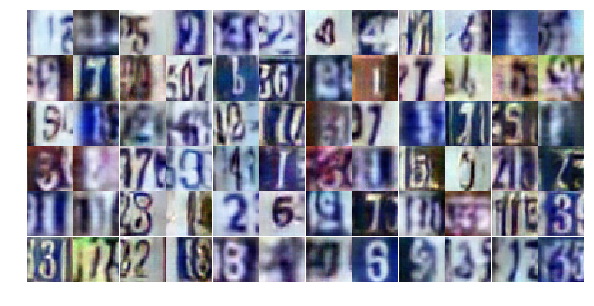

Epoch 20/25... Discriminator Loss: 2.5602... Generator Loss: 0.1466
Epoch 20/25... Discriminator Loss: 1.0404... Generator Loss: 0.8094
Epoch 20/25... Discriminator Loss: 0.7878... Generator Loss: 1.5740
Epoch 20/25... Discriminator Loss: 0.9587... Generator Loss: 0.7590
Epoch 20/25... Discriminator Loss: 1.1880... Generator Loss: 0.5722
Epoch 20/25... Discriminator Loss: 1.0468... Generator Loss: 0.5906
Epoch 20/25... Discriminator Loss: 1.2419... Generator Loss: 0.5326
Epoch 20/25... Discriminator Loss: 0.6310... Generator Loss: 2.0876
Epoch 20/25... Discriminator Loss: 0.8592... Generator Loss: 2.2688
Epoch 20/25... Discriminator Loss: 0.7871... Generator Loss: 0.8750


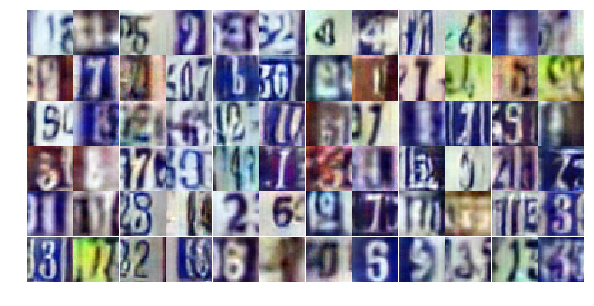

Epoch 20/25... Discriminator Loss: 0.4786... Generator Loss: 1.3947
Epoch 20/25... Discriminator Loss: 1.3238... Generator Loss: 0.4380
Epoch 20/25... Discriminator Loss: 0.5235... Generator Loss: 1.5474
Epoch 20/25... Discriminator Loss: 1.1399... Generator Loss: 0.5884
Epoch 20/25... Discriminator Loss: 0.6324... Generator Loss: 1.2604
Epoch 20/25... Discriminator Loss: 0.4325... Generator Loss: 1.5048
Epoch 21/25... Discriminator Loss: 0.7410... Generator Loss: 1.2893
Epoch 21/25... Discriminator Loss: 1.0449... Generator Loss: 0.6381
Epoch 21/25... Discriminator Loss: 1.1915... Generator Loss: 0.5110
Epoch 21/25... Discriminator Loss: 1.6151... Generator Loss: 0.3136


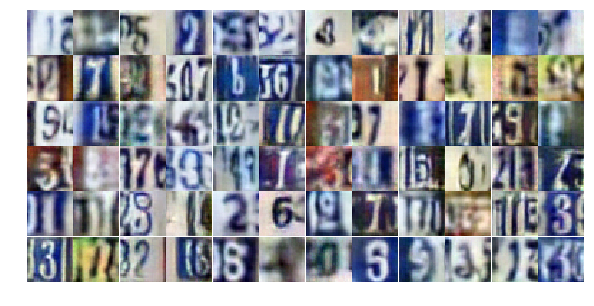

Epoch 21/25... Discriminator Loss: 0.6387... Generator Loss: 1.3041
Epoch 21/25... Discriminator Loss: 1.7676... Generator Loss: 0.2680
Epoch 21/25... Discriminator Loss: 0.5297... Generator Loss: 1.4337
Epoch 21/25... Discriminator Loss: 0.5254... Generator Loss: 1.1699
Epoch 21/25... Discriminator Loss: 0.8022... Generator Loss: 0.8203
Epoch 21/25... Discriminator Loss: 0.7708... Generator Loss: 0.8817
Epoch 21/25... Discriminator Loss: 1.0749... Generator Loss: 0.5847
Epoch 21/25... Discriminator Loss: 0.7995... Generator Loss: 0.9363
Epoch 21/25... Discriminator Loss: 0.6381... Generator Loss: 1.0588
Epoch 21/25... Discriminator Loss: 0.9281... Generator Loss: 0.8033


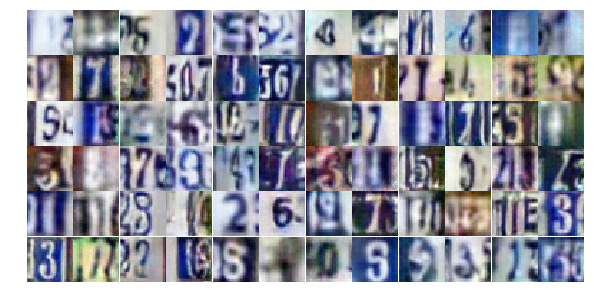

Epoch 21/25... Discriminator Loss: 0.3564... Generator Loss: 1.7131
Epoch 21/25... Discriminator Loss: 0.7247... Generator Loss: 0.9220
Epoch 21/25... Discriminator Loss: 1.6953... Generator Loss: 0.3410
Epoch 21/25... Discriminator Loss: 0.9061... Generator Loss: 0.7712
Epoch 21/25... Discriminator Loss: 0.4959... Generator Loss: 1.5157
Epoch 21/25... Discriminator Loss: 1.6013... Generator Loss: 0.3587
Epoch 21/25... Discriminator Loss: 1.2851... Generator Loss: 0.5041
Epoch 21/25... Discriminator Loss: 0.6776... Generator Loss: 1.2146
Epoch 21/25... Discriminator Loss: 0.9666... Generator Loss: 0.6908
Epoch 21/25... Discriminator Loss: 0.5750... Generator Loss: 1.3104


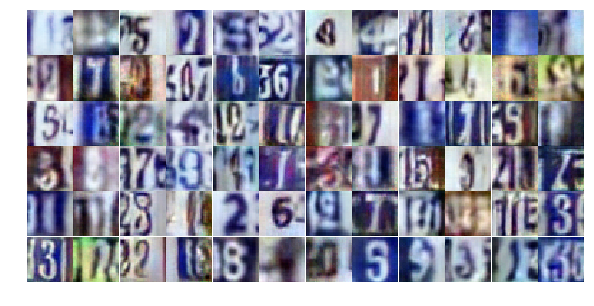

Epoch 21/25... Discriminator Loss: 1.2303... Generator Loss: 0.5195
Epoch 21/25... Discriminator Loss: 0.4435... Generator Loss: 1.5219
Epoch 21/25... Discriminator Loss: 1.5504... Generator Loss: 0.4045
Epoch 21/25... Discriminator Loss: 0.6733... Generator Loss: 0.9947
Epoch 21/25... Discriminator Loss: 1.3254... Generator Loss: 0.4971
Epoch 21/25... Discriminator Loss: 1.1300... Generator Loss: 0.6256
Epoch 21/25... Discriminator Loss: 0.7273... Generator Loss: 0.8271
Epoch 21/25... Discriminator Loss: 1.0813... Generator Loss: 0.5821
Epoch 21/25... Discriminator Loss: 1.5657... Generator Loss: 0.3456
Epoch 21/25... Discriminator Loss: 1.7924... Generator Loss: 0.2962


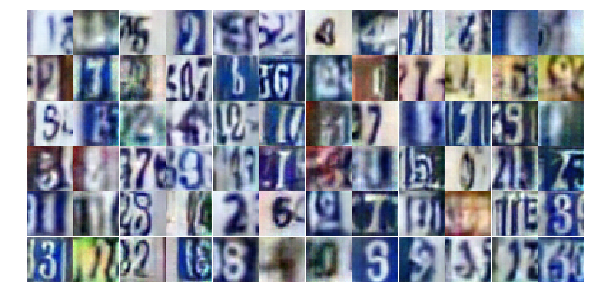

Epoch 21/25... Discriminator Loss: 1.5521... Generator Loss: 0.5685
Epoch 21/25... Discriminator Loss: 0.9614... Generator Loss: 2.8359
Epoch 21/25... Discriminator Loss: 1.2318... Generator Loss: 0.4961
Epoch 21/25... Discriminator Loss: 0.7100... Generator Loss: 0.9754
Epoch 21/25... Discriminator Loss: 0.6425... Generator Loss: 1.0573
Epoch 21/25... Discriminator Loss: 0.6897... Generator Loss: 1.0056
Epoch 21/25... Discriminator Loss: 1.0519... Generator Loss: 0.6179
Epoch 21/25... Discriminator Loss: 1.4950... Generator Loss: 0.4374
Epoch 21/25... Discriminator Loss: 1.0038... Generator Loss: 0.6312
Epoch 21/25... Discriminator Loss: 0.2587... Generator Loss: 2.2207


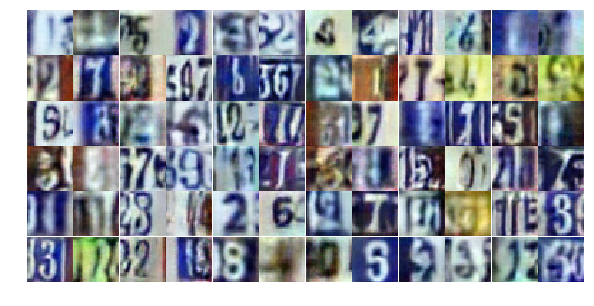

Epoch 21/25... Discriminator Loss: 0.7227... Generator Loss: 0.9710
Epoch 21/25... Discriminator Loss: 1.1806... Generator Loss: 0.5678
Epoch 21/25... Discriminator Loss: 0.6418... Generator Loss: 1.0746
Epoch 21/25... Discriminator Loss: 0.8841... Generator Loss: 0.9376
Epoch 21/25... Discriminator Loss: 0.3755... Generator Loss: 1.7380
Epoch 21/25... Discriminator Loss: 0.6488... Generator Loss: 1.1896
Epoch 21/25... Discriminator Loss: 0.6841... Generator Loss: 1.2861
Epoch 21/25... Discriminator Loss: 0.9822... Generator Loss: 0.7574
Epoch 21/25... Discriminator Loss: 1.5489... Generator Loss: 0.3864
Epoch 21/25... Discriminator Loss: 0.6462... Generator Loss: 1.2874


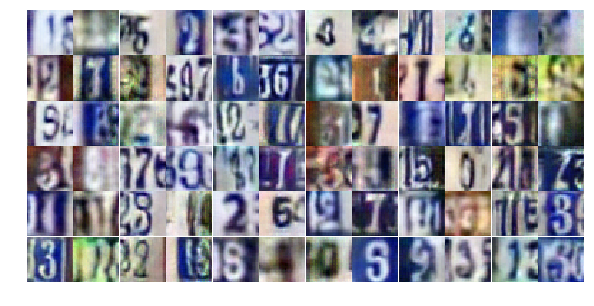

Epoch 21/25... Discriminator Loss: 0.6094... Generator Loss: 1.4038
Epoch 21/25... Discriminator Loss: 0.8489... Generator Loss: 1.6682
Epoch 21/25... Discriminator Loss: 0.6638... Generator Loss: 1.2421
Epoch 22/25... Discriminator Loss: 0.8406... Generator Loss: 0.8623
Epoch 22/25... Discriminator Loss: 1.0957... Generator Loss: 0.6859
Epoch 22/25... Discriminator Loss: 0.8019... Generator Loss: 0.9792
Epoch 22/25... Discriminator Loss: 0.6382... Generator Loss: 1.2027
Epoch 22/25... Discriminator Loss: 0.6869... Generator Loss: 0.9516
Epoch 22/25... Discriminator Loss: 1.3226... Generator Loss: 0.4423
Epoch 22/25... Discriminator Loss: 0.8418... Generator Loss: 0.8046


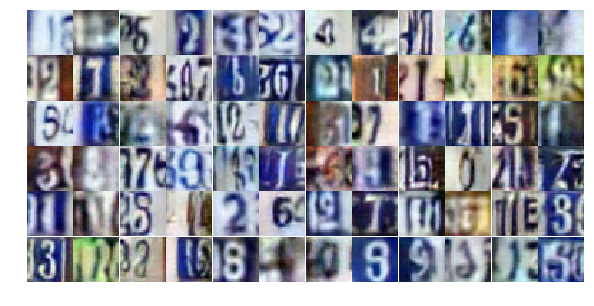

Epoch 22/25... Discriminator Loss: 0.6716... Generator Loss: 1.4101
Epoch 22/25... Discriminator Loss: 0.7676... Generator Loss: 0.9335
Epoch 22/25... Discriminator Loss: 1.4612... Generator Loss: 0.4441
Epoch 22/25... Discriminator Loss: 1.5262... Generator Loss: 0.3459
Epoch 22/25... Discriminator Loss: 0.9278... Generator Loss: 1.6180
Epoch 22/25... Discriminator Loss: 0.8547... Generator Loss: 0.7782
Epoch 22/25... Discriminator Loss: 0.7877... Generator Loss: 0.7870
Epoch 22/25... Discriminator Loss: 0.5531... Generator Loss: 1.7142
Epoch 22/25... Discriminator Loss: 1.3457... Generator Loss: 0.4305
Epoch 22/25... Discriminator Loss: 1.7266... Generator Loss: 0.2943


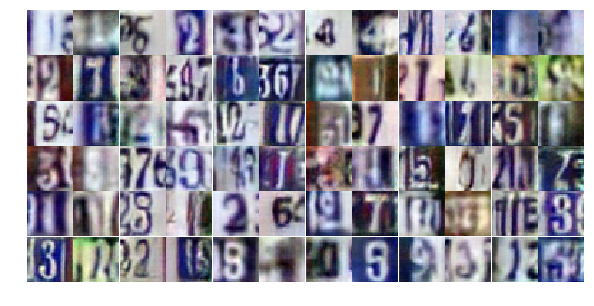

Epoch 22/25... Discriminator Loss: 0.5905... Generator Loss: 1.3824
Epoch 22/25... Discriminator Loss: 0.6406... Generator Loss: 1.0317
Epoch 22/25... Discriminator Loss: 1.2743... Generator Loss: 0.4567
Epoch 22/25... Discriminator Loss: 0.4093... Generator Loss: 1.4656
Epoch 22/25... Discriminator Loss: 0.8922... Generator Loss: 0.7575
Epoch 22/25... Discriminator Loss: 0.5308... Generator Loss: 1.3761
Epoch 22/25... Discriminator Loss: 0.6174... Generator Loss: 1.1923
Epoch 22/25... Discriminator Loss: 0.3756... Generator Loss: 1.9081
Epoch 22/25... Discriminator Loss: 0.8388... Generator Loss: 0.8217
Epoch 22/25... Discriminator Loss: 1.0557... Generator Loss: 0.6898


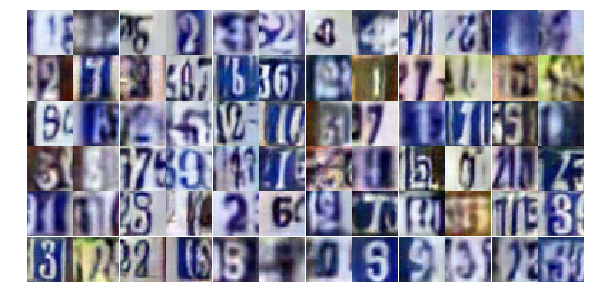

Epoch 22/25... Discriminator Loss: 0.6057... Generator Loss: 1.0914
Epoch 22/25... Discriminator Loss: 0.6512... Generator Loss: 1.1950
Epoch 22/25... Discriminator Loss: 0.7854... Generator Loss: 0.9414
Epoch 22/25... Discriminator Loss: 0.8787... Generator Loss: 0.7470
Epoch 22/25... Discriminator Loss: 0.7895... Generator Loss: 1.0492
Epoch 22/25... Discriminator Loss: 0.9392... Generator Loss: 0.7529
Epoch 22/25... Discriminator Loss: 1.8911... Generator Loss: 0.2390
Epoch 22/25... Discriminator Loss: 0.5824... Generator Loss: 2.5072
Epoch 22/25... Discriminator Loss: 0.9323... Generator Loss: 0.8428
Epoch 22/25... Discriminator Loss: 1.2744... Generator Loss: 0.5393


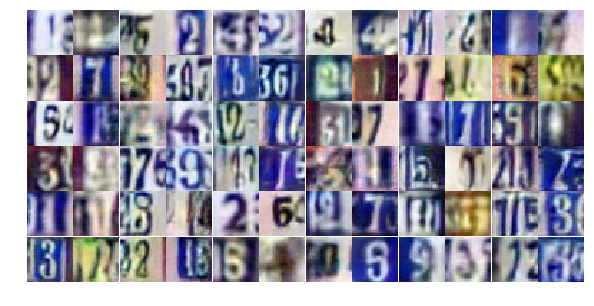

Epoch 22/25... Discriminator Loss: 1.0221... Generator Loss: 0.6758
Epoch 22/25... Discriminator Loss: 0.6400... Generator Loss: 1.1949
Epoch 22/25... Discriminator Loss: 0.3997... Generator Loss: 1.5122
Epoch 22/25... Discriminator Loss: 0.6052... Generator Loss: 1.2137
Epoch 22/25... Discriminator Loss: 0.6400... Generator Loss: 0.9882
Epoch 22/25... Discriminator Loss: 0.4745... Generator Loss: 1.2953
Epoch 22/25... Discriminator Loss: 0.6801... Generator Loss: 1.2272
Epoch 22/25... Discriminator Loss: 0.6349... Generator Loss: 1.2911
Epoch 22/25... Discriminator Loss: 1.0188... Generator Loss: 0.6402
Epoch 22/25... Discriminator Loss: 0.7075... Generator Loss: 1.1578


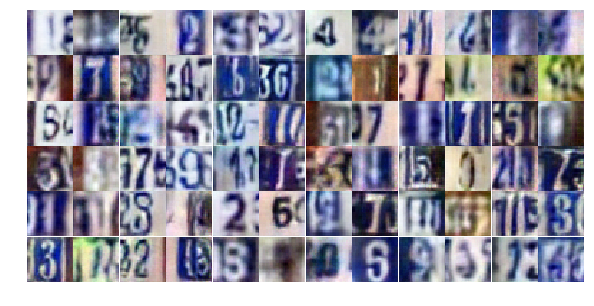

Epoch 22/25... Discriminator Loss: 0.9374... Generator Loss: 0.7401
Epoch 22/25... Discriminator Loss: 0.5579... Generator Loss: 1.3624
Epoch 22/25... Discriminator Loss: 0.9240... Generator Loss: 0.7259
Epoch 22/25... Discriminator Loss: 0.8052... Generator Loss: 0.9887
Epoch 22/25... Discriminator Loss: 0.5798... Generator Loss: 1.3120
Epoch 22/25... Discriminator Loss: 1.1091... Generator Loss: 0.5480
Epoch 22/25... Discriminator Loss: 2.2589... Generator Loss: 0.1791
Epoch 22/25... Discriminator Loss: 0.6563... Generator Loss: 1.1407
Epoch 22/25... Discriminator Loss: 0.9409... Generator Loss: 2.5716
Epoch 22/25... Discriminator Loss: 0.7391... Generator Loss: 1.1460


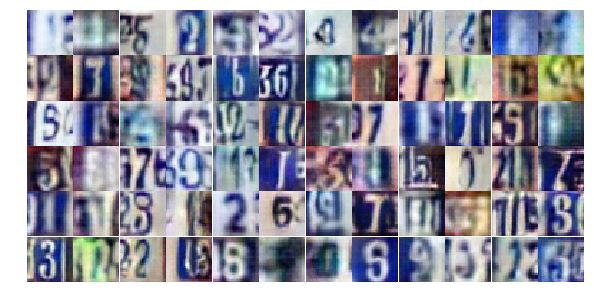

Epoch 23/25... Discriminator Loss: 0.6903... Generator Loss: 1.0788
Epoch 23/25... Discriminator Loss: 0.3962... Generator Loss: 1.8682
Epoch 23/25... Discriminator Loss: 1.1561... Generator Loss: 0.5777
Epoch 23/25... Discriminator Loss: 0.8514... Generator Loss: 2.6715
Epoch 23/25... Discriminator Loss: 0.7663... Generator Loss: 1.5345
Epoch 23/25... Discriminator Loss: 1.1077... Generator Loss: 0.5968
Epoch 23/25... Discriminator Loss: 1.0705... Generator Loss: 0.5751
Epoch 23/25... Discriminator Loss: 0.7657... Generator Loss: 0.9453
Epoch 23/25... Discriminator Loss: 0.6526... Generator Loss: 1.1192
Epoch 23/25... Discriminator Loss: 0.3527... Generator Loss: 2.1705


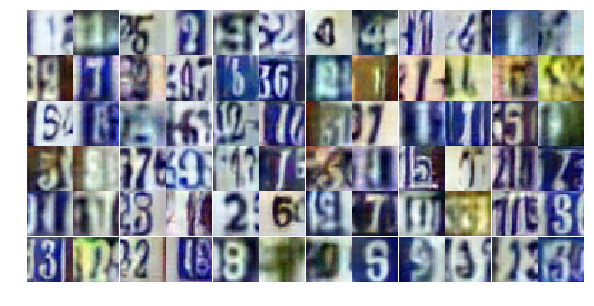

Epoch 23/25... Discriminator Loss: 0.5234... Generator Loss: 1.2445
Epoch 23/25... Discriminator Loss: 0.8223... Generator Loss: 0.7681
Epoch 23/25... Discriminator Loss: 0.8437... Generator Loss: 0.8780
Epoch 23/25... Discriminator Loss: 0.6638... Generator Loss: 1.1491
Epoch 23/25... Discriminator Loss: 0.6191... Generator Loss: 1.1438
Epoch 23/25... Discriminator Loss: 0.8137... Generator Loss: 0.8718
Epoch 23/25... Discriminator Loss: 1.0281... Generator Loss: 0.6704
Epoch 23/25... Discriminator Loss: 0.6136... Generator Loss: 1.1820
Epoch 23/25... Discriminator Loss: 0.8277... Generator Loss: 0.8099
Epoch 23/25... Discriminator Loss: 0.8115... Generator Loss: 0.8063


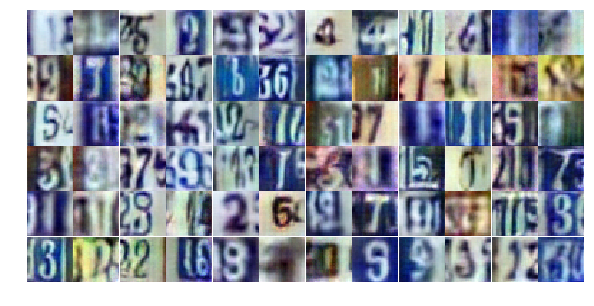

Epoch 23/25... Discriminator Loss: 1.2933... Generator Loss: 0.4795
Epoch 23/25... Discriminator Loss: 0.4620... Generator Loss: 2.5318
Epoch 23/25... Discriminator Loss: 1.2329... Generator Loss: 0.5546
Epoch 23/25... Discriminator Loss: 0.9569... Generator Loss: 0.6736
Epoch 23/25... Discriminator Loss: 0.8214... Generator Loss: 0.8499
Epoch 23/25... Discriminator Loss: 0.7141... Generator Loss: 1.0894
Epoch 23/25... Discriminator Loss: 0.6234... Generator Loss: 1.2607
Epoch 23/25... Discriminator Loss: 0.7043... Generator Loss: 1.0004
Epoch 23/25... Discriminator Loss: 0.9855... Generator Loss: 0.6094
Epoch 23/25... Discriminator Loss: 1.5538... Generator Loss: 0.4002


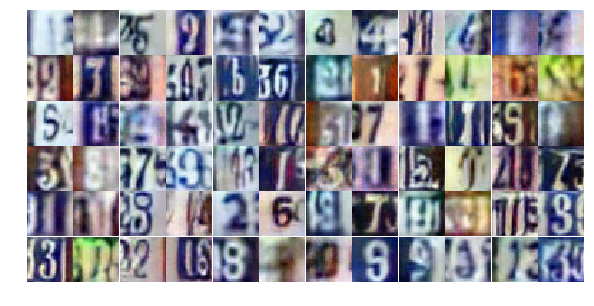

Epoch 23/25... Discriminator Loss: 0.7210... Generator Loss: 0.9811
Epoch 23/25... Discriminator Loss: 0.7401... Generator Loss: 0.9945
Epoch 23/25... Discriminator Loss: 0.6905... Generator Loss: 1.0052
Epoch 23/25... Discriminator Loss: 0.7151... Generator Loss: 1.0478
Epoch 23/25... Discriminator Loss: 0.9649... Generator Loss: 0.8171
Epoch 23/25... Discriminator Loss: 1.6673... Generator Loss: 0.3414
Epoch 23/25... Discriminator Loss: 1.3568... Generator Loss: 0.3968
Epoch 23/25... Discriminator Loss: 0.7364... Generator Loss: 1.0229
Epoch 23/25... Discriminator Loss: 0.6728... Generator Loss: 1.0851
Epoch 23/25... Discriminator Loss: 0.5909... Generator Loss: 2.0608


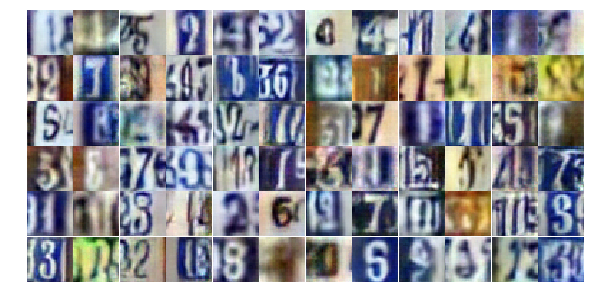

Epoch 23/25... Discriminator Loss: 1.4311... Generator Loss: 0.4212
Epoch 23/25... Discriminator Loss: 0.9543... Generator Loss: 2.8371
Epoch 23/25... Discriminator Loss: 0.8930... Generator Loss: 2.8107
Epoch 23/25... Discriminator Loss: 0.7724... Generator Loss: 1.1161
Epoch 23/25... Discriminator Loss: 0.7419... Generator Loss: 1.1472
Epoch 23/25... Discriminator Loss: 1.0405... Generator Loss: 0.6714
Epoch 23/25... Discriminator Loss: 0.7297... Generator Loss: 0.9647
Epoch 23/25... Discriminator Loss: 0.9600... Generator Loss: 0.7165
Epoch 23/25... Discriminator Loss: 0.9720... Generator Loss: 0.6948
Epoch 23/25... Discriminator Loss: 0.6656... Generator Loss: 1.0847


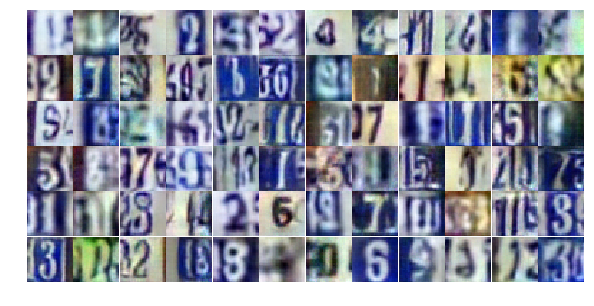

Epoch 23/25... Discriminator Loss: 0.8027... Generator Loss: 0.8938
Epoch 23/25... Discriminator Loss: 0.9219... Generator Loss: 0.7853
Epoch 23/25... Discriminator Loss: 1.7357... Generator Loss: 0.3812
Epoch 23/25... Discriminator Loss: 0.4759... Generator Loss: 1.4005
Epoch 23/25... Discriminator Loss: 1.1909... Generator Loss: 0.5424
Epoch 23/25... Discriminator Loss: 0.5875... Generator Loss: 1.6696
Epoch 23/25... Discriminator Loss: 1.0343... Generator Loss: 0.5900
Epoch 24/25... Discriminator Loss: 0.7386... Generator Loss: 1.0839
Epoch 24/25... Discriminator Loss: 0.8764... Generator Loss: 0.7538
Epoch 24/25... Discriminator Loss: 0.8976... Generator Loss: 1.5293


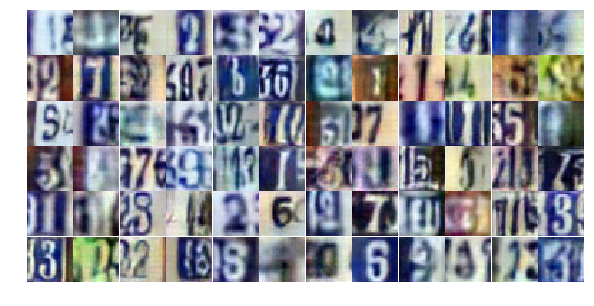

Epoch 24/25... Discriminator Loss: 0.8848... Generator Loss: 0.7805
Epoch 24/25... Discriminator Loss: 0.9919... Generator Loss: 0.6487
Epoch 24/25... Discriminator Loss: 0.6400... Generator Loss: 1.0613
Epoch 24/25... Discriminator Loss: 0.7457... Generator Loss: 1.0127
Epoch 24/25... Discriminator Loss: 0.6267... Generator Loss: 1.1767
Epoch 24/25... Discriminator Loss: 0.6785... Generator Loss: 0.9899
Epoch 24/25... Discriminator Loss: 0.6800... Generator Loss: 1.0230
Epoch 24/25... Discriminator Loss: 1.3859... Generator Loss: 0.4205
Epoch 24/25... Discriminator Loss: 0.3348... Generator Loss: 1.9652
Epoch 24/25... Discriminator Loss: 0.5832... Generator Loss: 1.2609


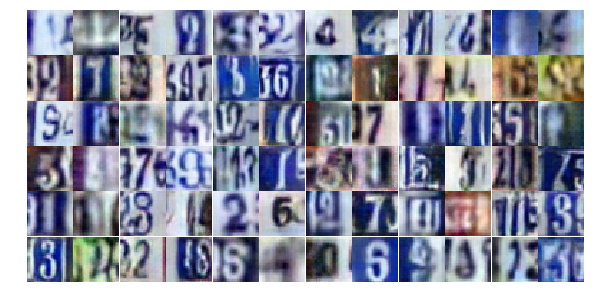

Epoch 24/25... Discriminator Loss: 1.3547... Generator Loss: 0.4543
Epoch 24/25... Discriminator Loss: 1.3064... Generator Loss: 0.4513
Epoch 24/25... Discriminator Loss: 1.1061... Generator Loss: 0.6371
Epoch 24/25... Discriminator Loss: 0.6513... Generator Loss: 0.9506
Epoch 24/25... Discriminator Loss: 0.8726... Generator Loss: 2.9853
Epoch 24/25... Discriminator Loss: 1.1444... Generator Loss: 0.9248
Epoch 24/25... Discriminator Loss: 0.5937... Generator Loss: 1.3171
Epoch 24/25... Discriminator Loss: 1.5476... Generator Loss: 0.3879
Epoch 24/25... Discriminator Loss: 0.9424... Generator Loss: 0.7629
Epoch 24/25... Discriminator Loss: 0.8375... Generator Loss: 0.9331


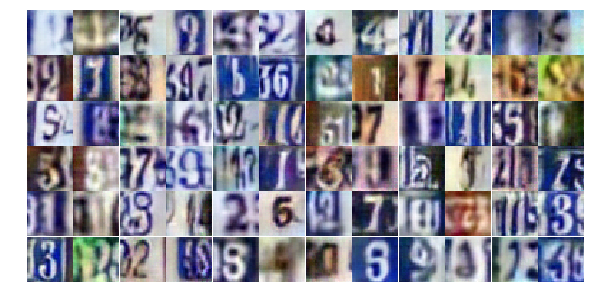

Epoch 24/25... Discriminator Loss: 1.1431... Generator Loss: 0.5658
Epoch 24/25... Discriminator Loss: 0.6903... Generator Loss: 1.0824
Epoch 24/25... Discriminator Loss: 0.4915... Generator Loss: 1.6195
Epoch 24/25... Discriminator Loss: 1.7337... Generator Loss: 0.2673
Epoch 24/25... Discriminator Loss: 0.7642... Generator Loss: 0.8488
Epoch 24/25... Discriminator Loss: 0.4575... Generator Loss: 1.3910
Epoch 24/25... Discriminator Loss: 0.4889... Generator Loss: 1.3510
Epoch 24/25... Discriminator Loss: 0.8024... Generator Loss: 0.8894
Epoch 24/25... Discriminator Loss: 1.1366... Generator Loss: 0.6050
Epoch 24/25... Discriminator Loss: 0.9113... Generator Loss: 0.7942


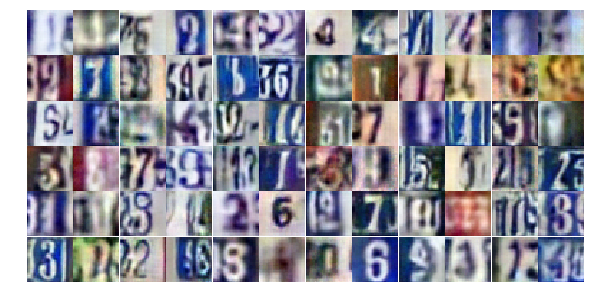

Epoch 24/25... Discriminator Loss: 0.6113... Generator Loss: 1.2649
Epoch 24/25... Discriminator Loss: 0.6347... Generator Loss: 1.1329
Epoch 24/25... Discriminator Loss: 0.6067... Generator Loss: 2.1106
Epoch 24/25... Discriminator Loss: 1.4982... Generator Loss: 0.4300
Epoch 24/25... Discriminator Loss: 0.7662... Generator Loss: 1.0256
Epoch 24/25... Discriminator Loss: 1.1438... Generator Loss: 0.5988
Epoch 24/25... Discriminator Loss: 1.0907... Generator Loss: 0.6094
Epoch 24/25... Discriminator Loss: 1.3572... Generator Loss: 0.4221
Epoch 24/25... Discriminator Loss: 0.8865... Generator Loss: 0.8182
Epoch 24/25... Discriminator Loss: 0.9030... Generator Loss: 2.8648


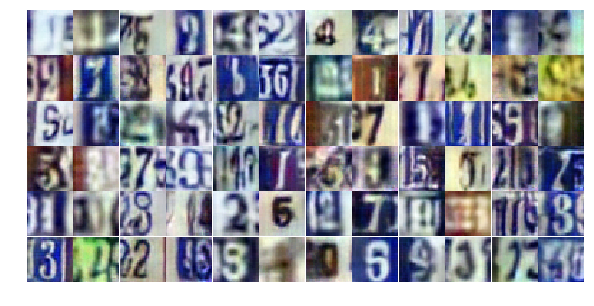

Epoch 24/25... Discriminator Loss: 0.5902... Generator Loss: 1.2159
Epoch 24/25... Discriminator Loss: 0.7463... Generator Loss: 1.7208
Epoch 24/25... Discriminator Loss: 1.4860... Generator Loss: 0.5086
Epoch 24/25... Discriminator Loss: 1.0659... Generator Loss: 1.7058
Epoch 24/25... Discriminator Loss: 1.4237... Generator Loss: 0.4346
Epoch 24/25... Discriminator Loss: 0.8377... Generator Loss: 0.9294
Epoch 24/25... Discriminator Loss: 1.1882... Generator Loss: 0.5369
Epoch 24/25... Discriminator Loss: 0.7782... Generator Loss: 0.9835
Epoch 24/25... Discriminator Loss: 0.8095... Generator Loss: 1.1710
Epoch 24/25... Discriminator Loss: 1.2553... Generator Loss: 0.4926


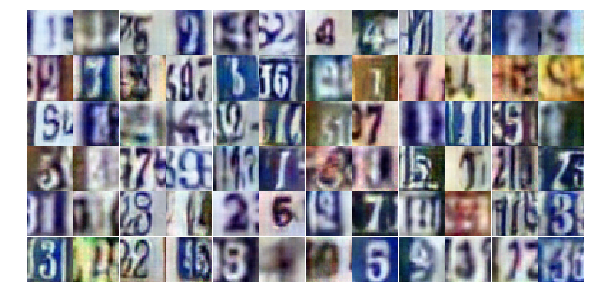

Epoch 24/25... Discriminator Loss: 1.1050... Generator Loss: 0.5966
Epoch 24/25... Discriminator Loss: 1.2688... Generator Loss: 0.4614
Epoch 24/25... Discriminator Loss: 0.9794... Generator Loss: 0.7217
Epoch 24/25... Discriminator Loss: 0.7194... Generator Loss: 1.1718
Epoch 24/25... Discriminator Loss: 1.2128... Generator Loss: 0.5082
Epoch 25/25... Discriminator Loss: 0.7770... Generator Loss: 0.9008
Epoch 25/25... Discriminator Loss: 0.5195... Generator Loss: 1.3702
Epoch 25/25... Discriminator Loss: 0.9941... Generator Loss: 0.6388
Epoch 25/25... Discriminator Loss: 1.3150... Generator Loss: 0.4858
Epoch 25/25... Discriminator Loss: 0.9309... Generator Loss: 0.7090


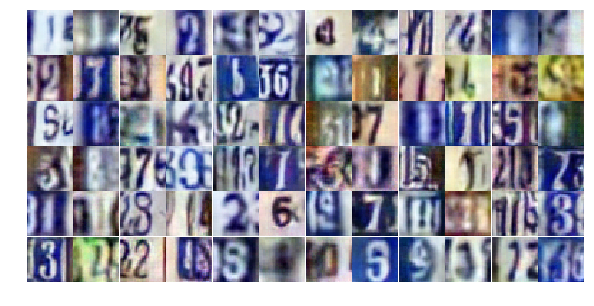

Epoch 25/25... Discriminator Loss: 1.0200... Generator Loss: 0.6378
Epoch 25/25... Discriminator Loss: 1.0003... Generator Loss: 0.7607
Epoch 25/25... Discriminator Loss: 0.5717... Generator Loss: 1.1231
Epoch 25/25... Discriminator Loss: 0.8748... Generator Loss: 0.8059
Epoch 25/25... Discriminator Loss: 0.8169... Generator Loss: 1.0796
Epoch 25/25... Discriminator Loss: 0.7660... Generator Loss: 0.8412
Epoch 25/25... Discriminator Loss: 0.9740... Generator Loss: 0.7246
Epoch 25/25... Discriminator Loss: 0.8634... Generator Loss: 0.8912
Epoch 25/25... Discriminator Loss: 0.4752... Generator Loss: 1.4249
Epoch 25/25... Discriminator Loss: 1.2198... Generator Loss: 0.4881


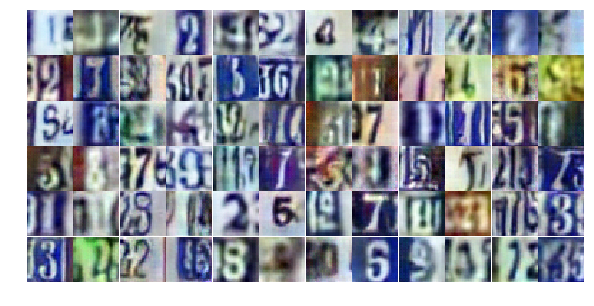

Epoch 25/25... Discriminator Loss: 0.9940... Generator Loss: 2.8206
Epoch 25/25... Discriminator Loss: 0.4579... Generator Loss: 2.2524
Epoch 25/25... Discriminator Loss: 1.2755... Generator Loss: 0.5485
Epoch 25/25... Discriminator Loss: 0.9521... Generator Loss: 1.0256
Epoch 25/25... Discriminator Loss: 0.6691... Generator Loss: 1.2797
Epoch 25/25... Discriminator Loss: 0.6694... Generator Loss: 1.0399
Epoch 25/25... Discriminator Loss: 0.8776... Generator Loss: 0.8304
Epoch 25/25... Discriminator Loss: 1.0340... Generator Loss: 0.8004
Epoch 25/25... Discriminator Loss: 0.5369... Generator Loss: 1.2870
Epoch 25/25... Discriminator Loss: 0.6870... Generator Loss: 1.0230


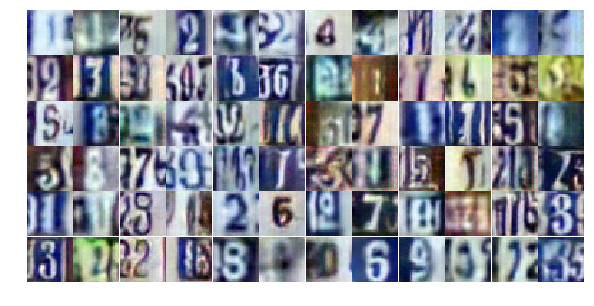

Epoch 25/25... Discriminator Loss: 0.9912... Generator Loss: 0.6988
Epoch 25/25... Discriminator Loss: 0.8173... Generator Loss: 0.7791
Epoch 25/25... Discriminator Loss: 1.3995... Generator Loss: 0.4566
Epoch 25/25... Discriminator Loss: 0.6246... Generator Loss: 1.1699
Epoch 25/25... Discriminator Loss: 0.6435... Generator Loss: 1.2170
Epoch 25/25... Discriminator Loss: 0.4156... Generator Loss: 1.5184
Epoch 25/25... Discriminator Loss: 0.9221... Generator Loss: 0.8584
Epoch 25/25... Discriminator Loss: 0.6993... Generator Loss: 1.0267
Epoch 25/25... Discriminator Loss: 0.7775... Generator Loss: 1.1725
Epoch 25/25... Discriminator Loss: 0.5626... Generator Loss: 1.3880


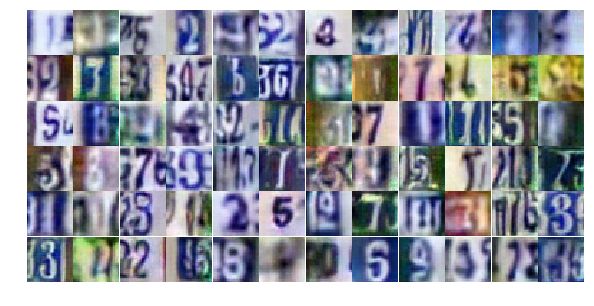

Epoch 25/25... Discriminator Loss: 0.9520... Generator Loss: 0.6834
Epoch 25/25... Discriminator Loss: 0.7704... Generator Loss: 0.8745
Epoch 25/25... Discriminator Loss: 0.6320... Generator Loss: 1.4973
Epoch 25/25... Discriminator Loss: 0.6713... Generator Loss: 1.0487
Epoch 25/25... Discriminator Loss: 1.3698... Generator Loss: 0.4600
Epoch 25/25... Discriminator Loss: 1.1366... Generator Loss: 0.5966
Epoch 25/25... Discriminator Loss: 0.4116... Generator Loss: 1.8594
Epoch 25/25... Discriminator Loss: 0.8874... Generator Loss: 0.7839
Epoch 25/25... Discriminator Loss: 1.4004... Generator Loss: 0.5141
Epoch 25/25... Discriminator Loss: 0.4687... Generator Loss: 1.7632


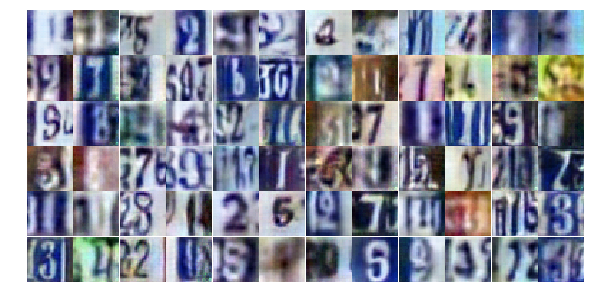

Epoch 25/25... Discriminator Loss: 0.7730... Generator Loss: 1.6106
Epoch 25/25... Discriminator Loss: 0.7493... Generator Loss: 0.9228
Epoch 25/25... Discriminator Loss: 1.1403... Generator Loss: 0.6042
Epoch 25/25... Discriminator Loss: 0.7638... Generator Loss: 0.8451
Epoch 25/25... Discriminator Loss: 1.0078... Generator Loss: 0.6637
Epoch 25/25... Discriminator Loss: 0.5167... Generator Loss: 1.2590
Epoch 25/25... Discriminator Loss: 0.7791... Generator Loss: 1.1197
Epoch 25/25... Discriminator Loss: 0.7021... Generator Loss: 1.0419
Epoch 25/25... Discriminator Loss: 0.6224... Generator Loss: 1.2368
Epoch 25/25... Discriminator Loss: 0.6722... Generator Loss: 0.9850


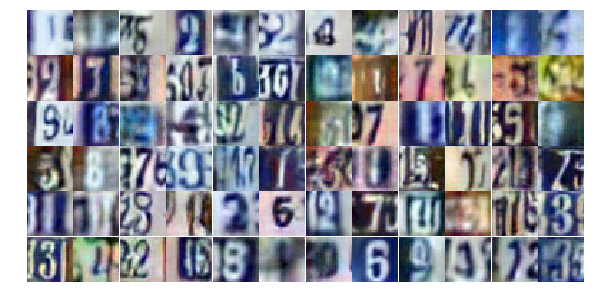

Epoch 25/25... Discriminator Loss: 0.7883... Generator Loss: 1.0181
Epoch 25/25... Discriminator Loss: 1.9043... Generator Loss: 0.2509


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

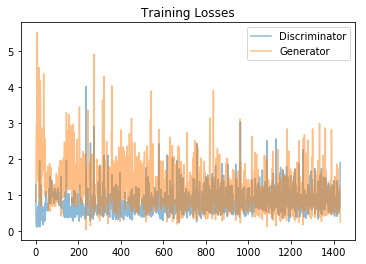

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

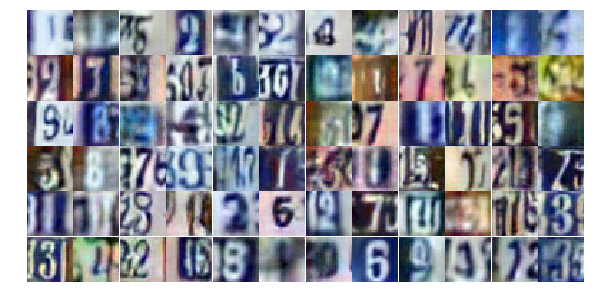

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))